<center>
    <h1><font color='purple'><b>Detección de estrés mediante análisis de señales de audio y lenguaje hablado</b></font></h1>
</center>


**Elaborado por:** Scarlett Magdaleno Gatica. 

![Alt Text](https://cdn.memiah.co.uk/uploads/hypnotherapy-directory.org.uk/image_gallery/public-speaking-1684491727-hero.jpg)


El estudio actual se enfoca en la detección del estrés mediante el análisis de señales de audio de la voz humana, utilizando una muestra de 7 participantes matriculados en el curso de Ciencia de Datos para Sensores Inteligentes 2024. Se diseñó un experimento inspirado en el Trier Social Stress Test (TSST), donde los participantes presentaron sus anteproyectos frente a un panel de profesores que los cuestionaron para inducir mayor estrés. Se recopilaron datos de audio en diferentes momentos, cubriendo tanto el escenario estresante como el estado basal de los participantes.

Se emplearon cuatro algoritmos de inferencia en un proceso de validación cruzada para construir un clasificador de estrés. Se identificó una característica relevante en los clasificadores, la cual mostró un comportamiento similar a los niveles de estrés reportados por los participantes.

Adicionalmente, se realizó un análisis de discurso de las transcripciones de los audios para examinar el lenguaje utilizado por los participantes tanto en situaciones de estrés como en su estado basal. Los resultados indicaron la capacidad de detectar el estrés a través de señales de audio, logrando un puntaje F1 de 0.88 en el clasificador binario y equilibrado. Este estudio destaca la viabilidad de utilizar señales de audio para la detección objetiva del estrés, lo que podría tener implicaciones importantes en el bienestar físico y mental de las personas.

### <font color='purple'> **Importamos las librerías** </font>

In [74]:
# system libraries
import os
import sys
import re
import datetime
import shutil

# data 
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import math
import scipy

# audio
import IPython.display as ipd
from IPython.display import Audio
import librosa
import librosa.display
import soundfile as sf
from pydub import AudioSegment
from pydub.silence import split_on_silence, detect_silence
import joblib
import pyaudio
import wave

# files
from scipy.io.wavfile import write
import shutil

# feature selection
from sklearn.feature_selection import mutual_info_classif

# data partitioning
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.model_selection import train_test_split

# model construction
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.utils.validation import check_array
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_predict
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.svm import SVC

# Bag of Words
import spacy
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from sklearn.feature_extraction.text import CountVectorizer
from bs4 import BeautifulSoup
from unidecode import unidecode
import random
from wordcloud import WordCloud

import warnings
if not sys.warnoptions:
    warnings.simplefilter("ignore")
warnings.filterwarnings("ignore", category=DeprecationWarning)

## <font color='purple'> **1.- Manipulation Check Analysis (With self report)** </font>

En esta sección se presenta el Análisis de Verificación de Manipulación (Manipulation Check Analysis) del experimento realizado en R, con el objetivo de confirmar la validez del experimento al determinar si la intervención realmente provocó un aumento en el nivel de estrés de los participantes.

In [2]:
StressLevel = pd.read_csv('NivelEstres.csv')
display(StressLevel.head())

,Participante,ANTES,DURANTE,DESPUES,BASAL
0,SCARLETT,4,5,2,1
1,ARIANA,3,4,3,1
2,DAFNE,2,4,4,1
3,ANDRES,4,4,4,2
4,RACHEL,3,4,2,1


**CÓDIGO EN R**

```{r}
# Crear el dataframe
data <- data.frame(
  Participante = c("SCARLETT", "ARIANA", "DAFNE", "ANDRES", "RACHEL", "JUAN", "JESUS"),
  ANTES = c(4, 3, 2, 4, 3, 5, 4),
  DURANTE = c(5, 4, 4, 4, 4, 5, 4),
  DESPUES = c(2, 3, 4, 4, 2, 5, 2),
  BASAL = c(1, 1, 1, 2, 1, 2, 1)
)

# Realizar pruebas de normalidad
shapiro_test_antes <- shapiro.test(data$ANTES)
shapiro_test_durante <- shapiro.test(data$DURANTE)
shapiro_test_despues <- shapiro.test(data$DESPUES)
shapiro_test_basal <- shapiro.test(data$BASAL)

# Mostrar los resultados de las pruebas de normalidad
print(shapiro_test_antes)
print(shapiro_test_durante)
print(shapiro_test_despues)
print(shapiro_test_basal)

```

	Shapiro-Wilk normality test

data:  data$ANTES
W = 0.93662, p-value = 0.6085


	Shapiro-Wilk normality test

data:  data$DURANTE
W = 0.6004, p-value = 0.0002752


	Shapiro-Wilk normality test

data:  data$DESPUES
W = 0.85857, p-value = 0.147


	Shapiro-Wilk normality test

data:  data$BASAL
W = 0.6004, p-value = 0.0002752


```{r}
# Realizar las pruebas de Wilcoxon para cada combinación
wilcox_resultantes_durante <- wilcox.test(data$ANTES, data$DURANTE, paired = TRUE)
wilcox_resultantes_despues <- wilcox.test(data$ANTES, data$DESPUES, paired = TRUE)
wilcox_resultantes_basal <- wilcox.test(data$ANTES, data$BASAL, paired = TRUE)
wilcox_durante_despues <- wilcox.test(data$DURANTE, data$DESPUES, paired = TRUE)
wilcox_durante_basal <- wilcox.test(data$DURANTE, data$BASAL, paired = TRUE)
wilcox_despues_basal <- wilcox.test(data$DESPUES, data$BASAL, paired = TRUE)

# Imprimir los resultados
print("Comparación ANTES vs DURANTE:")
print(wilcox_resultantes_durante)

print("Comparación ANTES vs DESPUES:")
print(wilcox_resultantes_despues)

print("Comparación ANTES vs BASAL:")
print(wilcox_resultantes_basal)

print("Comparación DURANTE vs DESPUES:")
print(wilcox_durante_despues)

print("Comparación DURANTE vs BASAL:")
print(wilcox_durante_basal)

print("Comparación DESPUES vs BASAL:")
print(wilcox_despues_basal)
```

[1] "Comparación ANTES vs DURANTE:"

	Wilcoxon signed rank test with continuity correction

data:  data ANTES and data DURANTE
V = 0, p-value = 0.08897
alternative hypothesis: true location shift is not equal to 0

[1] "Comparación ANTES vs DESPUES:"

	Wilcoxon signed rank test with continuity correction

data:  data ANTES and data DESPUES
V = 7, p-value = 0.5708
alternative hypothesis: true location shift is not equal to 0

[1] "Comparación ANTES vs BASAL:"

	Wilcoxon signed rank test with continuity correction

data:  data ANTES and data BASAL
V = 28, p-value = 0.0206
alternative hypothesis: true location shift is not equal to 0

[1] "Comparación DURANTE vs DESPUES:"

	Wilcoxon signed rank test with continuity correction

data:  data DURANTE and data DESPUES
V = 10, p-value = 0.09751
alternative hypothesis: true location shift is not equal to 0

[1] "Comparación DURANTE vs BASAL:"

	Wilcoxon signed rank test with continuity correction

data:  data DURANTE and data BASAL
V = 28, p-value = 0.01788
alternative hypothesis: true location shift is not equal to 0

[1] "Comparación DESPUES vs BASAL:"

	Wilcoxon signed rank test with continuity correction

data:  data DESPUES and data BASAL
V = 28, p-value = 0.02107
alternative hypothesis: true location shift is not equal to 0

```{r}
# Cargar la librería ggplot2 para hacer gráficos
library(ggplot2)

# Convertir el dataframe a formato largo (long format) para facilitar la visualización en el boxplot
data_long <- tidyr::pivot_longer(data, cols = c(ANTES, DURANTE, DESPUES, BASAL), names_to = "Tiempo", values_to = "Mediciones")

# Especificar el orden deseado de los niveles del factor Tiempo
data_long$Tiempo <- factor(data_long$Tiempo, levels = c("ANTES", "DURANTE", "DESPUES", "BASAL"))

# Crear el boxplot
boxplot <- ggplot(data_long, aes(x = Tiempo, y = Mediciones, fill = Tiempo)) +
  geom_boxplot() +
  labs(x = "Tiempo", y = "Mediciones", title = "Distribución de las mediciones en diferentes tiempos") +
  theme_minimal()

# Mostrar el boxplot
print(boxplot)

# Guardar la imagen del boxplot en un archivo .png
ggsave("boxplot.png", plot = boxplot, width = 8, height = 6, units = "in", dpi = 300, bg = "white")


```

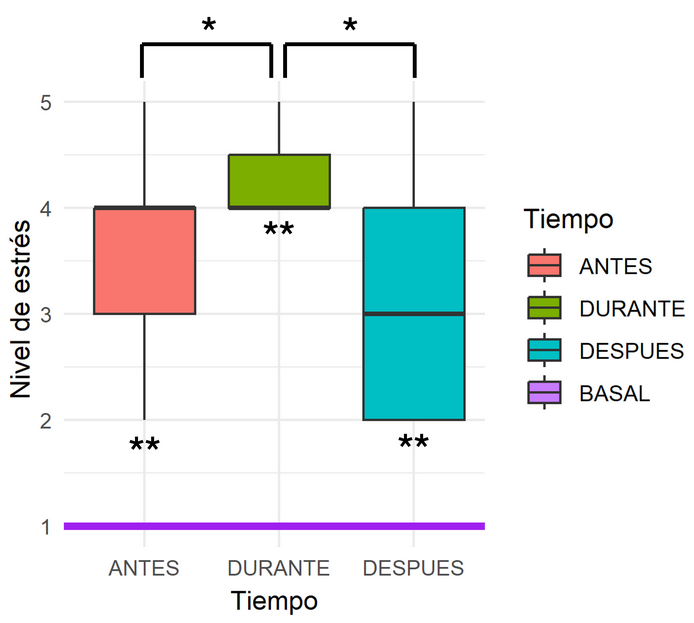

## <font color='purple'> **2.- Segmentación de Señales** </font>

Para llevar a cabo la segmentación de las señales en esta sección, previamente se realizó una inspección de los audios y se determinaron los momentos en los que ocurrían las siguientes situaciones:

- Sentimiento: Descripción de cómo se sentía el participante en ese momento.
- FrasePositiva: Lectura en voz alta de una frase con connotación positiva sobre cómo le irá/fue en su exposición.
- FraseNegativa: Lectura en voz alta de una frase con connotación negativa sobre cómo le irá/fue en su exposición.
- Exponiendo: Segmentos en los que el participante exponía su anteproyecto mediante un discurso preparado previamente.
- Respondiendo: Segmentos en los que el participante respondía preguntas sobre su anteproyecto formuladas por los docentes.

La segmentación se llevará a cabo para crear tres clasificadores distintos:

- Clasificador Binario
- Clasificador Multiclase
- Clasificador Multiclase Balanceado

In [4]:
etiquetado = pd.read_csv('segmentacion.csv')
display(etiquetado.head())

,filename,inicio,fin,label
0,ANTES_ANDRES.wav,00:05,00:34,Sentimiento
1,ANTES_ANDRES.wav,00:39,00:45,FrasePositiva
2,ANTES_ANDRES.wav,00:45,00:50,FraseNegativa
3,ANTES_ARIANA.wav,00:07,00:16,Sentimiento
4,ANTES_ARIANA.wav,00:21,00:26,FrasePositiva


In [5]:
def tiempo_a_segundos(tiempo_str):
    tiempo = datetime.datetime.strptime(tiempo_str, '%M:%S')
    return tiempo.minute * 60 + tiempo.second

def cargar_etiquetas_desde_csv(archivo_etiquetado):
    etiquetado = pd.read_csv(archivo_etiquetado)
    return etiquetado

def segmentar_audio(archivo_audio, inicio, fin, destino, sr):
    y, _ = librosa.load(archivo_audio, sr=sr)
    inicio_frame = int(inicio * sr)
    fin_frame = int(fin * sr)
    segmento = y[inicio_frame:fin_frame]
    
    sf.write(destino, segmento, sr)

def cargar_datos_desde_carpeta(carpeta_audios, carpeta_destino, archivo_etiquetado, sr=44100):
    etiquetado = cargar_etiquetas_desde_csv(archivo_etiquetado)
    segmentos = []
    
    for index, row in etiquetado.iterrows():
        archivo_audio = os.path.join(carpeta_audios, row['filename'])
        etiqueta = row['label']
        inicio = tiempo_a_segundos(row['inicio'])
        fin = tiempo_a_segundos(row['fin'])
        
        # Generar nuevo nombre de archivo con tiempos de inicio, fin y etiqueta
        nombre_base, extension = os.path.splitext(os.path.basename(row['filename']))
        nuevo_nombre = f"{nombre_base}_{inicio}_{fin}_{etiqueta}{extension}"
        destino = os.path.join(carpeta_destino, nuevo_nombre)
        
        segmentar_audio(archivo_audio, inicio, fin, destino, sr)
        
        # Obtener "Tiempo" y "Participante" del nombre del archivo
        tiempo, participante = nombre_base.split('_')
        
        # Agregar información del segmento a la lista de segmentos
        segmentos.append({
            'filename': nuevo_nombre,
            'inicio': inicio,
            'fin': fin,
            'contenido': etiqueta,
            'Tiempo': tiempo,
            'Participante': participante
        })
    
    return pd.DataFrame(segmentos)

carpeta_audios = 'DatasetExposicion'
carpeta_destino = 'AudiosSegmentados'
archivo_etiquetado = 'segmentacion.csv'

if not os.path.exists(carpeta_destino):
    os.makedirs(carpeta_destino)

df_segmentos = cargar_datos_desde_carpeta(carpeta_audios, carpeta_destino, archivo_etiquetado)
print("Nuevo DataFrame de segmentos:")
display(df_segmentos)

Nuevo DataFrame de segmentos:


,filename,inicio,fin,contenido,Tiempo,Participante
0,ANTES_ANDRES_5_34_Sentimiento.wav,5,34,Sentimiento,ANTES,ANDRES
1,ANTES_ANDRES_39_45_FrasePositiva.wav,39,45,FrasePositiva,ANTES,ANDRES
2,ANTES_ANDRES_45_50_FraseNegativa.wav,45,50,FraseNegativa,ANTES,ANDRES
3,ANTES_ARIANA_7_16_Sentimiento.wav,7,16,Sentimiento,ANTES,ARIANA
4,ANTES_ARIANA_21_26_FrasePositiva.wav,21,26,FrasePositiva,ANTES,ARIANA
...,...,...,...,...,...,...
187,BASAL_RACHEL_20_28_CosasPositivas.wav,20,28,CosasPositivas,BASAL,RACHEL
188,BASAL_RACHEL_32_38_FraseNeutra.wav,32,38,FraseNeutra,BASAL,RACHEL
189,BASAL_SCARLETT_5_14_Sentimiento.wav,5,14,Sentimiento,BASAL,SCARLETT
190,BASAL_SCARLETT_18_31_CosasPositivas.wav,18,31,CosasPositivas,BASAL,SCARLETT


In [6]:
# Convertir el DataFrame de formato ancho a largo
StressLevel_long = StressLevel.melt(id_vars=['Participante'], var_name='Tiempo', value_name='label')

# Combinar los DataFrames usando las columnas 'Participante' y 'Tiempo'
df_segmentos = pd.merge(df_segmentos, StressLevel_long, on=['Participante', 'Tiempo'], how='left')

# Renombrar 'label' con 'StressLevel'
df_segmentos = df_segmentos.rename(columns={'label': 'StressLevel'})

# Mostrar el nuevo DataFrame
display(df_segmentos.head())

,filename,inicio,fin,contenido,Tiempo,Participante,StressLevel
0,ANTES_ANDRES_5_34_Sentimiento.wav,5,34,Sentimiento,ANTES,ANDRES,4
1,ANTES_ANDRES_39_45_FrasePositiva.wav,39,45,FrasePositiva,ANTES,ANDRES,4
2,ANTES_ANDRES_45_50_FraseNegativa.wav,45,50,FraseNegativa,ANTES,ANDRES,4
3,ANTES_ARIANA_7_16_Sentimiento.wav,7,16,Sentimiento,ANTES,ARIANA,3
4,ANTES_ARIANA_21_26_FrasePositiva.wav,21,26,FrasePositiva,ANTES,ARIANA,3


In [7]:
# Agrupar por "Tiempo" y calcular la suma de la diferencia entre "fin" e "inicio" para cada grupo
tiempo_total = df_segmentos.groupby('Tiempo')['fin', 'inicio'].apply(lambda x: (x['fin'] - x['inicio']).sum())

print("Tiempo total de los audios en cada 'Tiempo':\n")
display(tiempo_total)

Tiempo total de los audios en cada 'Tiempo':



Tiempo
ANTES       151
BASAL       175
DESPUES     165
DURANTE    2782
dtype: int64

### <font color='purple'> **2.1 Segmentación para clasificador binario** </font>

Seleccionemos los segmentos de audio con mayor estrés de acuerdo a los datos de HRV medidos durante la exposición.  El criterio es seleccionar aquellos segmentos que presenten los niveles más bajos de valores de HRV de cada participante. 

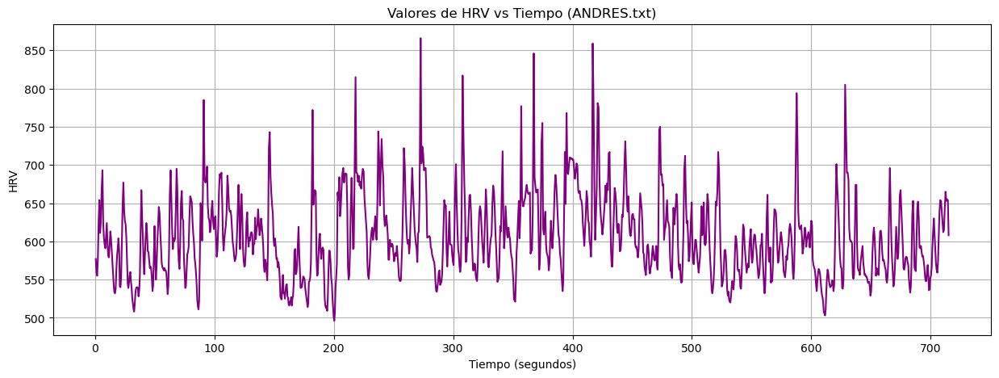

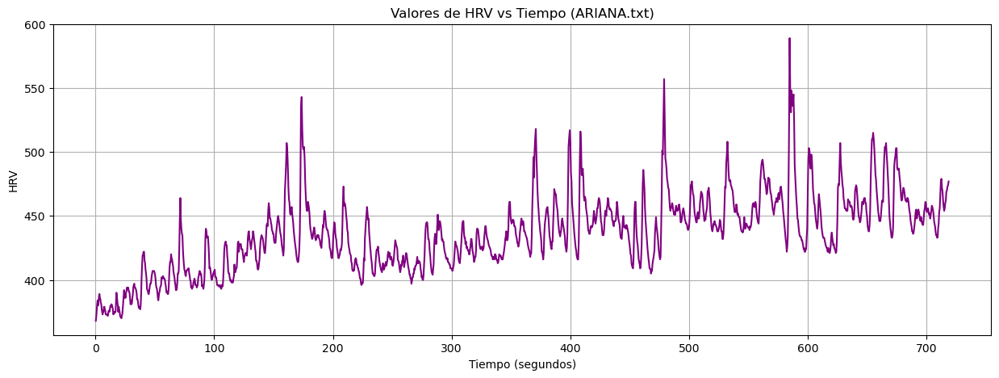

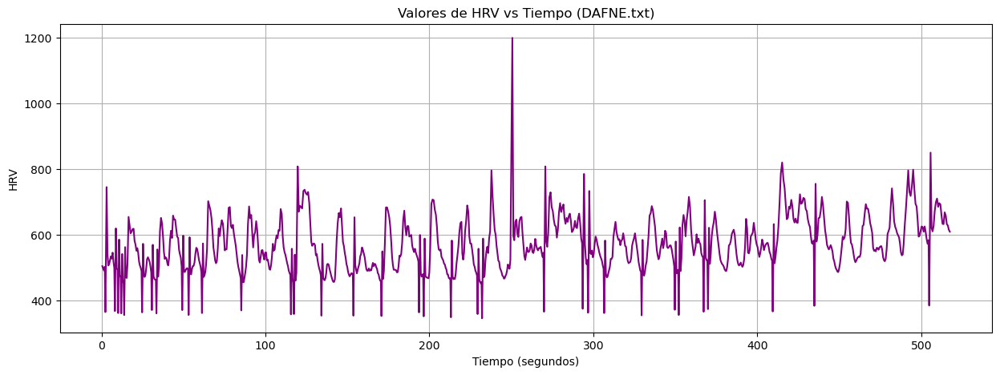

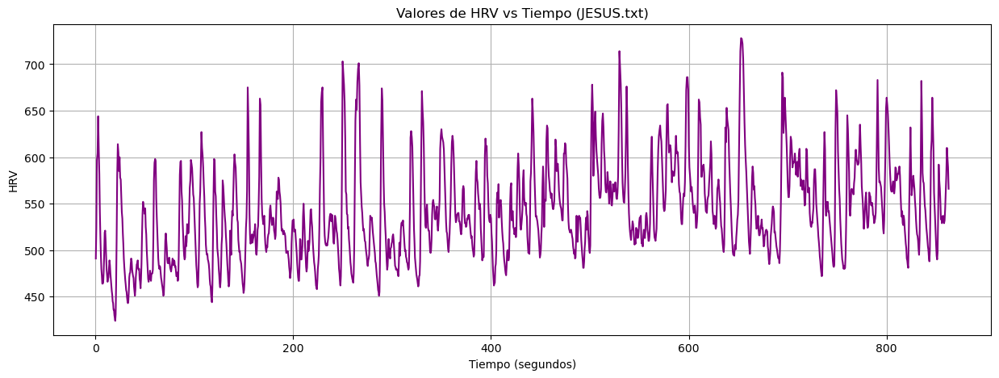

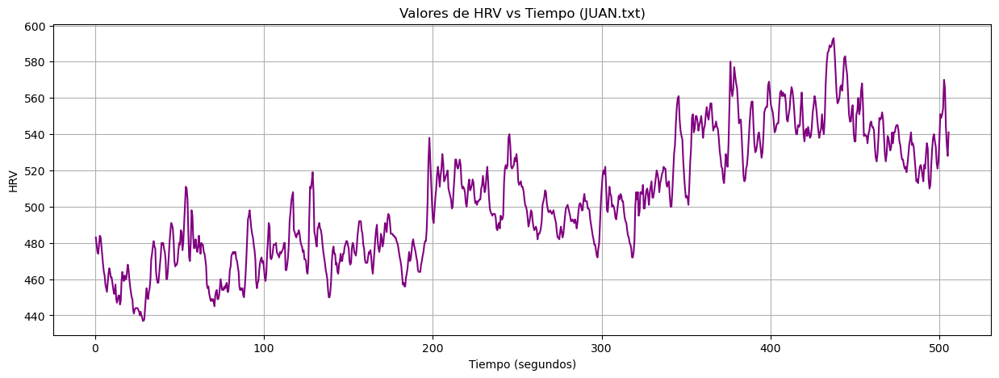

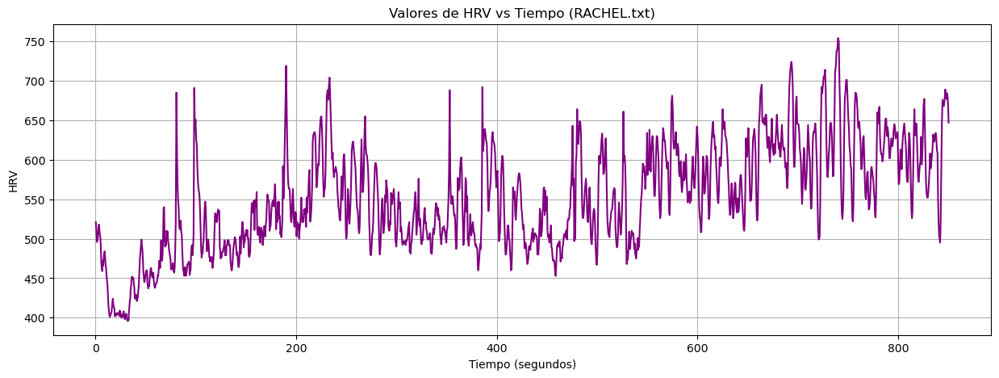

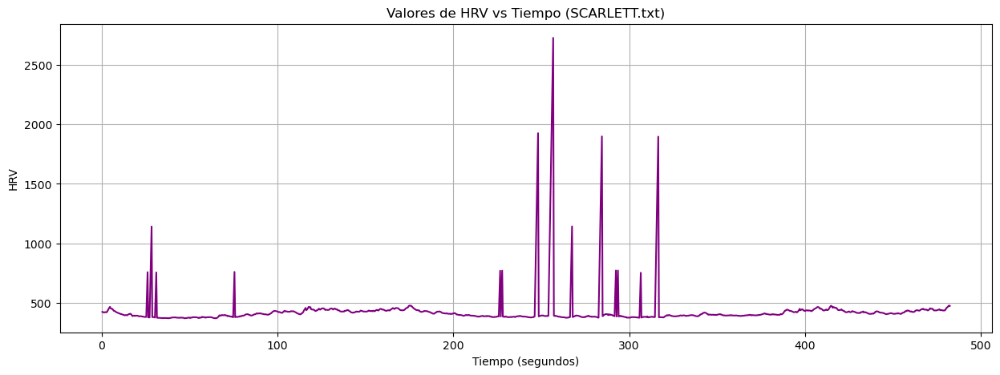

In [8]:
def cargar_datos_desde_archivo(archivo):
    with open(archivo, 'r') as f:
        datos = [float(linea.strip()) for linea in f]
    return datos

def tiempo_a_segundos(tiempo_str):
    tiempo = datetime.datetime.strptime(tiempo_str, '%M:%S')
    return tiempo.minute * 60 + tiempo.second

def calcular_tiempos_acumulados(datos_hrv):
    tiempos_acumulados = [0]
    for valor_hrv in datos_hrv:
        tiempo_segundos = valor_hrv / 1000  # Convertir milisegundos a segundos
        tiempo_acumulado = tiempos_acumulados[-1] + tiempo_segundos
        tiempos_acumulados.append(tiempo_acumulado)
    return tiempos_acumulados[1:]  # Eliminar el primer elemento que es cero

def visualizar_hrv_vs_tiempo(archivo):
    nombre_archivo = os.path.basename(archivo)
    datos_hrv = cargar_datos_desde_archivo(archivo)
    tiempos_acumulados = calcular_tiempos_acumulados(datos_hrv)
    
    plt.figure(figsize=(15, 5))
    plt.plot(tiempos_acumulados, datos_hrv, color='purple', linestyle='-')
    #plt.fill_between(tiempos_acumulados, 0, 600, color='purple', alpha=0.3, label='Estrés (BAJO)')
    plt.title(f'Valores de HRV vs Tiempo ({nombre_archivo})')
    plt.xlabel('Tiempo (segundos)')
    plt.ylabel('HRV')
    plt.grid(True)
    plt.show()

carpeta_hrv = 'HRV'
archivos_txt = [archivo for archivo in os.listdir(carpeta_hrv) if archivo.lower().endswith('.txt')]

for archivo in archivos_txt:
    visualizar_hrv_vs_tiempo(os.path.join(carpeta_hrv, archivo))

En base a las gráficas anteriores se realizó la selección de segmentos de audio correspondientes a cada participante y se guardó dicha selección en el archivo `df_estresado.csv`.

In [10]:
df_estresado = pd.read_csv('df_estresado.csv')

# Seleccionar las filas del DataFrame df_segmentos cuya columna "filename" corresponda con los archivos .wav seleccionados
df_estres = df_segmentos[df_segmentos['filename'].isin(df_estresado['filename'])]

# Mostrar el DataFrame resultante
display(df_estres.head())

,filename,inicio,fin,contenido,Tiempo,Participante,StressLevel
56,DURANTE_ANDRES_488_556_Respondiendo.wav,488,556,Respondiendo,DURANTE,ANDRES,4
58,DURANTE_ANDRES_602_634_Respondiendo.wav,602,634,Respondiendo,DURANTE,ANDRES,4
60,DURANTE_ARIANA_3_110_Exponiendo.wav,3,110,Exponiendo,DURANTE,ARIANA,4
64,DURANTE_ARIANA_160_167_Respondiendo.wav,160,167,Respondiendo,DURANTE,ARIANA,4
68,DURANTE_ARIANA_246_280_Exponiendo.wav,246,280,Exponiendo,DURANTE,ARIANA,4


In [11]:
# Filtrar las instancias de df_segmentos que corresponden al tiempo "BASAL"
df_stress_filtered_basal = df_segmentos[df_segmentos['Tiempo'] == 'BASAL']

# Filtrar las instancias de df_estres
df_stress_filtered = df_stress_filtered_basal.append(df_estres.reset_index(drop=True), ignore_index=True)

# Mostrar el DataFrame df_stress_filtered
display(df_stress_filtered.head())

,filename,inicio,fin,contenido,Tiempo,Participante,StressLevel
0,BASAL_ANDRES_4_15_Sentimiento.wav,4,15,Sentimiento,BASAL,ANDRES,2
1,BASAL_ANDRES_20_36_CosasPositivas.wav,20,36,CosasPositivas,BASAL,ANDRES,2
2,BASAL_ANDRES_39_45_FraseNeutra.wav,39,45,FraseNeutra,BASAL,ANDRES,2
3,BASAL_ARIANA_4_9_Sentimiento.wav,4,9,Sentimiento,BASAL,ARIANA,1
4,BASAL_ARIANA_13_19_CosasPositivas.wav,13,19,CosasPositivas,BASAL,ARIANA,1


In [12]:
# Carpeta de salida para los segmentos de audio
output_folder = "segmented_audio_binary_clf"
os.makedirs(output_folder, exist_ok=True)

# Función para segmentar un audio y guardar los segmentos en una carpeta
def segment_audio(audio_path, output_folder):
    # Cargar el audio
    audio, sr = librosa.load(audio_path, sr=None)
    # Normalizar el audio
    audio_normalized = librosa.util.normalize(audio)
    # Duración del audio en segundos
    duration = librosa.get_duration(y=audio, sr=sr)
    # Tiempo de inicio para segmentar el audio
    start_time = 0
    # Duración de cada segmento en segundos
    segment_duration = 5
    # Contador para los segmentos
    segment_count = 0
    # Lista para almacenar los nombres de archivo de los segmentos
    segment_filenames = []
    
    while start_time + segment_duration <= duration:
        # Segmentar el audio
        segment = audio_normalized[int(start_time * sr):int((start_time + segment_duration) * sr)]
        # Nombre del archivo para el segmento
        segment_filename = f"{os.path.splitext(os.path.basename(audio_path))[0]}_{segment_count}.wav"
        # Guardar el segmento en la carpeta de salida
        segment_path = os.path.join(output_folder, segment_filename)
        sf.write(segment_path, segment, sr)
        # Actualizar el tiempo de inicio para el próximo segmento
        start_time += segment_duration
        # Incrementar el contador de segmentos
        segment_count += 1
        # Agregar el nombre del archivo del segmento a la lista
        segment_filenames.append(segment_filename)
    
    return segment_filenames

# Ruta de la carpeta que contiene los archivos de audio
audio_folder = "AudiosSegmentados"

# Lista para almacenar los nombres de archivo de los segmentos
all_segment_filenames = []

# Crear una lista para almacenar los datos de los segmentos
segment_data_list = []

# Iterar sobre cada fila del DataFrame df_stress_filtered
for index, row in df_stress_filtered.iterrows():
    # Segmentar el audio y obtener los nombres de archivo de los segmentos creados
    segment_filenames = segment_audio(os.path.join(audio_folder, row['filename']), output_folder)
    # Extender la lista de nombres de archivo de segmentos
    all_segment_filenames.extend(segment_filenames)
    
    # Iterar sobre cada nombre de archivo de segmento y crear una instancia por cada uno
    for segment_filename in segment_filenames:
        # Crear un diccionario para almacenar los datos del segmento
        segment_data = {
            'filename': segment_filename,
            'inicio': row['inicio'],
            'fin': row['fin'],
            'contenido': row['contenido'],
            'Tiempo': row['Tiempo'],
            'Participante': row['Participante'],
            'StressLevel': row['StressLevel']
        }
        # Agregar el diccionario a la lista de datos de segmentos
        segment_data_list.append(segment_data)

# Crear un nuevo DataFrame con los datos de los segmentos
df_segment_filenames = pd.DataFrame(segment_data_list)

# Eliminar las columnas 'inicio' y 'fin' del DataFrame df_stress_clf
df_segment_filenames = df_segment_filenames.drop(columns=['inicio', 'fin'])

# Mostrar el DataFrame con los nombres de archivo de los segmentos
display(df_segment_filenames.head())

,filename,contenido,Tiempo,Participante,StressLevel
0,BASAL_ANDRES_4_15_Sentimiento_0.wav,Sentimiento,BASAL,ANDRES,2
1,BASAL_ANDRES_4_15_Sentimiento_1.wav,Sentimiento,BASAL,ANDRES,2
2,BASAL_ANDRES_20_36_CosasPositivas_0.wav,CosasPositivas,BASAL,ANDRES,2
3,BASAL_ANDRES_20_36_CosasPositivas_1.wav,CosasPositivas,BASAL,ANDRES,2
4,BASAL_ANDRES_20_36_CosasPositivas_2.wav,CosasPositivas,BASAL,ANDRES,2


In [13]:
# Asignar a df_stress_clf los valores de df_segment_filenames
df_with_labels = df_segment_filenames.copy()

# Añadir una nueva columna 'label' con los valores correspondientes
df_with_labels['label'] = 0  # Inicializar todos los valores como 0

# Asignar 1 a los valores de 'label' donde 'Tiempo' es distinto de 'BASAL'
df_with_labels.loc[df_with_labels['Tiempo'] != 'BASAL', 'label'] = 1

# Mostrar el DataFrame df_stress_clf actualizado
display(df_with_labels.head())

,filename,contenido,Tiempo,Participante,StressLevel,label
0,BASAL_ANDRES_4_15_Sentimiento_0.wav,Sentimiento,BASAL,ANDRES,2,0
1,BASAL_ANDRES_4_15_Sentimiento_1.wav,Sentimiento,BASAL,ANDRES,2,0
2,BASAL_ANDRES_20_36_CosasPositivas_0.wav,CosasPositivas,BASAL,ANDRES,2,0
3,BASAL_ANDRES_20_36_CosasPositivas_1.wav,CosasPositivas,BASAL,ANDRES,2,0
4,BASAL_ANDRES_20_36_CosasPositivas_2.wav,CosasPositivas,BASAL,ANDRES,2,0


In [14]:
# Agrupar por participante y label y contar las instancias por grupo
group_counts = df_with_labels.groupby(['Participante', 'label']).size().reset_index(name='counts')

# Mostrar el DataFrame con el recuento de instancias por grupo
display(group_counts.head())

,Participante,label,counts
0,ANDRES,0,6
1,ANDRES,1,19
2,ARIANA,0,3
3,ARIANA,1,36
4,DAFNE,0,3


Balanceemos los datos muestreando respecto a la cantidad de instancias con label igual a 0 para cada participante.

In [15]:
# Filtrar group_counts para obtener solo las filas con label igual a 0
label_0_counts = group_counts[group_counts['label'] == 0]

# Crear una lista para almacenar los DataFrames balanceados
balanced_dfs = []

# Iterar sobre cada fila de label_0_counts
for _, row in label_0_counts.iterrows():
    # Obtener el participante y la cantidad de instancias con label 0
    participant = row['Participante']
    count_label_0 = row['counts']
    
    # Filtrar el DataFrame original por participante y label igual a 1, y seleccionar count_label_0 filas
    filtered_df = df_with_labels[(df_with_labels['Participante'] == participant) & (df_with_labels['label'] == 1)].sample(n=count_label_0, random_state=42, replace=True)
    
    # Filtrar el DataFrame original por participante y label igual a 0
    df_label_0 = df_with_labels[(df_with_labels['Participante'] == participant) & (df_with_labels['label'] == 0)]
    
    # Concatenar los DataFrames filtrados
    balanced_df = pd.concat([df_label_0, filtered_df])
    
    # Agregar el DataFrame balanceado a la lista
    balanced_dfs.append(balanced_df)

# Concatenar todos los DataFrames balanceados en uno
df_stress_balanced = pd.concat(balanced_dfs).reset_index(drop=True)

# Mostrar el DataFrame balanceado
display(df_stress_balanced)

,filename,contenido,Tiempo,Participante,StressLevel,label
0,BASAL_ANDRES_4_15_Sentimiento_0.wav,Sentimiento,BASAL,ANDRES,2,0
1,BASAL_ANDRES_4_15_Sentimiento_1.wav,Sentimiento,BASAL,ANDRES,2,0
2,BASAL_ANDRES_20_36_CosasPositivas_0.wav,CosasPositivas,BASAL,ANDRES,2,0
3,BASAL_ANDRES_20_36_CosasPositivas_1.wav,CosasPositivas,BASAL,ANDRES,2,0
4,BASAL_ANDRES_20_36_CosasPositivas_2.wav,CosasPositivas,BASAL,ANDRES,2,0
5,BASAL_ANDRES_39_45_FraseNeutra_0.wav,FraseNeutra,BASAL,ANDRES,2,0
6,DURANTE_ANDRES_488_556_Respondiendo_6.wav,Respondiendo,DURANTE,ANDRES,4,1
7,DURANTE_ANDRES_602_634_Respondiendo_1.wav,Respondiendo,DURANTE,ANDRES,4,1
8,DURANTE_ANDRES_488_556_Respondiendo_10.wav,Respondiendo,DURANTE,ANDRES,4,1
9,DURANTE_ANDRES_488_556_Respondiendo_7.wav,Respondiendo,DURANTE,ANDRES,4,1


In [16]:
# Save DataFrame to CSV file
df_stress_balanced.to_csv('df_stress_balanced.csv', index=False)

Guardemos los audios para el clasificador en una nueva carpeta. 

In [17]:
# Rutas de las carpetas
folder_audios_segmentados = "segmented_audio_binary_clf"
folder_audios_clasificador = "AudiosClasificador"

# Crear la carpeta "AudiosClasificador" si no existe
if not os.path.exists(folder_audios_clasificador):
    os.makedirs(folder_audios_clasificador)

# Iterar sobre los nombres de archivo en df_stress_balanced
for filename in df_stress_balanced['filename']:
    # Construir la ruta completa al archivo de origen
    source_file = os.path.join(folder_audios_segmentados, filename)
    
    print(source_file)
    
    # Verificar si el archivo existe en la carpeta de origen
    if os.path.exists(source_file):
        # Construir la ruta completa al archivo de destino
        destination_file = os.path.join(folder_audios_clasificador, filename)
        
        # Copiar el archivo de origen al destino
        shutil.copyfile(source_file, destination_file)

segmented_audio_binary_clf\BASAL_ANDRES_4_15_Sentimiento_0.wav
segmented_audio_binary_clf\BASAL_ANDRES_4_15_Sentimiento_1.wav
segmented_audio_binary_clf\BASAL_ANDRES_20_36_CosasPositivas_0.wav
segmented_audio_binary_clf\BASAL_ANDRES_20_36_CosasPositivas_1.wav
segmented_audio_binary_clf\BASAL_ANDRES_20_36_CosasPositivas_2.wav
segmented_audio_binary_clf\BASAL_ANDRES_39_45_FraseNeutra_0.wav
segmented_audio_binary_clf\DURANTE_ANDRES_488_556_Respondiendo_6.wav
segmented_audio_binary_clf\DURANTE_ANDRES_602_634_Respondiendo_1.wav
segmented_audio_binary_clf\DURANTE_ANDRES_488_556_Respondiendo_10.wav
segmented_audio_binary_clf\DURANTE_ANDRES_488_556_Respondiendo_7.wav
segmented_audio_binary_clf\DURANTE_ANDRES_488_556_Respondiendo_6.wav
segmented_audio_binary_clf\DURANTE_ANDRES_602_634_Respondiendo_5.wav
segmented_audio_binary_clf\BASAL_ARIANA_4_9_Sentimiento_0.wav
segmented_audio_binary_clf\BASAL_ARIANA_13_19_CosasPositivas_0.wav
segmented_audio_binary_clf\BASAL_ARIANA_22_28_FraseNeutra_0.wav
s

Observemos el espectograma del primer audio de df_stress_balanced.

### <font color='purple'> **2.2 Segmentación para clasificador multiclase** </font>

In [19]:
# Carpeta de salida para los segmentos de audio
output_folder = "segmented_audio_multiclass_clf"
os.makedirs(output_folder, exist_ok=True)

# Función para segmentar un audio y guardar los segmentos en una carpeta
def segment_audio(audio_path, output_folder):
    # Cargar el audio
    audio, sr = librosa.load(audio_path, sr=None)
    # Normalizar el audio
    audio_normalized = librosa.util.normalize(audio)
    # Duración del audio en segundos
    duration = librosa.get_duration(y=audio, sr=sr)
    # Tiempo de inicio para segmentar el audio
    start_time = 0
    # Duración de cada segmento en segundos
    segment_duration = 5
    # Contador para los segmentos
    segment_count = 0
    # Lista para almacenar los nombres de archivo de los segmentos
    segment_filenames = []
    
    while start_time + segment_duration <= duration:
        # Segmentar el audio
        segment = audio_normalized[int(start_time * sr):int((start_time + segment_duration) * sr)]
        # Nombre del archivo para el segmento
        segment_filename = f"{os.path.splitext(os.path.basename(audio_path))[0]}_{segment_count}.wav"
        # Guardar el segmento en la carpeta de salida
        segment_path = os.path.join(output_folder, segment_filename)
        sf.write(segment_path, segment, sr)
        # Actualizar el tiempo de inicio para el próximo segmento
        start_time += segment_duration
        # Incrementar el contador de segmentos
        segment_count += 1
        # Agregar el nombre del archivo del segmento a la lista
        segment_filenames.append(segment_filename)
    
    return segment_filenames

# Ruta de la carpeta que contiene los archivos de audio
audio_folder = "AudiosSegmentados"

# Lista para almacenar los nombres de archivo de los segmentos
all_segment_filenames = []

# Crear una lista para almacenar los datos de los segmentos
segment_data_list = []

# Iterar sobre cada fila del DataFrame df_stress_filtered
for index, row in df_segmentos.iterrows():
    # Segmentar el audio y obtener los nombres de archivo de los segmentos creados
    segment_filenames = segment_audio(os.path.join(audio_folder, row['filename']), output_folder)
    # Extender la lista de nombres de archivo de segmentos
    all_segment_filenames.extend(segment_filenames)
    
    # Iterar sobre cada nombre de archivo de segmento y crear una instancia por cada uno
    for segment_filename in segment_filenames:
        # Crear un diccionario para almacenar los datos del segmento
        segment_data = {
            'filename': segment_filename,
            'inicio': row['inicio'],
            'fin': row['fin'],
            'contenido': row['contenido'],
            'Tiempo': row['Tiempo'],
            'Participante': row['Participante'],
            'StressLevel': row['StressLevel']
        }
        # Agregar el diccionario a la lista de datos de segmentos
        segment_data_list.append(segment_data)

# Crear un nuevo DataFrame con los datos de los segmentos
df_stress_likert = pd.DataFrame(segment_data_list)

# Eliminar las columnas 'inicio' y 'fin' del DataFrame df_stress_likert
df_stress_likert = df_stress_likert.drop(columns=['inicio', 'fin'])

# Mostrar el DataFrame con los nombres de archivo de los segmentos
display(df_stress_likert.head())

,filename,contenido,Tiempo,Participante,StressLevel
0,ANTES_ANDRES_5_34_Sentimiento_0.wav,Sentimiento,ANTES,ANDRES,4
1,ANTES_ANDRES_5_34_Sentimiento_1.wav,Sentimiento,ANTES,ANDRES,4
2,ANTES_ANDRES_5_34_Sentimiento_2.wav,Sentimiento,ANTES,ANDRES,4
3,ANTES_ANDRES_5_34_Sentimiento_3.wav,Sentimiento,ANTES,ANDRES,4
4,ANTES_ANDRES_5_34_Sentimiento_4.wav,Sentimiento,ANTES,ANDRES,4


In [20]:
# Guardar el DataFrame en un archivo CSV
df_stress_likert.to_csv('df_stress_likert.csv', index=False)

### <font color='purple'> **2.3 Segmentación para clasificador multiclase balanceado** </font>

In [21]:
# Contar el número de ocurrencias de cada nivel de estrés
stress_level_counts = df_stress_likert['StressLevel'].value_counts()

# Mostrar el balance de la columna "StressLevel"
print(stress_level_counts)


4    422
5    104
2     22
1     19
3      9
Name: StressLevel, dtype: int64


Balanceamos muestreando al doble de la clase minoritaria (n = 18).

In [22]:
# Agrupar por StressLevel
grouped = df_stress_likert.groupby('StressLevel')

# Lista para almacenar las muestras aleatorias
random_samples = []

# Tamaño de muestra deseado
sample_size = 18

# Iterar sobre cada grupo y extraer instancias aleatorias
for stress_level, group in grouped:
    if len(group) >= sample_size:
        random_samples.append(group.sample(sample_size, random_state=42))
    else:
        random_samples.append(group.sample(len(group), random_state=42))

# Combinar las muestras aleatorias en un solo dataframe
df_stress_multiclass_balanced = pd.concat(random_samples)

# Restablecer el índice
df_stress_multiclass_balanced = df_stress_multiclass_balanced.reset_index(drop=True)

# Imprimir el dataframe resultante
display(df_stress_multiclass_balanced.head())

,filename,contenido,Tiempo,Participante,StressLevel
0,BASAL_ARIANA_4_9_Sentimiento_0.wav,Sentimiento,BASAL,ARIANA,1
1,BASAL_DAFNE_29_35_FraseNeutra_0.wav,FraseNeutra,BASAL,DAFNE,1
2,BASAL_JESUS_40_49_FraseNeutra_0.wav,FraseNeutra,BASAL,JESUS,1
3,BASAL_ARIANA_13_19_CosasPositivas_0.wav,CosasPositivas,BASAL,ARIANA,1
4,BASAL_JESUS_21_36_CosasPositivas_0.wav,CosasPositivas,BASAL,JESUS,1


## <font color='purple'> **3.- Extracción de características** </font>

El objetivo de esta sección es extraer características de los audios y convertirlas en un dataframe que sea interpretable por un modelo de aprendizaje automático.

Las características extraídas serán las siguientes:

1. **Características MFCC (Mel-Frequency Cepstral Coefficients)**: Estos coeficientes se utilizan para representar las características espectrales del audio, calculando la media y la desviación estándar para cada uno de los 13 coeficientes.

2. **Características LPCC (Linear Prediction Cepstral Coefficients)**: Basado en los coeficientes MFCC, este análisis de predicción lineal proporciona información adicional, excluyendo el primer coeficiente, y luego calcula la media y la desviación estándar.

3. **Características Espectrales**: Se calcula el centroide, ancho de banda y planitud espectral para comprender mejor la distribución de energía en diferentes frecuencias.

4. **Transformada de Fourier**: Se obtiene la magnitud de las frecuencias presentes en la señal, permitiendo entender su contenido espectral de manera más detallada.

5. **Análisis de Intensidad**: Tanto la Transformada de Fourier como la Raíz de la Media Cuadrática (RMS) se utilizan para calcular la intensidad mínima, máxima y media del audio.

6. **Análisis de Pausas**: Se segmenta el audio en base a pausas detectadas, calculando estadísticas como el número total, duración máxima, promedio y total de pausas.

7. **Análisis de Picos**: Se identifican los picos en la señal y se analiza la mínima caída entre ellos.

8. **Análisis de SHIMMER y JITTER**: Se evalúa la variación en la amplitud y frecuencia de los picos, proporcionando información sobre la estabilidad de la señal.

9. **Análisis de Speaking Rate**: Se calcula la tasa de habla en palabras por minuto, mediante la segmentación del audio en intervalos basados en pausas.

10. **Análisis de F0 (Frecuencia Fundamental)**: Se utiliza el algoritmo PYIN para estimar la frecuencia fundamental del audio, proporcionando su media y desviación estándar.

11. **Análisis de Formantes**: Se calculan los tres primeros formantes y se analiza su distribución para comprender mejor las características del habla.

12. **Análisis de la Envolvente de Amplitud**: Se obtiene la envolvente de amplitud promedio para entender la dinámica de la señal.

13. **Análisis de Zero Crossing Rate (ZCR)**: Se calcula la tasa de cruces por cero, lo que indica cambios en la polaridad de la señal.

14. **Duración y Porcentaje de Silencio**: Se calcula la duración total del audio y el porcentaje de tiempo que se considera silencio, proporcionando información sobre la estructura temporal de la señal.

Estas características ofrecen una visión completa del contenido de audio, abordando aspectos como su estructura temporal, contenido espectral, intensidad y características del habla.

[feature_extraction_of_audio_signals](https://github.com/prakashiris/feature_extraction_of_audio_signals)

### <font color='purple'> **3.1 Definición de funciones** </font>

In [23]:
# Read DataFrame from CSV file
df_stress_balanced = pd.read_csv('df_stress_balanced.csv')

In [24]:
def calculate_features(data, sampling_rate, stt_transcript=None):
    y = data
    sr = sampling_rate
    
    # Extract MFCC features
    mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)

    # Calculate mean and std for each MFCC coefficient
    mfcc_mean = np.mean(mfcc, axis=1)
    mfcc_std = np.std(mfcc, axis=1)
   
    # Apply linear prediction analysis to MFCCs (excluding the 0th coefficient)
    lpcc_features = []
    for i in range(1, 13):
        lpcc_coefficients = librosa.lpc(mfcc[i], order=12)
        lpcc_features.append(lpcc_coefficients)
    
    # Calculate mean and std for each LPCC coefficient
    lpcc_mean = np.mean(lpcc_features, axis=1)
    lpcc_std = np.std(lpcc_features, axis=1)

    # Extraer el centroid espectral
    spectral_centroid = librosa.feature.spectral_centroid(y=y)[0]

    # Extraer el ancho de banda espectral
    spectral_bandwidth = librosa.feature.spectral_bandwidth(y=y)[0]

    # Extraer la planitud espectral
    spectral_flatness = librosa.feature.spectral_flatness(y=y)[0]

    # Transformada de Fourier de los datos
    fourier_transform = np.fft.rfft(y)
    freq_magnitudes = np.abs(fourier_transform)  # Magnitudes de las frecuencias

    # Frecuencias correspondientes
    frequencies = np.fft.rfftfreq(len(y), 1 / sr)

    # Tonos en el dominio de la frecuencia
    max_pitch_index = np.argmax(freq_magnitudes)  # Índice del tono máximo
    max_pitch_frequency = frequencies[max_pitch_index]  # Frecuencia asociada con el índice del tono máximo
    mean_pitch = np.mean(frequencies)  # Tono promedio

    # Total energy
    energy = np.sum(data**2)
    energy_freq = np.sum(frequencies**2) / len(frequencies)

    # Análisis de Intensidad usando la Transformada de Fourier
    spectrum, freqs, bins = np.abs(np.fft.rfft(data)), None, None  # Calcula el espectro de frecuencia sin graficarlo
    min_intensity_fourier = np.min(spectrum)  # Calcula el mínimo de la intensidad 
    max_intensity_fourier = np.max(spectrum)  # Calcula el máximo de la intensidad u
    mean_intensity_fourier = (min_intensity_fourier + max_intensity_fourier) / 2  # Calcula el promedio de la intensidad 

    # Pauses analysis
    sound = AudioSegment(data.tobytes(), frame_rate=sampling_rate, sample_width=data.dtype.itemsize, channels=1)
    chunks = split_on_silence(sound, min_silence_len=20, silence_thresh=-(round(abs(sound.dBFS)) + 100))
    num_pause = len(chunks)
    max_dur_pause = max(len(chunk) for chunk in chunks) / 1000  # Convert to seconds
    avg_dur_pause = np.mean([len(chunk) for chunk in chunks]) / 1000  # Convert to seconds
    tot_dur_pause = np.sum([len(chunk) for chunk in chunks]) / 1000  # Convert to seconds

    # Peak analysis
    peak = scipy.signal.find_peaks(data, rel_height=0.5)
    MaxFalling = np.amin(data)
    
    # SHIMMER calculation
    sums = 0
    for i in range(1, len(peak[0]) - 1):
        sums += abs(20 * math.log10(peak[0][i + 1] / peak[0][i]))
        
    shimmer = sums / (len(peak[0]) - 1)

     # JITTER calculation
    peakf = abs(np.fft.fft(peak[0]))
    sumps = 0
    for i in range(1, len(peakf) - 1):
        sumps += (peakf[i + 1] ** -1) - (peakf[i] ** -1)

    jitter = sumps / (len(peakf) - 1)

    # JITTERRAP calculation
    sortedp = np.sort(peak[0])
    sortedf = abs(np.fft.fft(sortedp))
    dif = abs(sortedp[11] - sortedp[15])
    suh = 0
    avgabsdiff = (dif) / 4
    avgneigh1 = (abs(sortedp[6] - sortedp[10]))
    avgneigh2 = abs(sortedp[17] - sortedp[22])
    avg = (dif + avgneigh1 + avgneigh2) / 3

    for i in range(11, 16):
        suh = suh + abs(sortedf[i] ** -1)
    period = suh / 5

    jitterrap = (avgabsdiff + avg) / period

    # Speaking rate
    sixty_seconds = 60 * 1000
    second_1_minute = sound[sixty_seconds:120000]
    hunks = split_on_silence(second_1_minute, min_silence_len=20, silence_thresh=-(round(abs(sound.dBFS)) + 100))
    speaking_rate = len(hunks) / len(chunks)

    # F0
    f0, voiced_flag, voiced_probs = librosa.pyin(y=data, fmin=librosa.note_to_hz('C2'), fmax=librosa.note_to_hz('C7'))
    # Calcular la media y la desviación estándar de F0, ignorando los valores NaN
    f0_mean = np.nanmean(f0)
    f0_std = np.nanstd(f0)
    
    # First Formant, Second and Third Formant (mean and std)
    formants = librosa.effects.harmonic(data)
    first_formant = formants[0]
    second_formant = formants[1]
    third_formant = formants[2]
    
  
    f1_mean = np.mean(first_formant)
    f1_std = np.std(first_formant)
    f2_mean = np.mean(second_formant)
    f2_std = np.std(second_formant)
    f3_mean = np.mean(third_formant)
    f3_std = np.std(third_formant)
    
    # Extraer la envolvente de amplitud
    onset_env = librosa.onset.onset_strength(y=y, sr=sr)
    envelope = np.mean(librosa.amplitude_to_db(onset_env, ref=np.max))

    # Extraer la tasa de cruces por cero (ZCR)
    zcr = librosa.feature.zero_crossing_rate(y=y)[0]

    # Extraer la densidad espectral de potencia cero cruzada (zPSD)
    zpsd = librosa.feature.spectral_flatness(y=y)[0]

    # Extraer la duración total del audio en segundos
    duration_seconds = librosa.get_duration(y=y)

    # Calcular el porcentaje de silencio (asumiendo umbral de -30 dB)
    silence_threshold = -30
    num_silent_frames = np.sum(data < librosa.db_to_amplitude(silence_threshold))
    percentage_silence = (num_silent_frames / len(data)) * 100
   
     # Análisis de Intensidad usando la Raíz de la Media Cuadrática (RMS)
    rms_intensity = librosa.feature.rms(y=y)[0]  # Calcula la intensidad usando la Raíz de la Media Cuadrática (RMS)
    mean_intensity_rms = np.mean(rms_intensity)  # Calcula el promedio de la intensidad 
    std_intensity_rms = np.std(rms_intensity)  # Calcula la desviación estándar de la intensidad 

    # Extraer tono fundamental (pitch)
    pitch, _ = librosa.core.piptrack(y=y, sr=sr)
    fundamental_pitch_mean = np.mean(pitch)

    # Extraer ritmo y tempo
    tempo, _ = librosa.beat.beat_track(y=y, sr=sr)
    
    # Crear un diccionario para almacenar las características
    features_dict = {}
    
    # Agregar las características
    for i in range(len(mfcc_mean)):
        features_dict[f"mfcc_mean_{i}"] = mfcc_mean[i]
        features_dict[f"mfcc_std_{i}"] = mfcc_std[i]

    
    # Add LPCC features to the dictionary
    for i in range(len(lpcc_mean)):
        features_dict[f"lpcc_mean_{i}"] = lpcc_mean[i]
        features_dict[f"lpcc_std_{i}"] = lpcc_std[i]
        
    for i, val in enumerate(spectral_centroid):
        features_dict[f"spectral_centroid_{i}"] = val

    for i, val in enumerate(spectral_bandwidth):
        features_dict[f"spectral_bandwidth_{i}"] = val

    for i, val in enumerate(spectral_flatness):
        features_dict[f"spectral_flatness_{i}"] = val
    
    features_dict["max_pitch_index"] = max_pitch_index
    features_dict["max_pitch_frequency"] = max_pitch_frequency
    features_dict["mean_pitch"] = mean_pitch
    
    features_dict["energy"] = energy
    features_dict["energy_freq"] = energy_freq
    
    features_dict["min_intensity_fourier"] = min_intensity_fourier
    features_dict["max_intensity_fourier"] = max_intensity_fourier
    features_dict["mean_intensity_fourier"] = mean_intensity_fourier
    
    features_dict["num_pause"] = num_pause
    features_dict["max_dur_pause"] = max_dur_pause
    features_dict["avg_dur_pause"] = avg_dur_pause
    features_dict["tot_dur_pause"] = tot_dur_pause
    features_dict["MaxFalling"] = MaxFalling
    
    features_dict["shimmer"] = shimmer
    features_dict["jitter"] = jitter
    features_dict["speaking_rate"] = speaking_rate
    features_dict["jitterrap"] = jitterrap
    
    features_dict["first_formant"] = first_formant
    features_dict["second_formant"] = second_formant
    features_dict["third_formant"] = third_formant
    
    features_dict["envelope_mean"] = envelope
    features_dict["fundamental_pitch_mean"] = fundamental_pitch_mean
    features_dict["tempo"] = tempo
    
    features_dict["f0_mean"] = f0_mean
    features_dict["f0_std"] = f0_std
    features_dict["f1_mean"] = f1_mean
    features_dict["f1_std"] = f1_std
    features_dict["f2_mean"] = f2_mean
    features_dict["f2_std"] = f2_std
    features_dict["f3_mean"] = f3_mean
    features_dict["f3_std"] = f3_std
    
    features_dict["mean_intensity_rms"] = mean_intensity_rms
    features_dict["std_intensity_rms"] = std_intensity_rms
    
    
    # Agregar las características ZCR-zPSD
    features_dict["zcr_mean"] = np.mean(zcr)
    features_dict["zcr_std"] = np.std(zcr)
    features_dict["zpsd_mean"] = np.mean(zpsd)
    features_dict["zpsd_std"] = np.std(zpsd)
    
    # Agregar la cantidad de habla
    features_dict["duration_seconds"] = duration_seconds
    features_dict["percentage_silence"] = percentage_silence

    return features_dict
   

In [ ]:
# Función para extraer características de un archivo de audio y guardarlo en un DataFrame
def extract_features_from_folder(audio_folder, filenames):
    # Lista para almacenar los datos de las características
    features_data_list = []

    # Iterar sobre cada archivo de segmento
    for filename in filenames:
        # Construir la ruta completa al archivo de audio
        segment_audio_path = os.path.join(output_folder, filename)
        
        # Cargar la señal de audio
        y, sr = librosa.load(segment_audio_path)
        
        # Calcular características adicionales
        features = calculate_features(y, sr)
        
        # Crear un diccionario para almacenar las características
        features_dict = {}
        
        # Agregar el nombre del archivo del segmento a los datos de las características
        features_dict["filename"] = filename
     
        # Agregar las características adicionales
        features_dict.update(features)
            
        # Agregar las características de este segmento a la lista de características
        features_data_list.append(features_dict)

    # Crear un nuevo DataFrame con los datos de las características
    df_features = pd.DataFrame(features_data_list)

    return df_features

### <font color='purple'> **3.2 Extracción para clasificador binario** </font>

In [25]:
folder = "segmented_audio_binary_clf"

# Extraer características de los segmentos y guardarlos en un DataFrame
df_features = extract_features_from_folder(folder, df_stress_balanced['filename'])

# Mostrar el DataFrame con las características extraídas
display(df_features.head())

,filename,mfcc_mean_0,mfcc_std_0,mfcc_mean_1,mfcc_std_1,mfcc_mean_2,mfcc_std_2,mfcc_mean_3,mfcc_std_3,mfcc_mean_4,...,f3_mean,f3_std,mean_intensity_rms,std_intensity_rms,zcr_mean,zcr_std,zpsd_mean,zpsd_std,duration_seconds,percentage_silence
0,BASAL_ANDRES_4_15_Sentimiento_0.wav,-365.004761,136.370682,109.899399,89.430695,13.677303,25.818230,21.612480,26.110165,20.073692,...,0.000308,0.0,0.096128,0.107337,0.057671,0.073339,0.005811,0.015105,5.0,83.268934
1,BASAL_ANDRES_4_15_Sentimiento_1.wav,-344.338043,120.144775,120.004089,75.390121,18.400434,28.601164,31.859579,31.984850,25.477238,...,-0.001963,0.0,0.095921,0.092679,0.048261,0.049185,0.003443,0.008321,5.0,78.047166
2,BASAL_ANDRES_20_36_CosasPositivas_0.wav,-360.164520,126.287773,147.480896,77.721207,16.136112,29.867189,27.230064,25.945679,37.956791,...,0.000561,0.0,0.097228,0.076727,0.035739,0.033472,0.001083,0.002378,5.0,78.005442
3,BASAL_ANDRES_20_36_CosasPositivas_1.wav,-370.377930,125.828186,139.679474,91.242615,19.161863,27.792377,17.425163,24.644733,32.005451,...,0.000973,0.0,0.083942,0.073048,0.058384,0.060462,0.005605,0.017247,5.0,81.704308
4,BASAL_ANDRES_20_36_CosasPositivas_2.wav,-384.603455,121.897270,111.995514,75.126564,20.756985,26.119577,33.673542,35.182346,36.016697,...,-0.004071,0.0,0.083793,0.087467,0.050492,0.043195,0.004576,0.010122,5.0,81.067574


In [26]:
# Concatenar df_features y df_stress_clf utilizando la columna 'filename' como pivote
df_merged = pd.merge(df_features, df_stress_balanced, on='filename', how='inner')

# Mostrar el DataFrame resultante
display(df_merged.head())

,filename,mfcc_mean_0,mfcc_std_0,mfcc_mean_1,mfcc_std_1,mfcc_mean_2,mfcc_std_2,mfcc_mean_3,mfcc_std_3,mfcc_mean_4,...,zcr_std,zpsd_mean,zpsd_std,duration_seconds,percentage_silence,contenido,Tiempo,Participante,StressLevel,label
0,BASAL_ANDRES_4_15_Sentimiento_0.wav,-365.004761,136.370682,109.899399,89.430695,13.677303,25.818230,21.612480,26.110165,20.073692,...,0.073339,0.005811,0.015105,5.0,83.268934,Sentimiento,BASAL,ANDRES,2,0
1,BASAL_ANDRES_4_15_Sentimiento_1.wav,-344.338043,120.144775,120.004089,75.390121,18.400434,28.601164,31.859579,31.984850,25.477238,...,0.049185,0.003443,0.008321,5.0,78.047166,Sentimiento,BASAL,ANDRES,2,0
2,BASAL_ANDRES_20_36_CosasPositivas_0.wav,-360.164520,126.287773,147.480896,77.721207,16.136112,29.867189,27.230064,25.945679,37.956791,...,0.033472,0.001083,0.002378,5.0,78.005442,CosasPositivas,BASAL,ANDRES,2,0
3,BASAL_ANDRES_20_36_CosasPositivas_1.wav,-370.377930,125.828186,139.679474,91.242615,19.161863,27.792377,17.425163,24.644733,32.005451,...,0.060462,0.005605,0.017247,5.0,81.704308,CosasPositivas,BASAL,ANDRES,2,0
4,BASAL_ANDRES_20_36_CosasPositivas_2.wav,-384.603455,121.897270,111.995514,75.126564,20.756985,26.119577,33.673542,35.182346,36.016697,...,0.043195,0.004576,0.010122,5.0,81.067574,CosasPositivas,BASAL,ANDRES,2,0


In [27]:
# Guardar el DataFrame en un archivo CSV
df_merged.to_csv('df_features_binary.csv', index=False)

### <font color='purple'> **3.3 Extracción para clasificador multiclase** </font>

In [28]:
# Leer el archivo CSV en un DataFrame
df_stress_likert = pd.read_csv('df_stress_likert.csv')

In [29]:
folder = "segmented_audio_multiclass_clf"

# Extraer características de los segmentos y guardarlos en un DataFrame
df_features_multi = extract_features_from_folder(folder, df_stress_likert['filename'])

# Concatenar df_features y df_stress_clf utilizando la columna 'filename' como pivote
df_merged_multi = pd.merge(df_features_multi, df_stress_likert, on='filename', how='inner')

# Mostrar el DataFrame resultante
display(df_merged_multi.head())

,filename,mfcc_mean_0,mfcc_std_0,mfcc_mean_1,mfcc_std_1,mfcc_mean_2,mfcc_std_2,mfcc_mean_3,mfcc_std_3,mfcc_mean_4,...,zcr_mean,zcr_std,zpsd_mean,zpsd_std,duration_seconds,percentage_silence,contenido,Tiempo,Participante,StressLevel
0,ANTES_ANDRES_5_34_Sentimiento_0.wav,-400.981903,165.311447,84.438377,74.164421,-6.768729,34.116348,13.924876,23.376936,14.444674,...,0.091548,0.093923,0.014425,0.022473,5.0,87.314286,Sentimiento,ANTES,ANDRES,4
1,ANTES_ANDRES_5_34_Sentimiento_1.wav,-348.754547,144.683929,102.448036,77.080826,-13.928553,37.045738,13.871711,30.753809,12.607292,...,0.108195,0.111117,0.015596,0.034334,5.0,84.989569,Sentimiento,ANTES,ANDRES,4
2,ANTES_ANDRES_5_34_Sentimiento_2.wav,-354.585480,146.489227,103.728432,80.371971,-8.854083,29.218786,1.883526,24.105082,10.487609,...,0.103473,0.103019,0.020408,0.040004,5.0,87.635374,Sentimiento,ANTES,ANDRES,4
3,ANTES_ANDRES_5_34_Sentimiento_3.wav,-338.161102,116.608818,102.834221,76.186897,-2.024903,29.985064,0.760404,25.582119,13.343372,...,0.118157,0.123126,0.017164,0.029648,5.0,88.437188,Sentimiento,ANTES,ANDRES,4
4,ANTES_ANDRES_5_34_Sentimiento_4.wav,-328.906006,120.551422,114.256012,75.745384,-12.413888,32.132111,1.330620,32.040562,20.247074,...,0.103398,0.122355,0.014665,0.031268,5.0,84.377324,Sentimiento,ANTES,ANDRES,4


In [30]:
df_merged_multi.to_csv('df_features_multiclass.csv', index=False)

### <font color='purple'> **3.4 Extracción para clasificador multiclase balanceado** </font>

In [31]:
df_merged_multi_balanced = pd.merge(df_merged_multi, df_stress_multiclass_balanced.drop(['Tiempo', 'contenido', 'Participante', 'StressLevel'], axis=1), on='filename')

display(df_merged_multi_balanced)

,filename,mfcc_mean_0,mfcc_std_0,mfcc_mean_1,mfcc_std_1,mfcc_mean_2,mfcc_std_2,mfcc_mean_3,mfcc_std_3,mfcc_mean_4,...,zcr_mean,zcr_std,zpsd_mean,zpsd_std,duration_seconds,percentage_silence,contenido,Tiempo,Participante,StressLevel
0,ANTES_ARIANA_7_16_Sentimiento_0.wav,-297.969788,120.091721,126.626518,50.817104,-56.082050,54.241604,8.391207,31.964880,-23.764818,...,0.091024,0.068830,0.007635,0.021757,5.0,77.951020,Sentimiento,ANTES,ARIANA,3
1,ANTES_ARIANA_21_26_FrasePositiva_0.wav,-342.623840,133.826721,104.820816,70.517120,-24.064363,44.024761,8.511960,27.170235,-16.355026,...,0.077686,0.093032,0.040678,0.176289,5.0,83.307029,FrasePositiva,ANTES,ARIANA,3
2,ANTES_ARIANA_26_32_FraseNegativa_0.wav,-381.368103,140.969330,100.450081,73.928062,-23.242006,45.578026,7.053030,24.790487,-13.538759,...,0.073999,0.069519,0.035354,0.149790,5.0,86.465306,FraseNegativa,ANTES,ARIANA,3
3,ANTES_DAFNE_6_12_Sentimiento_0.wav,-320.130341,140.748703,118.026436,69.733986,-13.103333,39.579391,0.469498,38.699993,10.369360,...,0.076059,0.065003,0.016049,0.071183,5.0,81.399546,Sentimiento,ANTES,DAFNE,2
4,ANTES_DAFNE_16_21_FrasePositiva_0.wav,-329.104889,135.278854,95.941750,66.047188,-4.175403,33.865013,8.997868,27.401461,17.579439,...,0.081428,0.099031,0.011920,0.019039,5.0,82.587755,FrasePositiva,ANTES,DAFNE,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76,BASAL_RACHEL_32_38_FraseNeutra_0.wav,-321.539490,92.935989,143.569565,70.429924,30.817135,36.911312,-0.616161,24.264368,-9.692469,...,0.071615,0.105721,0.002887,0.006656,5.0,76.087075,FraseNeutra,BASAL,RACHEL,1
77,BASAL_SCARLETT_5_14_Sentimiento_0.wav,-327.292450,101.288734,141.923080,71.404701,25.475790,33.660515,4.132822,25.782040,-9.144173,...,0.041999,0.018113,0.003033,0.006994,5.0,74.196825,Sentimiento,BASAL,SCARLETT,1
78,BASAL_SCARLETT_18_31_CosasPositivas_0.wav,-372.387146,97.764473,136.785187,68.887955,20.375889,33.342720,6.897705,24.033611,4.823133,...,0.036133,0.017202,0.002858,0.006676,5.0,76.744671,CosasPositivas,BASAL,SCARLETT,1
79,BASAL_SCARLETT_18_31_CosasPositivas_1.wav,-414.012451,111.577438,105.825447,76.745529,22.360056,36.307362,16.263350,27.614210,-0.407652,...,0.047115,0.023849,0.005053,0.007280,5.0,84.700227,CosasPositivas,BASAL,SCARLETT,1


## <font color='purple'> **4.- Selección de características** </font>

En esta sección, se llevará a cabo la selección de características para el clasificador binario, multiclase y multiclase balanceado, eligiendo aquellas que posean mayor ganancia de información.

### <font color='purple'> **4.1 Selección para clasificador binario** </font>

In [75]:
# Leer el archivo CSV en un DataFrame
df_merged = pd.read_csv('df_features_binary.csv')

In [47]:
X = df_merged.drop(['filename', 'contenido', 'Tiempo', 'Participante', 'StressLevel', 'label'], axis=1)
y = df_merged['label']

X_new = mutual_info_classif(X, y)
feat_imp = pd.Series(X_new, df_merged.columns[1:-5])
feat_imp_sorted = feat_imp.sort_values(ascending=False)

#Observamos las features con valores mayores a 0.25
feat_imp_filtered = feat_imp[feat_imp > 0.25].sort_values(ascending=False)
display(feat_imp_filtered)

X_selected = df_merged[feat_imp_filtered.index]

max_pitch_index          0.279240
max_pitch_frequency      0.279240
third_formant            0.259055
f3_mean                  0.259055
spectral_centroid_214    0.257377
spectral_centroid_117    0.256754
spectral_centroid_190    0.251980
dtype: float64

### <font color='purple'> **4.2 Selección para clasificador multiclase** </font>

In [76]:
# Leer el archivo CSV en un DataFrame
df_merged_multi = pd.read_csv('df_features_multiclass.csv')

In [50]:
X_m = df_merged_multi.drop(['filename', 'contenido', 'Tiempo', 'Participante', 'StressLevel'], axis=1)
y_m = df_merged_multi['StressLevel']

X_new_m = mutual_info_classif(X_m, y_m)
feat_imp_m = pd.Series(X_new_m, df_merged_multi.columns[1:-4])
feat_imp_sorted_m = feat_imp_m.sort_values(ascending=False)

#Observamos las features con valores mayores a 0.25
feat_imp_filtered_m = feat_imp_m[feat_imp_m > 0.1].sort_values(ascending=False)
display(feat_imp_filtered_m)

X_selected_m = df_merged_multi[feat_imp_filtered_m.index]

mfcc_mean_2            0.245067
lpcc_mean_1            0.153626
mfcc_mean_5            0.148910
f0_mean                0.141832
max_pitch_frequency    0.126253
max_pitch_index        0.125396
mfcc_mean_10           0.116233
lpcc_mean_4            0.108354
lpcc_mean_9            0.103573
mfcc_mean_4            0.100271
dtype: float64

### <font color='purple'> **4.3 Selección para clasificador multiclase balanceado** </font>

In [52]:
X_m_b = df_merged_multi_balanced.drop(['filename', 'contenido', 'Tiempo', 'Participante', 'StressLevel'], axis=1)
y_m_b = df_merged_multi_balanced['StressLevel']

X_new_m_b = mutual_info_classif(X_m_b, y_m_b)
feat_imp_m_b = pd.Series(X_new_m_b, df_merged_multi_balanced.columns[1:-4])
feat_imp_sorted_m_b = feat_imp_m_b.sort_values(ascending=False)

#Observamos las features con valores mayores a 0.25
feat_imp_filtered_m_b = feat_imp_m_b[feat_imp_m_b > 0.35].sort_values(ascending=False)
display(feat_imp_filtered_m_b)

X_selected_m_b = df_merged_multi_balanced[feat_imp_filtered_m_b.index]

mfcc_mean_5              0.413586
mfcc_mean_2              0.403783
lpcc_mean_7              0.396953
lpcc_mean_4              0.375358
mfcc_std_2               0.372023
spectral_flatness_157    0.363374
dtype: float64

## <font color='purple'> **5.- Clasificador** </font>

En esta sección, se entrenarán cuatro modelos para detectar la presencia de estrés en las señales de audio. Estos modelos serán evaluados mediante validación cruzada. Los algoritmos de inferencia utilizados incluyen:

+ Logistic Regression
+ Random Forest
+ Gradient Boosting
+ Support Vector Machines


### <font color='purple'> **5.1 Definición de funciones** </font>

In [53]:
from sklearn.model_selection import StratifiedKFold

def validation_predict(model, df, num_folds):

    # Se determina dinámicamente el nombre de la columna dependiente
    if 'label' in df.columns:
        columna_dependiente = 'label'
    elif 'StressLevel' in df.columns:
        columna_dependiente = 'StressLevel'
    else:
        raise ValueError("No se encontró la columna dependiente en el DataFrame.")
    
    # Se divide el conjunto de datos en variables independientes y variable dependiente
    X = df.drop(columna_dependiente, axis=1)
    y = df[columna_dependiente]
    
    # Se crea un objeto StratifiedKFold para dividir los datos originales en folds estratificados
    skf = StratifiedKFold(n_splits=num_folds, shuffle=True, random_state=42)
        
    # Se inicializa una lista para almacenar las predicciones de cada fold
    predictions = []
    # Se inicializa una lista para almacenar las etiquetas originales
    labels = []
    indexes = []

    # Realiza la validación cruzada y entrena el modelo en cada fold
    for train_index, test_index in skf.split(X, y):
        
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
         
        if isinstance(model, SVC):
            # Convertir la matriz dispersa a matriz densa antes de ajustar el modelo
            X_train = check_array(X_train, accept_sparse='csr', force_all_finite=False)
            # Ajustar el modelo sin feature_names
            model.fit(X_train, y_train)
        else:
            model.fit(X_train, y_train)

        # Se realizan las predicciones en el conjunto de prueba (datos originales) de este fold
        fold_predictions = model.predict(X_test)

        # Se almacenan las predicciones y etiquetas de cada fold en las listas
        predictions.extend(fold_predictions)
        labels.extend(y_test)
        indexes.extend(test_index)
    
    
    df_predictions = pd.Series(predictions)
    df_labels = pd.Series(labels)
    df_indexes = pd.Series(indexes)
    
    # Se regresan los datos originales con los datos predichos durante la validación cruzada
    return df_labels, df_predictions, df_indexes


In [54]:
def cross_validation_classification_models(df, num_folds):
    
    models = {        
        'Logistic Regression': LogisticRegression(multi_class='multinomial', solver='lbfgs'),
        'Random Forest': RandomForestClassifier(n_estimators=100, random_state=24),
        'Gradient Boosting': GradientBoostingClassifier(n_estimators=100, learning_rate=1.0, max_depth=1, random_state=42),
        'SVM': SVC(kernel='linear', decision_function_shape='ovr'),
    }
    
    predictions = {} # Diccionario para almacenar las predicciones
    
    # Evaluamos el rendimiento de cada modelo
    for model_name, model in models.items():
        
        # Utilizamos cross_val_predict para obtener las predicciones
        y, predicted, indexes = validation_predict(model, df, num_folds)
        
        # Calcula y muestra las métricas
        print("Resultados de validación cruzada para {}:".format(model.__class__.__name__))
        print("Exactitud:", accuracy_score(y, predicted))
        print("Reporte de clasificación:")
        print(classification_report(y, predicted))

        # Calcula y muestra la matriz de confusión como una imagen
        conf_mat = confusion_matrix(y, predicted)
        plt.figure(figsize=(3, 3))
        sns.heatmap(conf_mat, annot=True, fmt="d", cmap="Purples", cbar=False)
        plt.title("Matriz de Confusión")
        plt.xlabel("Predicción")
        plt.ylabel("Valor Real")
        plt.show()
        print()
        
        
        # Almacenamos las métricas en el diccionario
        predictions[model_name] = {
            'index': indexes,
            'real': y,
            'predicted': predicted
        }
        
    return predictions

### <font color='purple'> **5.2 Clasificador binario** </font>

In [55]:
df_selected = pd.concat([X_selected, y], axis=1)

Resultados de validación cruzada para LogisticRegression:
Exactitud: 0.6896551724137931
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.67      0.71      0.69        28
           1       0.71      0.67      0.69        30

    accuracy                           0.69        58
   macro avg       0.69      0.69      0.69        58
weighted avg       0.69      0.69      0.69        58



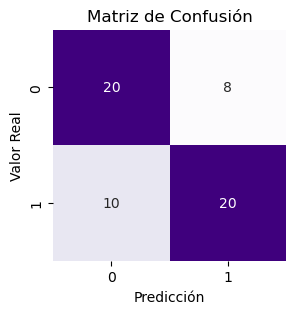


Resultados de validación cruzada para RandomForestClassifier:
Exactitud: 0.7241379310344828
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.71      0.71      0.71        28
           1       0.73      0.73      0.73        30

    accuracy                           0.72        58
   macro avg       0.72      0.72      0.72        58
weighted avg       0.72      0.72      0.72        58



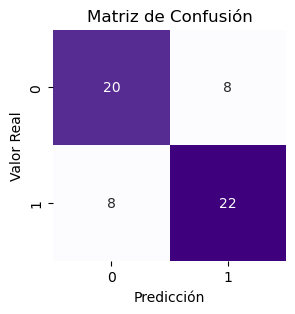


Resultados de validación cruzada para GradientBoostingClassifier:
Exactitud: 0.8793103448275862
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.92      0.82      0.87        28
           1       0.85      0.93      0.89        30

    accuracy                           0.88        58
   macro avg       0.88      0.88      0.88        58
weighted avg       0.88      0.88      0.88        58



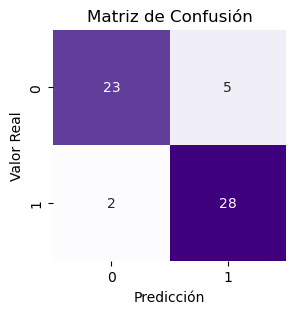


Resultados de validación cruzada para SVC:
Exactitud: 0.6379310344827587
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.62      0.64      0.63        28
           1       0.66      0.63      0.64        30

    accuracy                           0.64        58
   macro avg       0.64      0.64      0.64        58
weighted avg       0.64      0.64      0.64        58



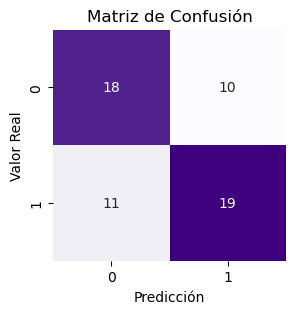

In [57]:
predictions = cross_validation_classification_models(df_selected, 10)

### <font color='purple'> **5.3 Clasificador multiclase** </font>

In [58]:
df_selected_m = pd.concat([X_selected_m, y_m], axis=1)

Resultados de validación cruzada para LogisticRegression:
Exactitud: 0.8003472222222222
Reporte de clasificación:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00        19
           2       0.00      0.00      0.00        22
           3       1.00      0.22      0.36         9
           4       0.83      0.94      0.89       422
           5       0.63      0.59      0.61       104

    accuracy                           0.80       576
   macro avg       0.49      0.35      0.37       576
weighted avg       0.74      0.80      0.76       576



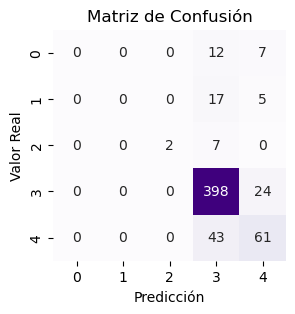


Resultados de validación cruzada para RandomForestClassifier:
Exactitud: 0.8715277777777778
Reporte de clasificación:
              precision    recall  f1-score   support

           1       1.00      0.11      0.19        19
           2       0.38      0.14      0.20        22
           3       1.00      0.33      0.50         9
           4       0.88      0.98      0.93       422
           5       0.85      0.79      0.82       104

    accuracy                           0.87       576
   macro avg       0.82      0.47      0.53       576
weighted avg       0.86      0.87      0.85       576



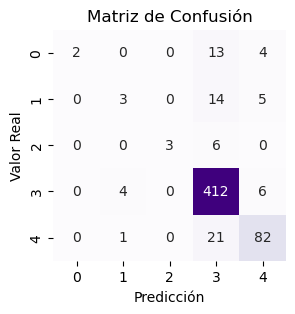


Resultados de validación cruzada para GradientBoostingClassifier:
Exactitud: 0.8072916666666666
Reporte de clasificación:
              precision    recall  f1-score   support

           1       0.14      0.05      0.08        19
           2       0.30      0.14      0.19        22
           3       0.00      0.00      0.00         9
           4       0.84      0.95      0.89       422
           5       0.75      0.57      0.64       104

    accuracy                           0.81       576
   macro avg       0.41      0.34      0.36       576
weighted avg       0.77      0.81      0.78       576



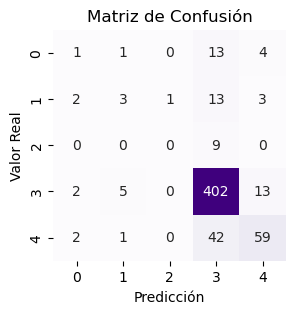


Resultados de validación cruzada para SVC:
Exactitud: 0.8420138888888888
Reporte de clasificación:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00        19
           2       0.50      0.05      0.08        22
           3       0.67      0.67      0.67         9
           4       0.88      0.95      0.91       422
           5       0.72      0.74      0.73       104

    accuracy                           0.84       576
   macro avg       0.55      0.48      0.48       576
weighted avg       0.80      0.84      0.81       576



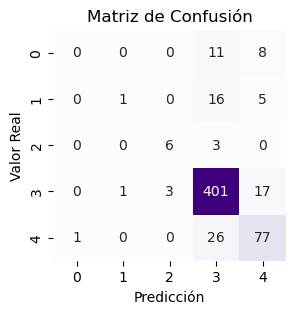

In [59]:
predictions_m = cross_validation_classification_models(df_selected_m, 10)

### <font color='purple'> **5.4 Clasificador multiclase balanceado** </font>

In [60]:
df_selected_m_b = pd.concat([X_selected_m_b, y_m_b], axis=1)

Resultados de validación cruzada para LogisticRegression:
Exactitud: 0.48148148148148145
Reporte de clasificación:
              precision    recall  f1-score   support

           1       0.31      0.28      0.29        18
           2       0.47      0.39      0.42        18
           3       0.67      0.89      0.76         9
           4       0.47      0.50      0.49        18
           5       0.53      0.56      0.54        18

    accuracy                           0.48        81
   macro avg       0.49      0.52      0.50        81
weighted avg       0.47      0.48      0.47        81



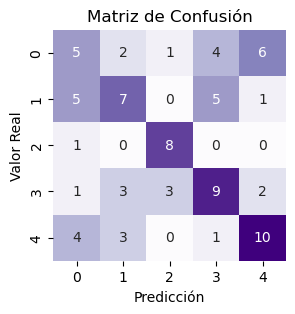


Resultados de validación cruzada para RandomForestClassifier:
Exactitud: 0.691358024691358
Reporte de clasificación:
              precision    recall  f1-score   support

           1       0.56      0.50      0.53        18
           2       0.72      0.72      0.72        18
           3       0.82      1.00      0.90         9
           4       0.69      0.61      0.65        18
           5       0.70      0.78      0.74        18

    accuracy                           0.69        81
   macro avg       0.70      0.72      0.71        81
weighted avg       0.68      0.69      0.69        81



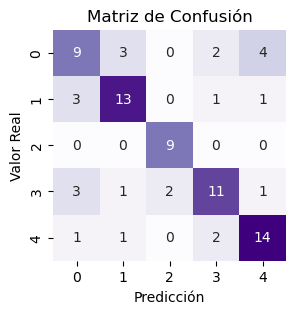


Resultados de validación cruzada para GradientBoostingClassifier:
Exactitud: 0.5555555555555556
Reporte de clasificación:
              precision    recall  f1-score   support

           1       0.47      0.50      0.49        18
           2       0.50      0.61      0.55        18
           3       0.78      0.78      0.78         9
           4       0.54      0.39      0.45        18
           5       0.61      0.61      0.61        18

    accuracy                           0.56        81
   macro avg       0.58      0.58      0.58        81
weighted avg       0.56      0.56      0.55        81



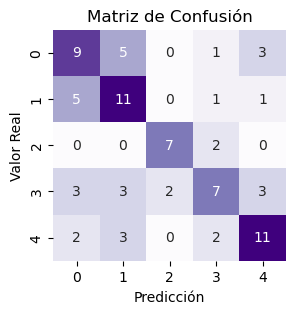


Resultados de validación cruzada para SVC:
Exactitud: 0.5432098765432098
Reporte de clasificación:
              precision    recall  f1-score   support

           1       0.44      0.39      0.41        18
           2       0.48      0.56      0.51        18
           3       0.80      0.89      0.84         9
           4       0.47      0.44      0.46        18
           5       0.65      0.61      0.63        18

    accuracy                           0.54        81
   macro avg       0.57      0.58      0.57        81
weighted avg       0.54      0.54      0.54        81



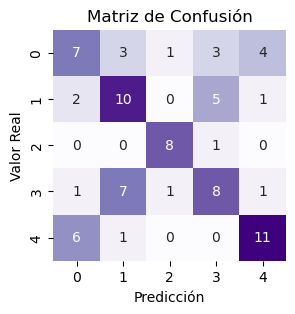

In [61]:
predictions_m_b = cross_validation_classification_models(df_selected_m_b, 10)

## <font color='purple'> **6.- Análisis de los features con más información** </font>

En esta sección, analizaremos los features con mayor ganancia de información.

### <font color='purple'> **6.1 Box plots** </font>

**mfcc_mean_2**

,Participante,Tiempo,mfcc_mean_2
0,ANDRES,ANTES,-6.768729
1,ANDRES,ANTES,-13.928553
2,ANDRES,ANTES,-8.854083
3,ANDRES,ANTES,-2.024903
4,ANDRES,ANTES,-12.413888


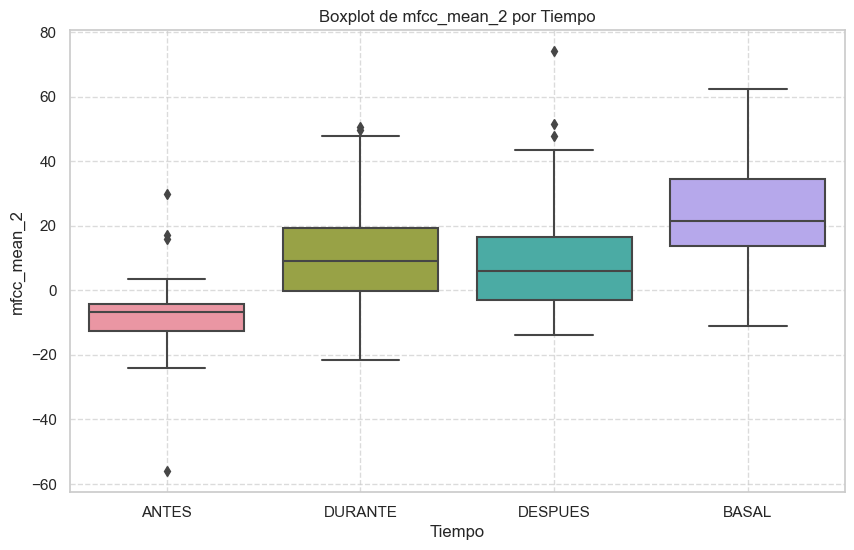

In [99]:
# Creamos una lista de diccionarios para almacenar los datos en formato largo
data = []

# Iteramos sobre cada fila de df_merged
for index, row in df_merged_multi.iterrows():
    # Añadimos una entrada para cada momento con su correspondiente max_pitch
    data.append({'Participante': row['Participante'], 'Tiempo': row['Tiempo'], 'mfcc_mean_2': row['mfcc_mean_2']})

# Creamos el DataFrame en formato largo
df_long = pd.DataFrame(data)

# Imprimimos el DataFrame
display(df_long.head())

# Definir el orden deseado de los tiempos
orden_tiempo = ['ANTES', 'DURANTE', 'DESPUES', 'BASAL']

# Convertir la columna 'Tiempo' a una categoría ordenada
df_long['Tiempo'] = pd.Categorical(df_long['Tiempo'], categories=orden_tiempo, ordered=True)

# Definir una paleta personalizada con tonos morados y naranjas
colores_personalizados = sns.color_palette(["purple", "orange"])

# Configuración de estilo
sns.set(style="whitegrid")
sns.set_palette(colores_personalizados) 

# Crear el boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x='Tiempo', y='mfcc_mean_2', data=df_long)
plt.title('Boxplot de mfcc_mean_2 por Tiempo')
plt.xlabel('Tiempo')
plt.ylabel('mfcc_mean_2')
plt.grid(True, linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.show()

**lpcc_mean_1**

,Participante,Tiempo,lpcc_mean_1
0,ANDRES,ANTES,0.009467
1,ANDRES,ANTES,0.012611
2,ANDRES,ANTES,0.012622
3,ANDRES,ANTES,0.019315
4,ANDRES,ANTES,0.009362


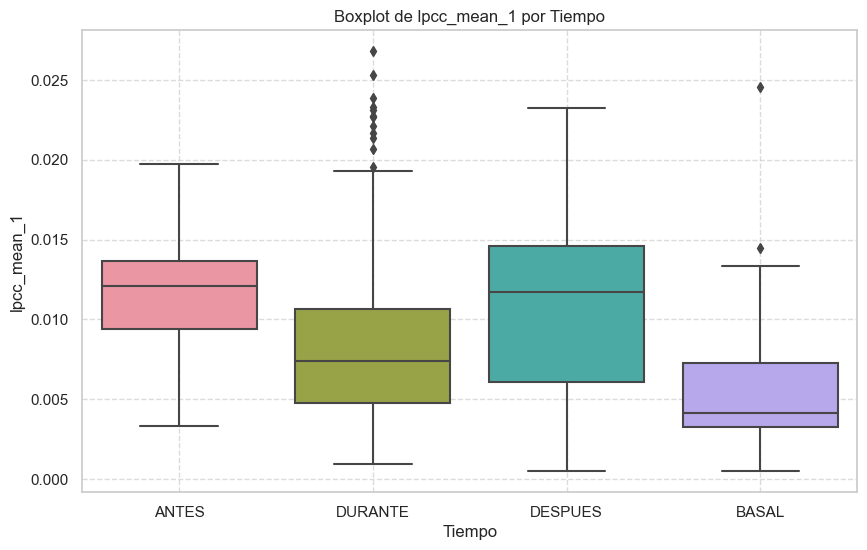

In [100]:
# Creamos una lista de diccionarios para almacenar los datos en formato largo
data = []

# Iteramos sobre cada fila de df_merged
for index, row in df_merged_multi.iterrows():
    # Añadimos una entrada para cada momento con su correspondiente lpcc_mean_1
    data.append({'Participante': row['Participante'], 'Tiempo': row['Tiempo'], 'lpcc_mean_1': row['lpcc_mean_1']})

# Creamos el DataFrame en formato largo
df_long = pd.DataFrame(data)

# Imprimimos el DataFrame
display(df_long.head())

# Definir el orden deseado de los tiempos
orden_tiempo = ['ANTES', 'DURANTE', 'DESPUES', 'BASAL']

# Convertir la columna 'Tiempo' a una categoría ordenada
df_long['Tiempo'] = pd.Categorical(df_long['Tiempo'], categories=orden_tiempo, ordered=True)

# Definir una paleta personalizada con tonos morados y naranjas
colores_personalizados = sns.color_palette(["purple", "orange"])

# Configuración de estilo
sns.set(style="whitegrid")
sns.set_palette(colores_personalizados) 

# Crear el boxplot con lpcc_mean_1 en el eje y
plt.figure(figsize=(10, 6))
sns.boxplot(x='Tiempo', y='lpcc_mean_1', data=df_long)
plt.title('Boxplot de lpcc_mean_1 por Tiempo')
plt.xlabel('Tiempo')
plt.ylabel('lpcc_mean_1')
plt.grid(True, linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.show()


**mfcc_mean_5**

,Participante,Tiempo,mfcc_mean_5
0,ANDRES,ANTES,1.084646
1,ANDRES,ANTES,0.983322
2,ANDRES,ANTES,-2.315841
3,ANDRES,ANTES,-2.408904
4,ANDRES,ANTES,2.171248


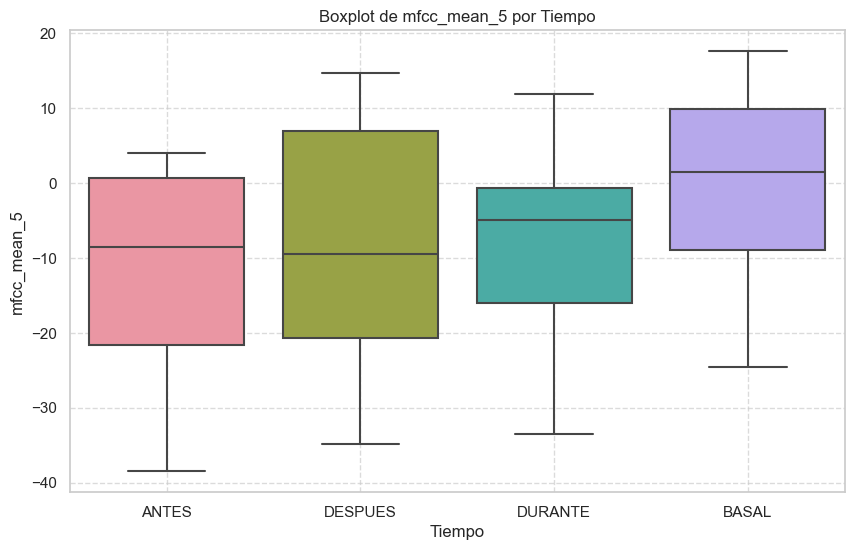

In [101]:
# Creamos una lista de diccionarios para almacenar los datos en formato largo
data_mfcc_mean_5 = []

# Iteramos sobre cada fila de df_merged
for index, row in df_merged_multi.iterrows():
    # Añadimos una entrada para cada momento con su correspondiente mfcc_mean_5
    data_mfcc_mean_5.append({'Participante': row['Participante'], 'Tiempo': row['Tiempo'], 'mfcc_mean_5': row['mfcc_mean_5']})

# Creamos el DataFrame en formato largo para mfcc_mean_5
df_long_mfcc_mean_5 = pd.DataFrame(data_mfcc_mean_5)

# Imprimimos el DataFrame
display(df_long_mfcc_mean_5.head())

# Definir una paleta personalizada con tonos morados y naranjas
colores_personalizados = sns.color_palette(["purple", "orange"])

# Configuración de estilo
sns.set(style="whitegrid")
sns.set_palette(colores_personalizados) 

# Crear el boxplot con mfcc_mean_5 en el eje y
plt.figure(figsize=(10, 6))
sns.boxplot(x='Tiempo', y='mfcc_mean_5', data=df_long_mfcc_mean_5)
plt.title('Boxplot de mfcc_mean_5 por Tiempo')
plt.xlabel('Tiempo')
plt.ylabel('mfcc_mean_5')
plt.grid(True, linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.show()


**f0_mean**

,Participante,Tiempo,f0_mean
0,ANDRES,ANTES,148.572778
1,ANDRES,ANTES,123.629181
2,ANDRES,ANTES,116.996764
3,ANDRES,ANTES,116.146088
4,ANDRES,ANTES,116.948989


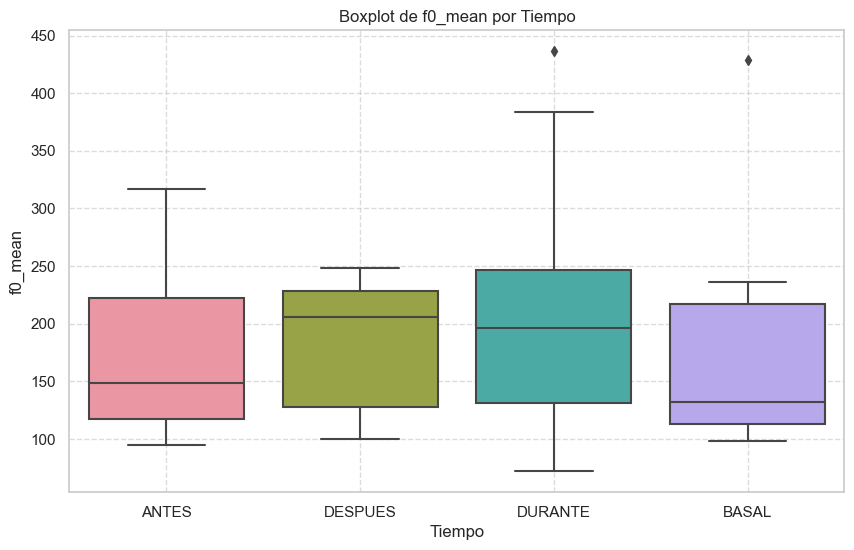

In [102]:
# Creamos una lista de diccionarios para almacenar los datos en formato largo
data_f0_mean = []

# Iteramos sobre cada fila de df_merged
for index, row in df_merged_multi.iterrows():
    # Añadimos una entrada para cada momento con su correspondiente f0_mean
    data_f0_mean.append({'Participante': row['Participante'], 'Tiempo': row['Tiempo'], 'f0_mean': row['f0_mean']})

# Creamos el DataFrame en formato largo para f0_mean
df_long_f0_mean = pd.DataFrame(data_f0_mean)

# Imprimimos el DataFrame
display(df_long_f0_mean.head())

# Definir una paleta personalizada con tonos morados y naranjas
colores_personalizados = sns.color_palette(["purple", "orange"])

# Configuración de estilo
sns.set(style="whitegrid")
sns.set_palette(colores_personalizados) 

# Crear el boxplot con f0_mean en el eje y
plt.figure(figsize=(10, 6))
sns.boxplot(x='Tiempo', y='f0_mean', data=df_long_f0_mean)
plt.title('Boxplot de f0_mean por Tiempo')
plt.xlabel('Tiempo')
plt.ylabel('f0_mean')
plt.grid(True, linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.show()


**max_pitch_frequency**

,Participante,Tiempo,max_pitch_frequency
0,ANDRES,ANTES,384.2
1,ANDRES,ANTES,455.2
2,ANDRES,ANTES,472.4
3,ANDRES,ANTES,440.8
4,ANDRES,ANTES,342.8


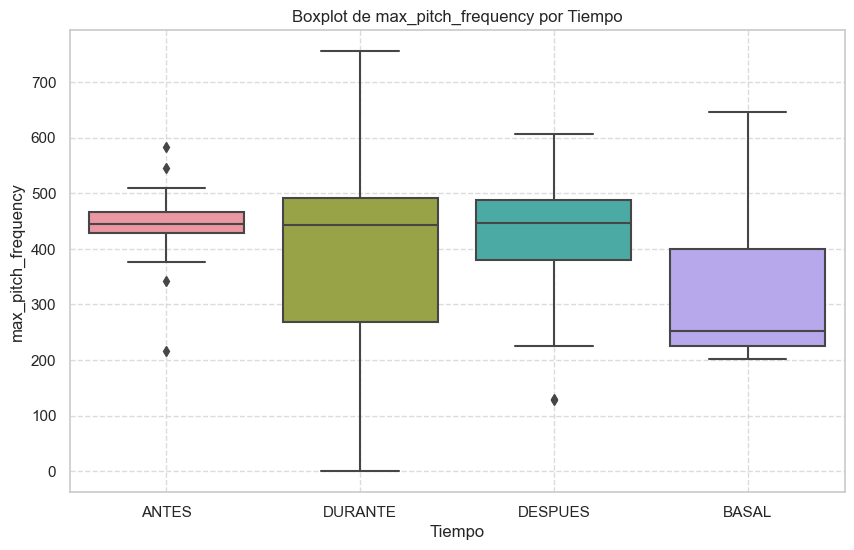

In [103]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Creamos una lista de diccionarios para almacenar los datos en formato largo
data = []

# Iteramos sobre cada fila de df_merged
for index, row in df_merged_multi.iterrows():
    # Añadimos una entrada para cada momento con su correspondiente max_pitch
    data.append({'Participante': row['Participante'], 'Tiempo': row['Tiempo'], 'max_pitch_frequency': row['max_pitch_frequency']})

# Creamos el DataFrame en formato largo
df_long = pd.DataFrame(data)

# Imprimimos el DataFrame
display(df_long.head())

# Definir el orden deseado de los tiempos
orden_tiempo = ['ANTES', 'DURANTE', 'DESPUES', 'BASAL']

# Convertir la columna 'Tiempo' a una categoría ordenada
df_long['Tiempo'] = pd.Categorical(df_long['Tiempo'], categories=orden_tiempo, ordered=True)

# Definir una paleta personalizada con tonos morados y naranjas
colores_personalizados = sns.color_palette(["purple", "orange"])

# Configuración de estilo
sns.set(style="whitegrid")
sns.set_palette(colores_personalizados) 

# Crear el boxplot con max_pitch_frequency en el eje y
plt.figure(figsize=(10, 6))
sns.boxplot(x='Tiempo', y='max_pitch_frequency', data=df_long)
plt.title('Boxplot de max_pitch_frequency por Tiempo')
plt.xlabel('Tiempo')
plt.ylabel('max_pitch_frequency')
plt.grid(True, linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.show()


**Observaciones:**

+ Se observa que el box plot para la característica max_pitch_frequency exhibe un comportamiento similar al estrés reportado en la escala de Likert por cada participante.

### <font color='purple'> **6.2 max_pitch_frequency** </font>

El feature `max_pitch_frequency` parece ser relevante para predecir el nivel de ansiedad en ausencia de los auto reportes, lo que sugiere ser una alternativa al estrés reportado en la escala de Likert.

A continuación, analizaremos el feature `max_pitch_frequency` en el espectrograma y en un gráfico de frecuencia frente a magnitud.

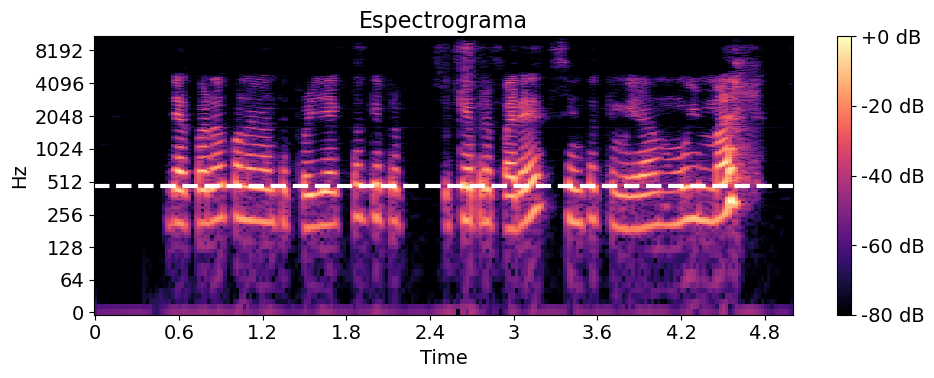

In [91]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt

# Carpeta donde se encuentra el archivo de audio
folder = "C:/Users/scarl/Desktop/CICESE/Cuatrimestre2/CDSI/ProyectoFinal/segmented_audio_multiclass_clf/"

# Cargar la señal de audio
audio_file = folder + df_merged_multi['filename'][20]
y, sr = librosa.load(audio_file)

# Transformada de Fourier de los datos
fourier_transform = np.fft.rfft(y)
magnitudes = np.abs(fourier_transform)  # Magnitudes de las frecuencias

# Frecuencias correspondientes
frequencies = np.fft.rfftfreq(len(y), 1 / sr)

# Tonos en el dominio de la frecuencia
max_pitch_index = np.argmax(magnitudes)  # Índice del tono máximo
max_pitch_frequency = frequencies[max_pitch_index]  # Frecuencia asociada con el índice del tono máximo

# Calcular el espectrograma
D = np.abs(librosa.stft(y))

# Graficar el espectrograma
# Ajustar el tamaño de la fuente general
plt.rcParams.update({'font.size': 14})
plt.figure(figsize=(10, 4))
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max), sr=sr, x_axis='time', y_axis='log')

# Añadir línea horizontal en el max_pitch
plt.axhline(y=max_pitch_frequency, color='w', linestyle='--', linewidth=3)

# Configuraciones adicionales del gráfico
plt.colorbar(format='%+2.0f dB')
plt.title('Espectrograma', fontsize=16)
plt.tight_layout()
plt.show()

In [100]:
max_pitch_frequency

466.0

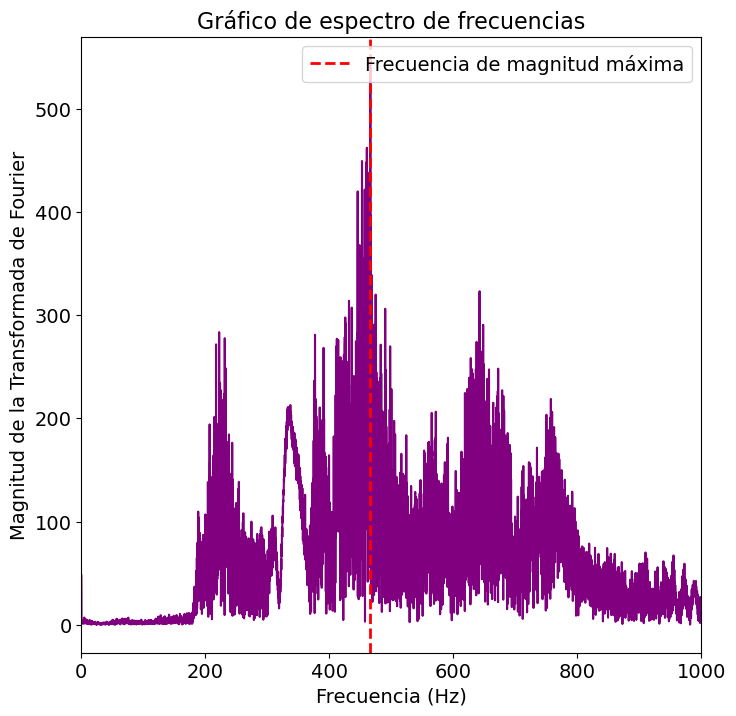

In [92]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt

# Carpeta donde se encuentra el archivo de audio
folder = "C:/Users/scarl/Desktop/CICESE/Cuatrimestre2/CDSI/ProyectoFinal/segmented_audio_multiclass_clf/"

# Cargar la señal de audio
audio_file = folder + df_merged_multi['filename'][20]
y, sr = librosa.load(audio_file)

# Transformada de Fourier de los datos
fourier_transform = np.fft.rfft(y)
magnitudes = np.abs(fourier_transform)  # Magnitudes de las frecuencias

# Frecuencias correspondientes
frequencies = np.fft.rfftfreq(len(y), 1 / sr)

# Tonos en el dominio de la frecuencia
max_pitch_index = np.argmax(magnitudes)  # Índice del tono máximo
max_pitch_frequency = frequencies[max_pitch_index]  # Frecuencia asociada con el índice del tono máximo

# Graficar entre 0 y 1000 Hz con color morado
plt.figure(figsize=(8, 8))
plt.plot(frequencies, magnitudes, color='purple')
plt.xlim(0, 1000)  # Limitar el eje x entre 0 y 1000 Hz
plt.xlabel('Frecuencia (Hz)', fontsize=14)  # Especificar el tamaño de la fuente
plt.ylabel('Magnitud de la Transformada de Fourier', fontsize=14)  # Especificar el tamaño de la fuente
plt.title('Gráfico de espectro de frecuencias', fontsize=16)  # Especificar el tamaño de la fuente
plt.axvline(x=max_pitch_frequency, color='r', linestyle='--', label='Frecuencia de magnitud máxima', linewidth=2)
plt.legend()
plt.show()

**Observaciones:**

+ Se observa que el feature `max_pitch_frequency` es aquel que exhibe una mayor magnitud a lo largo de la señal.

## <font color='purple'> **7.- Análisis de discuros** </font>

A continuación, se procederá a transcribir los audios con el fin de llevar a cabo un análisis del discurso de los mismos.

In [75]:
#!pip install SpeechRecognition

In [76]:
import speech_recognition as sr

# Función para transcribir un archivo de audio
def transcribir_audio(ruta_audio):
    recognizer = sr.Recognizer()
    with sr.AudioFile(ruta_audio) as source:
        audio_data = recognizer.record(source)
        text = ""
        try:
            text = recognizer.recognize_google(audio_data, language="es-MX")
        except sr.UnknownValueError:
            print("No se pudo entender el audio")
        except sr.RequestError as e:
            print(f"Error al solicitar resultados de Google Speech Recognition service; {e}")
        return text

# Ruta de la carpeta que contiene los archivos de audio
carpeta_audios = "AudiosSegmentados"

# Crear un nuevo DataFrame para almacenar las transcripciones
df_transcripciones = pd.DataFrame(columns=['filename', 'Transcripcion'])

# Iterar sobre el dataframe y transcribir cada audio
for index, row in df_segmentos.iterrows():
    nombre_archivo = row['filename']
    ruta_audio = os.path.join(carpeta_audios, nombre_archivo)
    transcripcion = transcribir_audio(ruta_audio)
    df_transcripciones = df_transcripciones.append({'filename': nombre_archivo, 'Transcripcion': transcripcion}, ignore_index=True)

# Guardar el DataFrame de transcripciones en un archivo CSV
df_transcripciones.to_csv("df_transcripciones.csv", index=False, encoding='utf-8-sig')

No se pudo entender el audio


In [77]:
df_transcripciones.head()

,filename,Transcripcion
0,ANTES_ANDRES_5_34_Sentimiento.wav,pues me siento bien porque siento que prepare ...
1,ANTES_ANDRES_39_45_FrasePositiva.wav,Okay de acuerdo con el anteproyecto que prepar...
2,ANTES_ANDRES_45_50_FraseNegativa.wav,de acuerdo con el anteproyecto que prepare sie...
3,ANTES_ARIANA_7_16_Sentimiento.wav,siento que me irá bien pero aún me falta prepa...
4,ANTES_ARIANA_21_26_FrasePositiva.wav,de acuerdo con el anteproyecto que prepare sie...


In [78]:
# Fusionar los DataFrames usando la columna 'filename' como pivote
df_transcripciones_merged = pd.merge(df_transcripciones, df_segmentos[['filename', 'contenido', 'Tiempo', 'Participante', 'StressLevel']], on='filename', how='left')
display(df_transcripciones_merged.head())

# Guardar el DataFrame de transcripciones en un archivo CSV
df_transcripciones_merged.to_csv("df_transcripciones_merged.csv", index=False, encoding='utf-8-sig')

,filename,Transcripcion,contenido,Tiempo,Participante,StressLevel
0,ANTES_ANDRES_5_34_Sentimiento.wav,pues me siento bien porque siento que prepare ...,Sentimiento,ANTES,ANDRES,4
1,ANTES_ANDRES_39_45_FrasePositiva.wav,Okay de acuerdo con el anteproyecto que prepar...,FrasePositiva,ANTES,ANDRES,4
2,ANTES_ANDRES_45_50_FraseNegativa.wav,de acuerdo con el anteproyecto que prepare sie...,FraseNegativa,ANTES,ANDRES,4
3,ANTES_ARIANA_7_16_Sentimiento.wav,siento que me irá bien pero aún me falta prepa...,Sentimiento,ANTES,ARIANA,3
4,ANTES_ARIANA_21_26_FrasePositiva.wav,de acuerdo con el anteproyecto que prepare sie...,FrasePositiva,ANTES,ARIANA,3


In [79]:
# Filtrar las instancias correspondientes a 'DURANTE' en la columna 'Tiempo'
df_transcripts = df_transcripciones_merged[df_transcripciones_merged['Tiempo'] != 'DURANTE'].copy()

df_transcripts = df_transcripts[df_transcripts['contenido'] == 'Sentimiento']

# Verificar el nuevo DataFrame
display(df_transcripts.head())

,filename,Transcripcion,contenido,Tiempo,Participante,StressLevel
0,ANTES_ANDRES_5_34_Sentimiento.wav,pues me siento bien porque siento que prepare ...,Sentimiento,ANTES,ANDRES,4
3,ANTES_ARIANA_7_16_Sentimiento.wav,siento que me irá bien pero aún me falta prepa...,Sentimiento,ANTES,ARIANA,3
6,ANTES_DAFNE_6_12_Sentimiento.wav,Okay me siento preparada creo que prepare un b...,Sentimiento,ANTES,DAFNE,2
9,ANTES_JESUS_6_12_Sentimiento.wav,pues me siento un poco nervioso pero tengo bie...,Sentimiento,ANTES,JESUS,4
12,ANTES_JUAN_6_15_Sentimiento.wav,la verdad fue algo complicado porque no estoy ...,Sentimiento,ANTES,JUAN,5


### <font color='purple'> **7.1 Obtención de Bag of Words y Wordclouds** </font>

En esta sección se generarán las bolsas de palabras que contienen unigramas, bigramas y trigramas, con el propósito de llevar a cabo un análisis semántico sobre la relación entre las palabras utilizadas y los niveles de estrés reportados en la escala de Likert.

Para los unigramas, se han creado word clouds tanto para unigramas puros como para aquellos sin stopwords. Además, se han generado word clouds específicos para cada nivel de estrés individual, así como para agrupaciones de niveles de estrés de la siguiente manera:

- `{(1),(2, 3),(4, 5)}`
- `{(1, 2),(3, 4, 5)}`

Posteriormente, se procedió a obtener los bigramas y trigramas, tanto puros como sin stopwords, para todos los niveles de estrés y para la agrupación `{(1, 2),(3, 4, 5)}`, simulando una clasificación binaria.

#### <font color='purple'> **7.1.1 Definición de funciones para procesar n-gramas** </font>

+ Función para **limpieza de texto**.

In [2]:
def limpiar(oracion):
    if pd.isnull(oracion):
        return ''  # Replace NaN with an empty string
    oracion = oracion.lower()
    oracion = unidecode(oracion) # Eliminar acentos
    oracion = re.sub(r"@\S+", "", oracion)  # Eliminar menciones a usuarios
    oracion = re.sub("http[s]?\://\S+", "", oracion)  # Eliminar enlaces
    oracion = re.sub(r"#\S+", "", oracion)  # Eliminar hashtags
    oracion = re.sub(r"[0-9]", "", oracion)  # Eliminar números
    oracion = re.sub(r"(\(.*\))|(\[.*\])", "", oracion)  # Eliminar paréntesis y corchetes
    oracion = re.sub(r"\n", "", oracion)  # Eliminar caracteres de nueva línea
    oracion = re.sub(r"(http[s]?\://\S+)|([\[\(].*[\)\]])|([#@]\S+)|\n", "", oracion)  # Eliminar varios patrones
    oracion = re.sub(r"(\.)|(,)", "", oracion)  # Eliminar puntos y comas
    oracion = re.sub(r"[¡!]", "", oracion)  # Eliminar signos de admiración 
    oracion = re.sub(r"[¿?]", "", oracion)  # Eliminar signos de exclamación
    oracion = BeautifulSoup(oracion, "lxml").text # Eliminar etiquetas HTML
    oracion = re.sub(r'\([^)]*\)', '', oracion) # Eliminar texto entre paréntesis
    oracion = re.sub('"','', oracion) # Eliminar comillas
    oracion = re.sub("[^a-zA-Z]", " ", oracion) # Eliminar caracteres no alfabéticos
    for letra in 'abcdefghijklmnopqrstuvwxyz':
        # Se define el patrón de búsqueda para cualquier letra repetida
        patron = f'[{letra}]{{2,}}'
        # Eliminar secuencias repetidas de letras, por ejemplo, convertir secuencias repetidas de 'm' en 'mm'
        oracion = re.sub(patron, letra * 2, oracion)
    return oracion

+ Función para **tokenización**.

In [3]:
def tokenizacion(oracion):
    tokens = word_tokenize(oracion)
    return ' '.join(tokens)

In [4]:
def tokenizacion2(oracion):
    tokens = word_tokenize(oracion)
    return tokens

+ Función para **eliminación de Stopwords**.

In [5]:
def stopword(tokens):
    stopwords_espanol = stopwords.words('spanish')
    palabras_filtradas = [palabra for palabra in tokens if palabra not in stopwords_espanol]
    oracion = ' '.join(palabras_filtradas)
    return oracion

+ Función para **lematización**.

In [6]:
#sudo python3 -m spacy download es
def lematización(palabras_filtradas):
    nlp = spacy.load("es_core_news_sm")
    lema = nlp(" ".join(palabras_filtradas))
    oracion_lematizada = " ".join([token.lemma_ for token in lema])
    return oracion_lematizada

+ Función de **procesamiento de texto**

In [7]:
def procesar_texto_para_unigramas_puros(df_texts):
    
    df_words = df_texts.copy()
    
    # Se procesa cada oración
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(limpiar)
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(tokenizacion)
    #df_words['text'] = df_words['text'].apply(stopword)
    #df_words['text'] = df_words['text'].apply(lematización)    
    
    # Se inicializa el vectorizador de bigramas
    vectorizer = CountVectorizer()
    
    # Se obtienen los textos y etiquetas del DataFrame
    textos = df_words['Transcripcion'].tolist()
    labels = df_words['StressLevel'].tolist()

    # Se vectorizan los textos (unigramas)
    X = vectorizer.fit_transform(textos)

    # Se crea un DataFrame con los unigramas y las etiquetas
    df_unigrams = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())
    df_unigrams['StressLevel'] = labels

    return df_unigrams

In [8]:
def procesar_texto_para_unigramas(df_texts):
    df_words = df_texts.copy()
    
    # Se procesa cada oración
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(limpiar)
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(tokenizacion2)
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(stopword) 
    
    # Se inicializa el vectorizador de bigramas
    vectorizer = CountVectorizer()
    
    # Se obtienen los textos y etiquetas del DataFrame
    textos = df_words['Transcripcion'].tolist()
    labels = df_words['StressLevel'].tolist()

    # Se vectorizan los textos (unigramas)
    X = vectorizer.fit_transform(textos)

    # Se crea un DataFrame con los unigramas y las etiquetas
    df_unigrams = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())
    df_unigrams['StressLevel'] = labels

    return df_unigrams

In [9]:
def procesar_texto_para_bigramas_puros(df_texts):
    df_words = df_texts.copy()
    
    # Se procesa cada oración
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(limpiar)
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(tokenizacion) 
    
    # Se inicializa el vectorizador de bigramas
    vectorizer = CountVectorizer(ngram_range=(2, 2))
    
    # Se obtienen los textos y etiquetas del DataFrame
    textos = df_words['Transcripcion'].tolist()
    labels = df_words['StressLevel'].tolist()

    # Se vectorizan los textos (bigramas)
    X = vectorizer.fit_transform(textos)

    # Se crea un DataFrame con los bigramas y las etiquetas
    df_bigrams = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())
    df_bigrams['StressLevel'] = labels

    return df_bigrams

In [10]:
def procesar_texto_para_bigramas(df_texts):
    df_words = df_texts.copy()
    
    # Se procesa cada oración
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(limpiar)
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(tokenizacion2)
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(stopword)  
    
    # Se inicializa el vectorizador de bigramas
    vectorizer = CountVectorizer(ngram_range=(2, 2))
    
    # Se obtienen los textos y etiquetas del DataFrame
    textos = df_words['Transcripcion'].tolist()
    labels = df_words['StressLevel'].tolist()

    # Se vectorizan los textos (bigramas)
    X = vectorizer.fit_transform(textos)

    # Se crea un DataFrame con los bigramas y las etiquetas
    df_bigrams = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())
    df_bigrams['StressLevel'] = labels

    return df_bigrams

In [11]:
def procesar_texto_para_trigramas_puros(df_texts):
    df_words = df_texts.copy()
    
    # Aplicar limpieza y lematización a cada oración
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(limpiar)
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(tokenizacion)

    # Inicializar el vectorizador de trigramas
    vectorizer = CountVectorizer(ngram_range=(3, 3))
    
    # Obtener las oraciones y etiquetas del DataFrame
    textos = df_words['Transcripcion'].tolist()
    labels = df_words['StressLevel'].tolist()

    # Vectorizar las oraciones
    X = vectorizer.fit_transform(textos)

    # Crear un DataFrame con los trigramas y las etiquetas
    df_trigrams = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())
    df_trigrams['StressLevel'] = labels

    return df_trigrams

In [12]:
def procesar_texto_para_trigramas(df_texts):
    df_words = df_texts.copy()
    
    # Aplicar limpieza y lematización a cada oración
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(limpiar)
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(tokenizacion2)
    df_words['Transcripcion'] = df_words['Transcripcion'].apply(stopword) 

    # Inicializar el vectorizador de trigramas
    vectorizer = CountVectorizer(ngram_range=(3, 3))
    
    # Obtener las oraciones y etiquetas del DataFrame
    textos = df_words['Transcripcion'].tolist()
    labels = df_words['StressLevel'].tolist()
    # Vectorizar las oraciones
    X = vectorizer.fit_transform(textos)

    # Crear un DataFrame con los trigramas y las etiquetas
    df_trigrams = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())
    df_trigrams['StressLevel'] = labels

    return df_trigrams

#### <font color='purple'> **7.1.2 Obtención de unigramas puros** </font>

In [15]:
df_transcripts

,filename,Transcripcion
0,ANTES_ANDRES_5_34_Sentimiento.wav,pues me siento bien porque siento que prepare ...
1,ANTES_ANDRES_39_45_FrasePositiva.wav,Okay de acuerdo con el anteproyecto que prepar...
2,ANTES_ANDRES_45_50_FraseNegativa.wav,de acuerdo con el anteproyecto que prepare sie...
3,ANTES_ARIANA_7_16_Sentimiento.wav,siento que me irá bien pero aún me falta prepa...
4,ANTES_ARIANA_21_26_FrasePositiva.wav,de acuerdo con el anteproyecto que prepare sie...
...,...,...
187,BASAL_RACHEL_20_28_CosasPositivas.wav,mmm el silencio el no estar estresado y no ten...
188,BASAL_RACHEL_32_38_FraseNeutra.wav,en este momento me siento tranquila y en calma...
189,BASAL_SCARLETT_5_14_Sentimiento.wav,mmm me siento tranquila como despejada menos a...
190,BASAL_SCARLETT_18_31_CosasPositivas.wav,mmm yo creo que platicar con mi mamá con mi no...


In [20]:
df_transcripts = pd.read_csv("df_transcripciones_merged.csv")
df_transcripts = df_transcripts[df_transcripts['contenido'] == 'Sentimiento']

Se eliminan las palabras relacionadas con `siento`, ya que se repetían como respuesta a la pregunta `¿Cómo te sientes en este momento?`

In [30]:
df_bow = procesar_texto_para_unigramas_puros(df_transcripts)
df_bow.drop(columns=['siento'], inplace=True)

In [31]:
display(df_bow.head())

,abrumada,ahorita,al,alcance,algo,altas,ansiosa,ante,asentado,asi,...,vamos,varias,varios,vaya,ve,verdad,voy,ya,yo,StressLevel
0,0,0,0,0,1,0,0,0,1,0,...,0,1,0,0,0,0,1,1,0,4
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
4,0,0,0,0,1,0,0,0,0,0,...,0,0,0,1,0,1,0,0,0,5


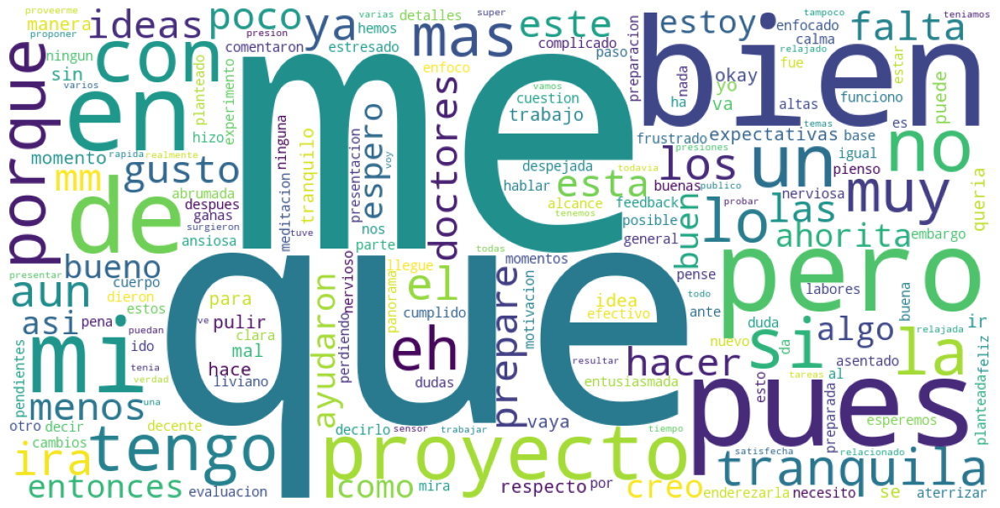

In [32]:
# Ruta de la carpeta para guardar las figuras
carpeta_figuras = "Figuras"

# Verificar si la carpeta existe, si no, crearla
if not os.path.exists(carpeta_figuras):
    os.makedirs(carpeta_figuras)


# Seleccionamos los tokens
tokens_cols = df_bow.columns[:-1]  # Excluir la última columna 'StressLevel'

# Creamos un diccionario a partir de las columnas de unigramas
word_cloud_data = dict(zip(tokens_cols, df_bow[tokens_cols].sum()))

# Creamos el WordCloud a partir del diccionario
wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

# Mostrar el WordCloud de unigramas
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud)
plt.axis('off')
# Guardar la figura en la carpeta
plt.tight_layout()
ruta_figura = os.path.join(carpeta_figuras, "wordcloud_unigrams(all_levels).png")
plt.savefig(ruta_figura)
plt.show()

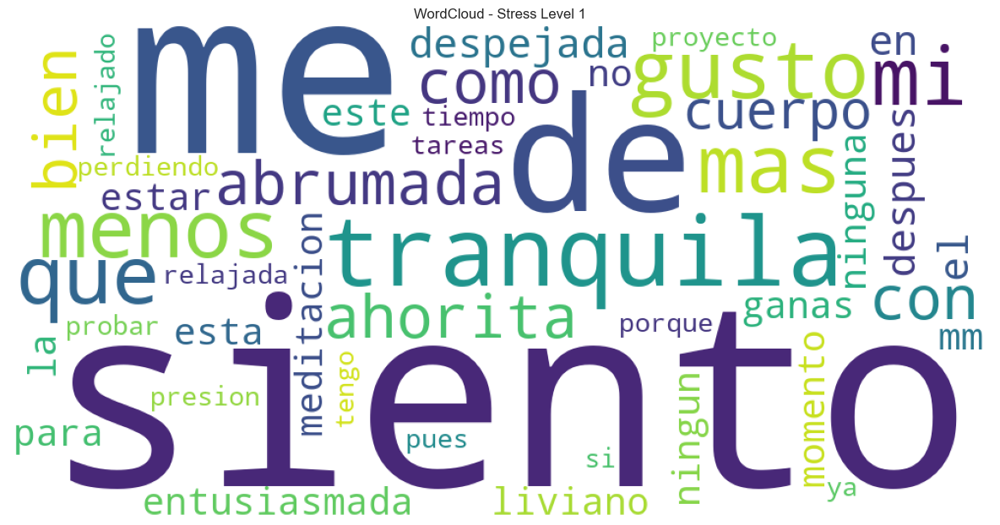

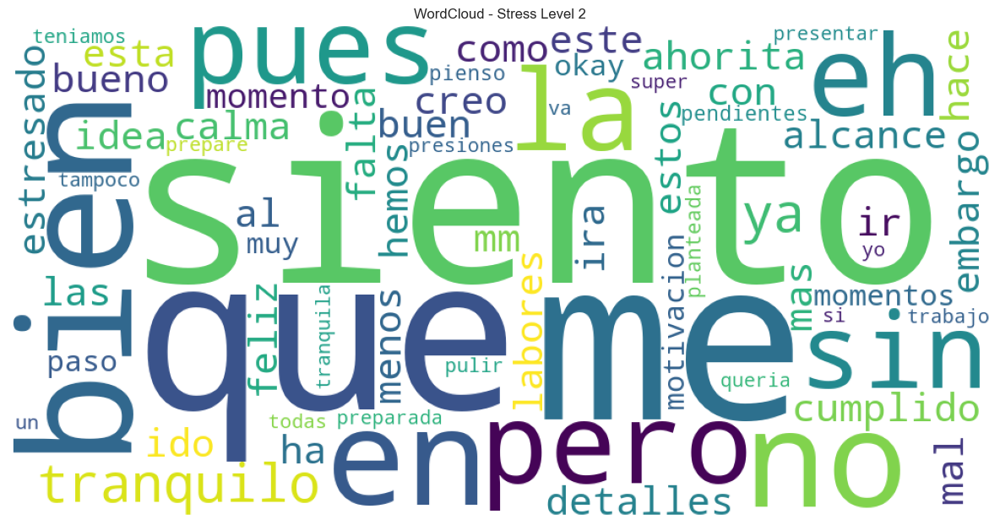

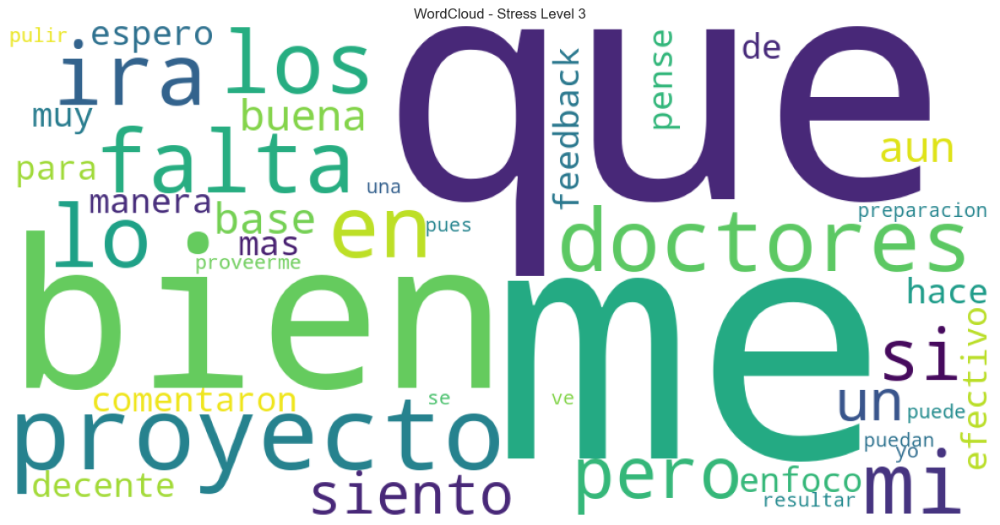

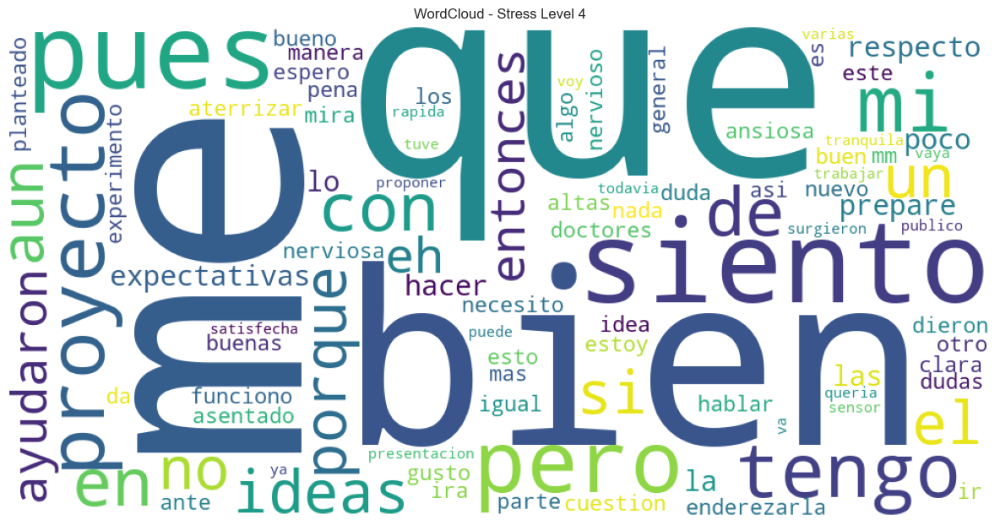

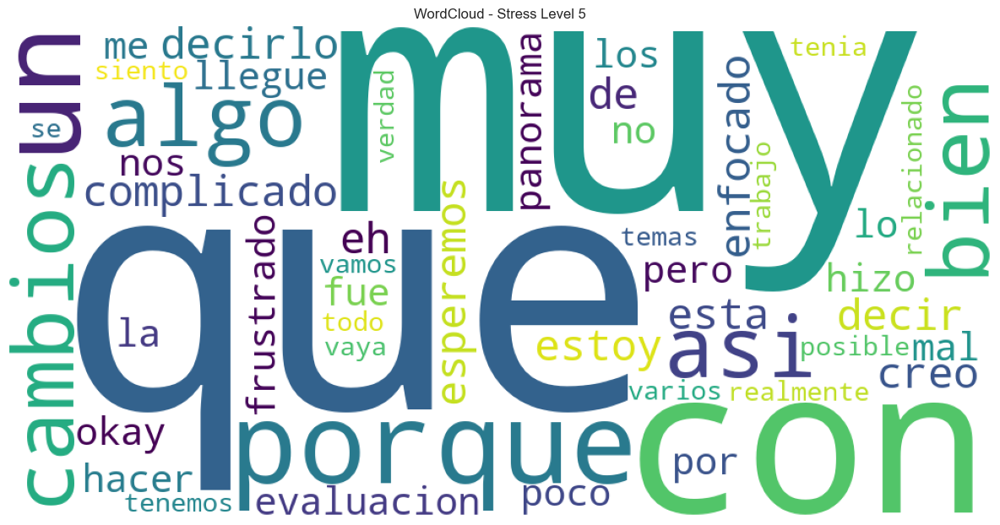

In [173]:
# Iterar sobre los 5 niveles de estrés
for stress_level in range(1, 6):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel igual a stress_level
    df_stress_level = df_bow[df_bow['StressLevel'] == stress_level]

    # Seleccionar los tokens
    tokens_cols = df_stress_level.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_stress_level[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Level {stress_level}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, f"wordcloud_unigrams_stress_level_{stress_level}.png")
    plt.savefig(ruta_figura)
    plt.show()

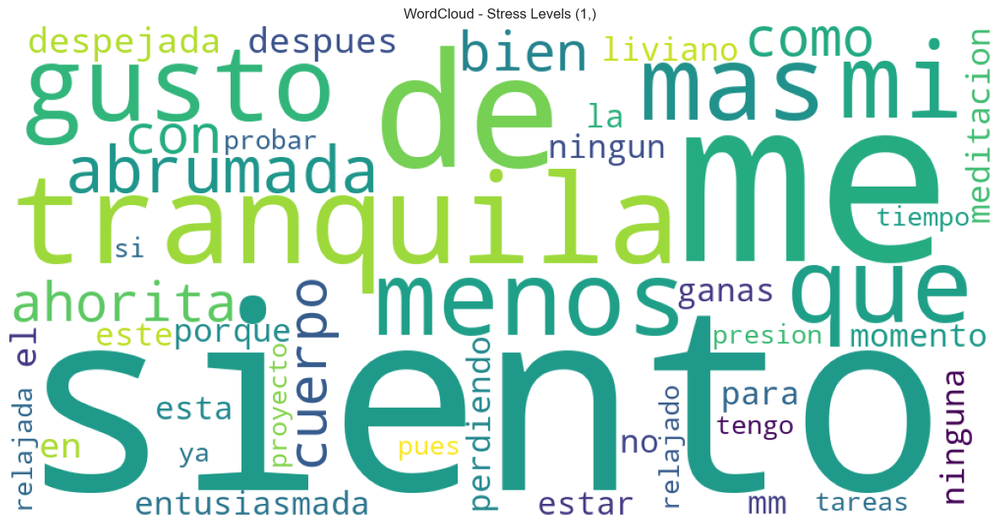

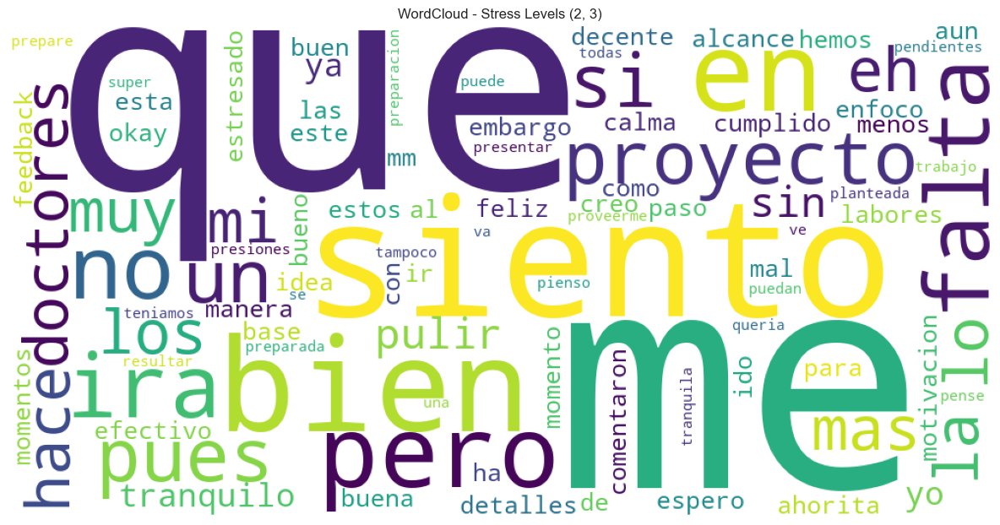

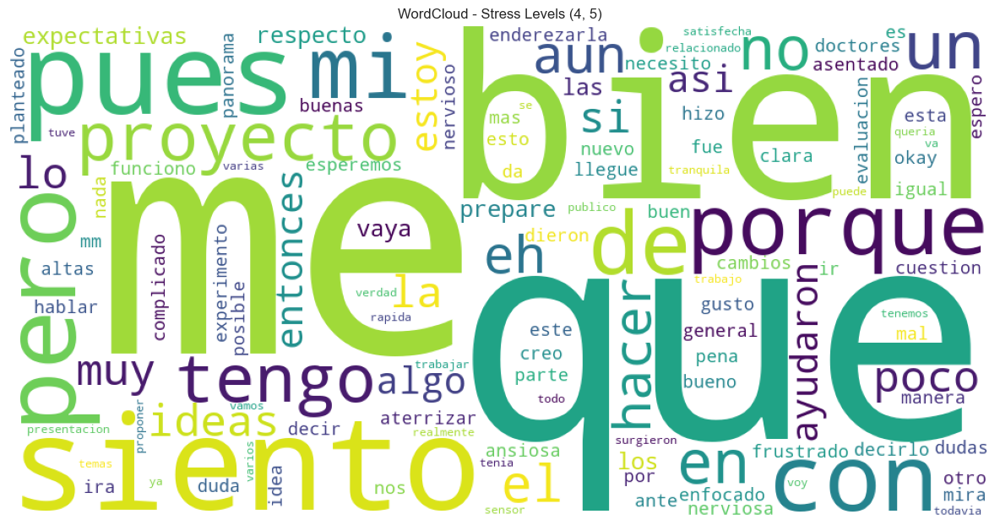

In [174]:
# Definir los grupos de niveles de estrés
grupos = [(1,), (2, 3), (4, 5)]
nombres_archivos = ['wordcloud_unigrams_StressLevel_1.png', 'wordcloud_unigrams_StressLevel_2-3.png', 'wordcloud_unigrams_StressLevel_4-5.png']

# Iterar sobre los grupos de niveles de estrés
for idx, grupo in enumerate(grupos):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel en el grupo actual
    df_grupo = df_bow[df_bow['StressLevel'].isin(grupo)]

    # Seleccionar los tokens
    tokens_cols = df_grupo.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_grupo[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Levels {grupo}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, nombres_archivos[idx])
    plt.savefig(ruta_figura)
    plt.show()

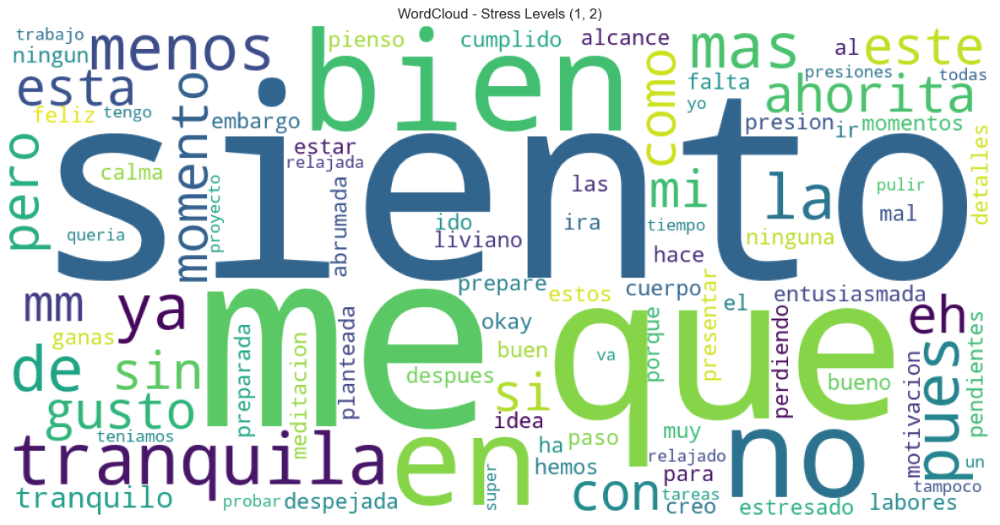

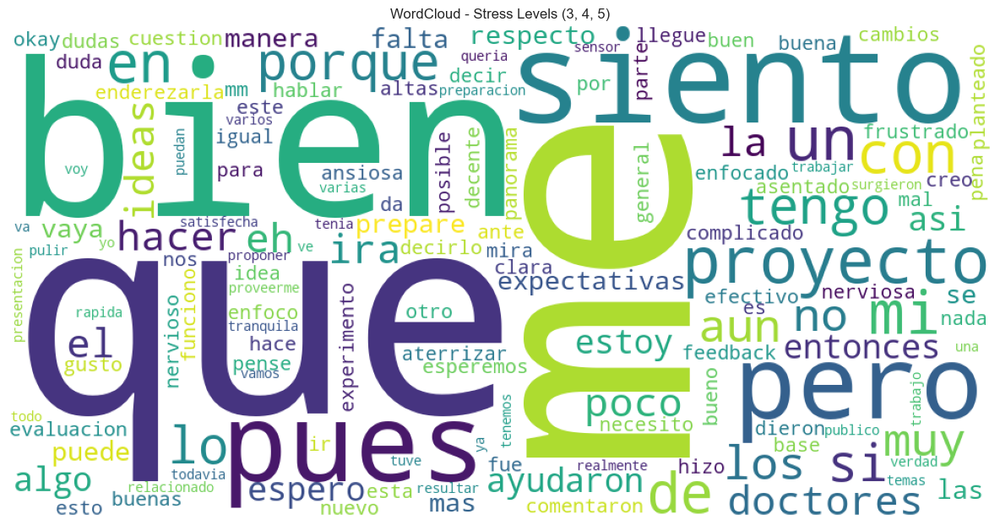

In [175]:
# Definir los grupos de niveles de estrés
grupos = [(1,2), (3, 4, 5)]
nombres_archivos = ['wordcloud_unigrams_StressLevel_1-2.png', 'wordcloud_unigrams_StressLevel_3-5.png']

# Iterar sobre los grupos de niveles de estrés
for idx, grupo in enumerate(grupos):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel en el grupo actual
    df_grupo = df_bow[df_bow['StressLevel'].isin(grupo)]

    # Seleccionar los tokens
    tokens_cols = df_grupo.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_grupo[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Levels {grupo}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, nombres_archivos[idx])
    plt.savefig(ruta_figura)
    plt.show()

#### <font color='purple'> **7.1.3 Obtención de unigramas sin stopwords** </font>

Se eliminan las palabras relacionadas con `siento`, ya que se repetían como respuesta a la pregunta `¿Cómo te sientes en este momento?`

In [33]:
df_bow_sw = procesar_texto_para_unigramas(df_transcripts)
df_bow_sw.drop(columns=['siento'], inplace=True)

In [34]:
display(df_bow_sw.head())

,abrumada,ahorita,alcance,altas,ansiosa,asentado,asi,aterrizar,aun,ayudaron,...,tranquilo,va,vamos,varias,varios,vaya,ve,verdad,voy,StressLevel
0,0,0,0,0,0,1,0,0,1,0,...,0,1,0,1,0,0,0,0,1,4
1,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,3
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,5


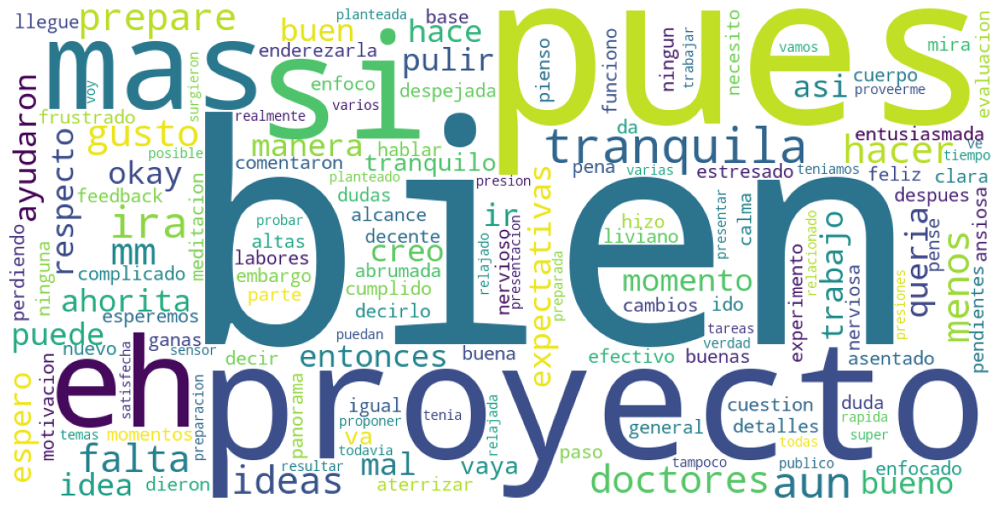

In [35]:
# Seleccionamos los tokens
tokens_cols = df_bow_sw.columns[:-1]  # Excluir la última columna 'StressLevel'

# Creamos un diccionario a partir de las columnas de unigramas
word_cloud_data = dict(zip(tokens_cols, df_bow_sw[tokens_cols].sum()))

# Creamos el WordCloud a partir del diccionario
wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

# Mostrar el WordCloud de unigramas
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud)
plt.axis('off')
# Guardar la figura en la carpeta
plt.tight_layout()
ruta_figura = os.path.join(carpeta_figuras, "wordcloud_unigrams_sw(all_levels).png")
plt.savefig(ruta_figura)
plt.show()

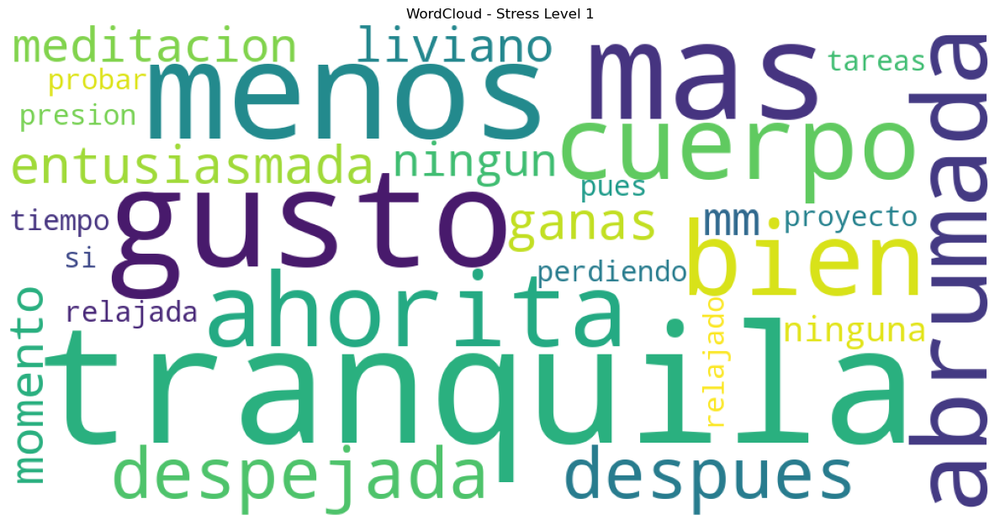

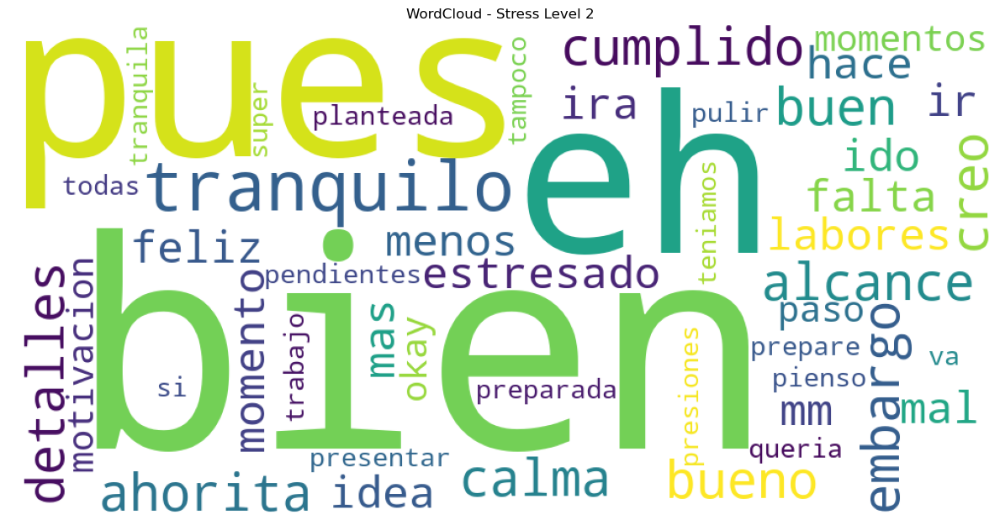

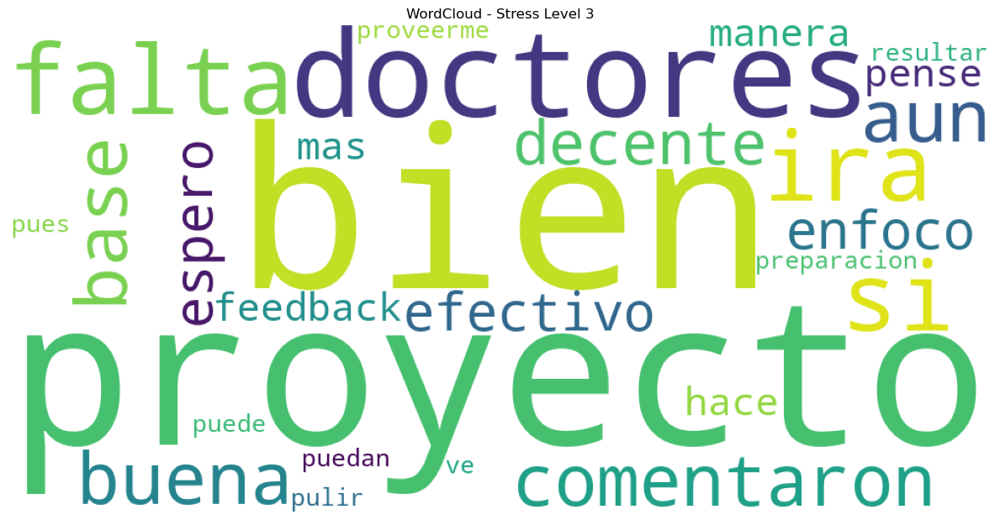

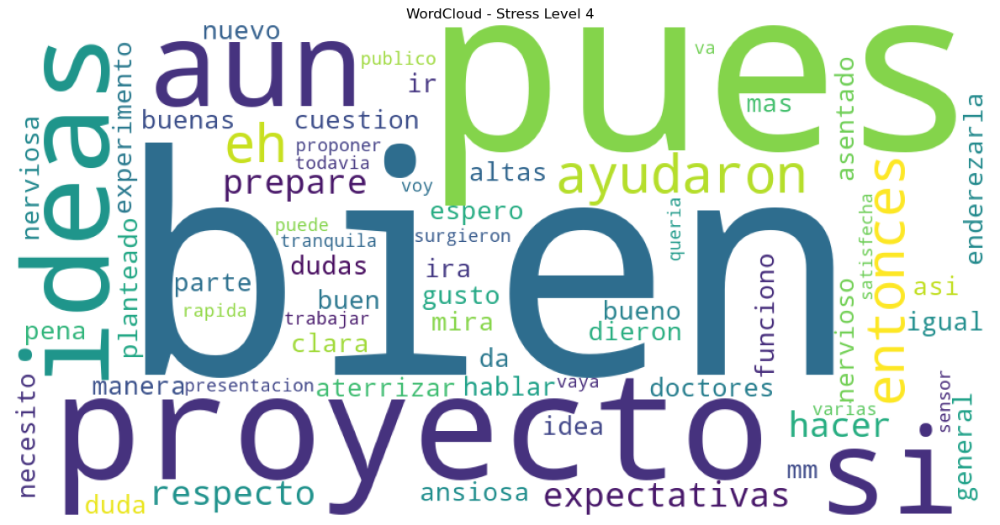

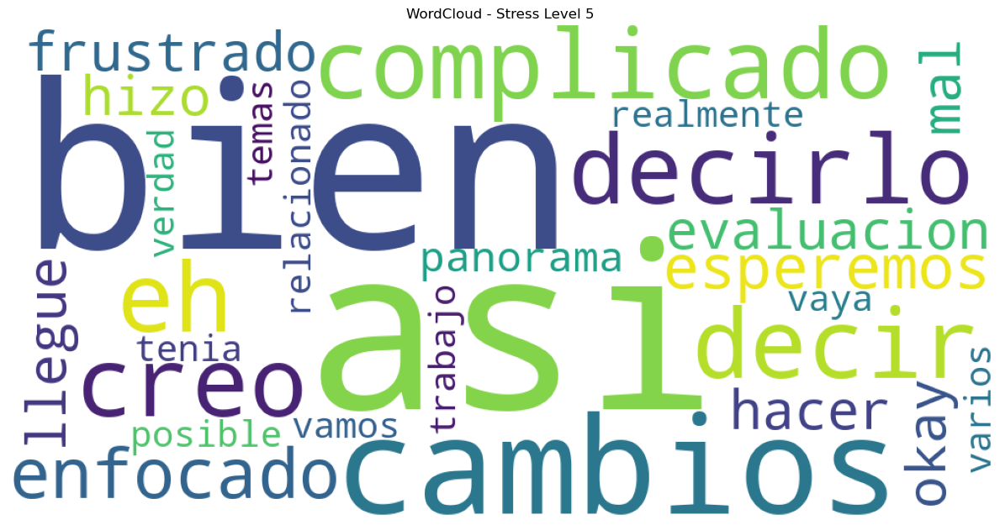

In [38]:
# Iterar sobre los 5 niveles de estrés
for stress_level in range(1, 6):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel igual a stress_level
    df_stress_level = df_bow_sw[df_bow_sw['StressLevel'] == stress_level]

    # Seleccionar los tokens
    tokens_cols = df_stress_level.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_stress_level[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Level {stress_level}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, f"wordcloud_unigrams_sw_stress_level_{stress_level}.png")
    plt.savefig(ruta_figura)
    plt.show()

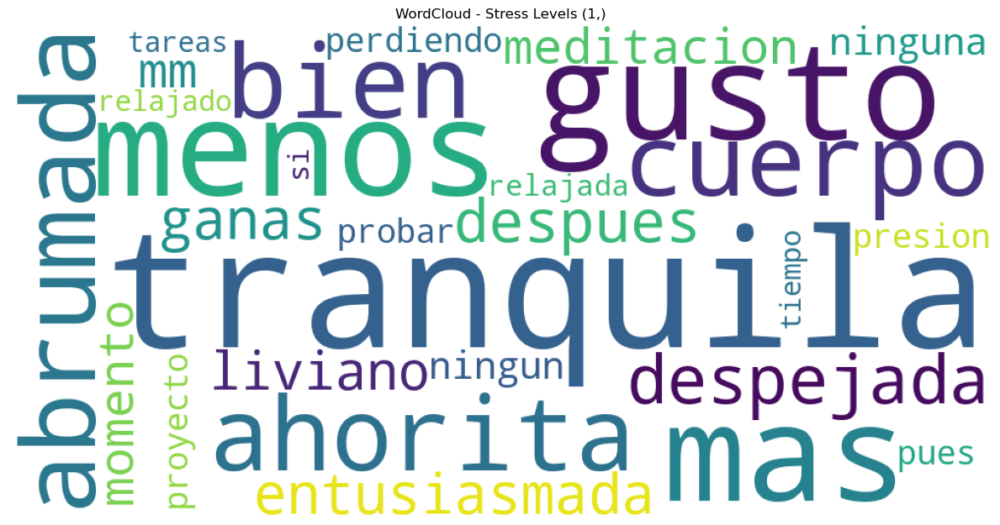

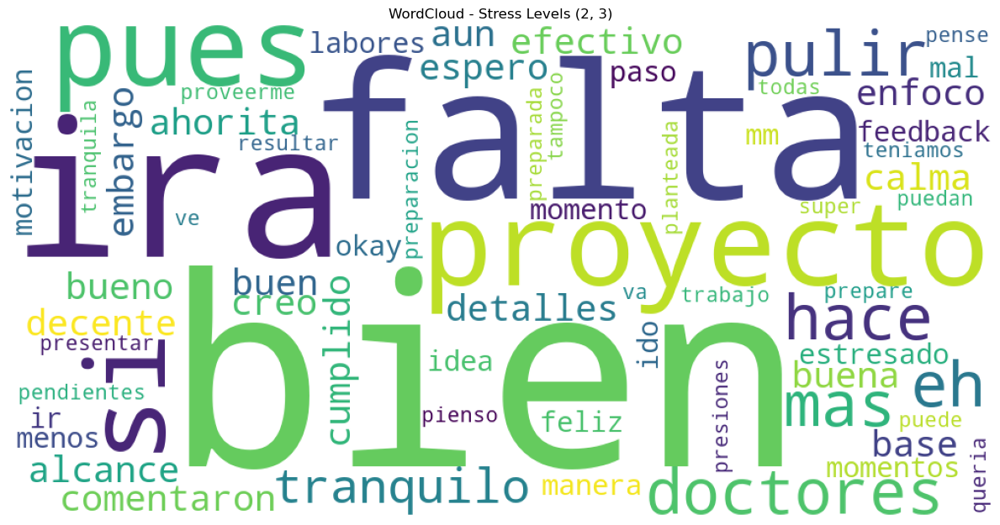

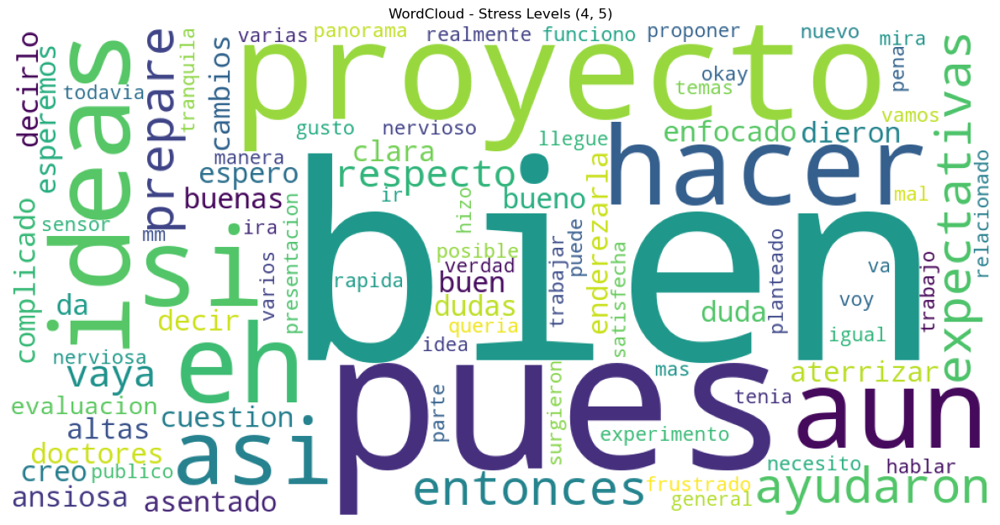

In [39]:
# Definir los grupos de niveles de estrés
grupos = [(1,), (2, 3), (4, 5)]
nombres_archivos = ['wordcloud_unigrams_sw_StressLevel_1.png', 'wordcloud_unigrams_sw_StressLevel_2-3.png', 'wordcloud_unigrams_sw_StressLevel_4-5.png']

# Iterar sobre los grupos de niveles de estrés
for idx, grupo in enumerate(grupos):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel en el grupo actual
    df_grupo = df_bow_sw[df_bow_sw['StressLevel'].isin(grupo)]

    # Seleccionar los tokens
    tokens_cols = df_grupo.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_grupo[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Levels {grupo}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, nombres_archivos[idx])
    plt.savefig(ruta_figura)
    plt.show()

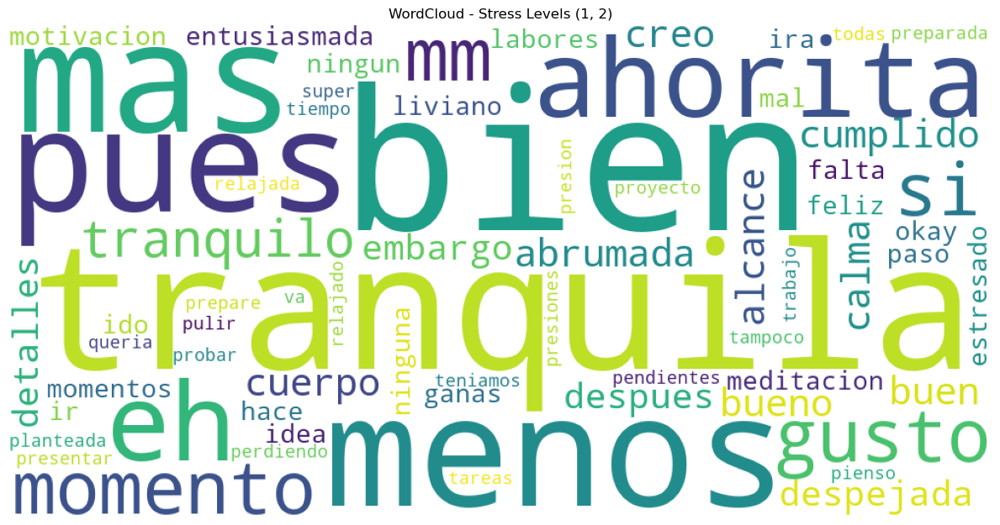

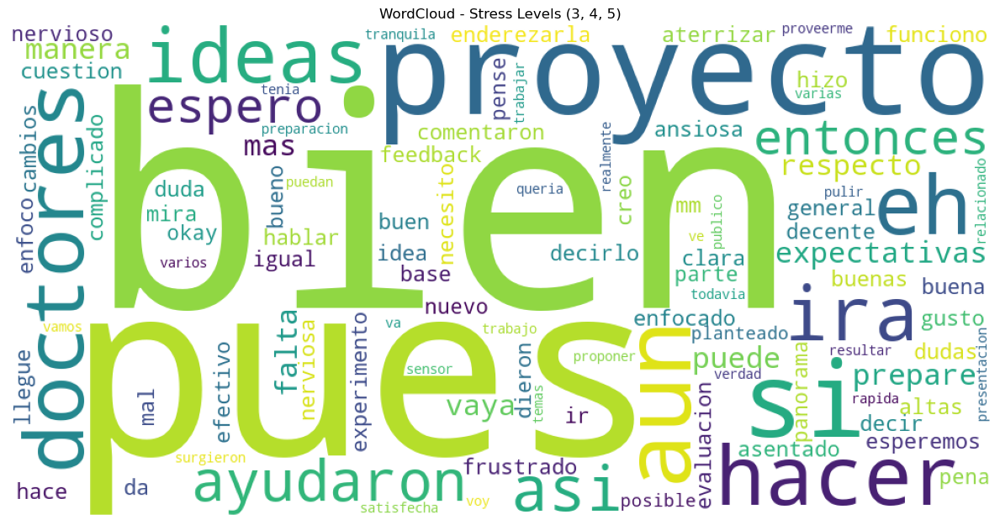

In [40]:
# Definir los grupos de niveles de estrés
grupos = [(1,2), (3, 4, 5)]
nombres_archivos = ['wordcloud_unigrams_sw_StressLevel_1-2.png', 'wordcloud_unigrams_sw_StressLevel_3-5.png']

# Iterar sobre los grupos de niveles de estrés
for idx, grupo in enumerate(grupos):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel en el grupo actual
    df_grupo = df_bow_sw[df_bow_sw['StressLevel'].isin(grupo)]

    # Seleccionar los tokens
    tokens_cols = df_grupo.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_grupo[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Levels {grupo}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, nombres_archivos[idx])
    plt.savefig(ruta_figura)
    plt.show()

#### <font color='purple'> **7.1.4 Obtención de bigramas puros** </font>

In [154]:
df_transcripts = pd.read_csv("df_transcripciones.csv")

# Filtrar las instancias correspondientes a 'DURANTE' en la columna 'Tiempo'
df_transcripts = df_transcripciones_merged[df_transcripciones_merged['Tiempo'] != 'DURANTE'].copy()

df_transcripts = df_transcripts[df_transcripts['contenido'] == 'Sentimiento']

# Verificar el nuevo DataFrame
display(df_transcripts.head())

,filename,Transcripcion,contenido,Tiempo,Participante,StressLevel
0,ANTES_ANDRES_5_34_Sentimiento.wav,pues me siento bien porque siento que prepare ...,Sentimiento,ANTES,ANDRES,4
3,ANTES_ARIANA_7_16_Sentimiento.wav,siento que me irá bien pero aún me falta prepa...,Sentimiento,ANTES,ARIANA,3
6,ANTES_DAFNE_6_12_Sentimiento.wav,Okay me siento preparada creo que prepare un b...,Sentimiento,ANTES,DAFNE,2
9,ANTES_JESUS_6_12_Sentimiento.wav,pues me siento un poco nervioso pero tengo bie...,Sentimiento,ANTES,JESUS,4
12,ANTES_JUAN_6_15_Sentimiento.wav,la verdad fue algo complicado porque no estoy ...,Sentimiento,ANTES,JUAN,5


Se eliminan las palabras relacionadas con `siento`, ya que se repetían como respuesta a la pregunta `¿Cómo te sientes en este momento?`

In [41]:
df_bigrams = procesar_texto_para_bigramas_puros(df_transcripts)
df_bigrams.drop(columns=['siento que', 'me siento'], inplace=True)

In [42]:
display(df_bigrams.head())

,abrumada porque,ahorita ya,al menos,alcance presentar,algo complicado,algo nuevo,altas siento,ansiosa porque,ante el,asentado ya,...,vaya muy,ve muy,verdad fue,voy hacer,ya despues,ya me,ya que,yo pense,yo pienso,StressLevel
0,0,0,0,0,0,1,0,0,0,1,...,0,0,0,1,0,0,1,0,0,4
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
4,0,0,0,0,1,0,0,0,0,0,...,1,0,1,0,0,0,0,0,0,5


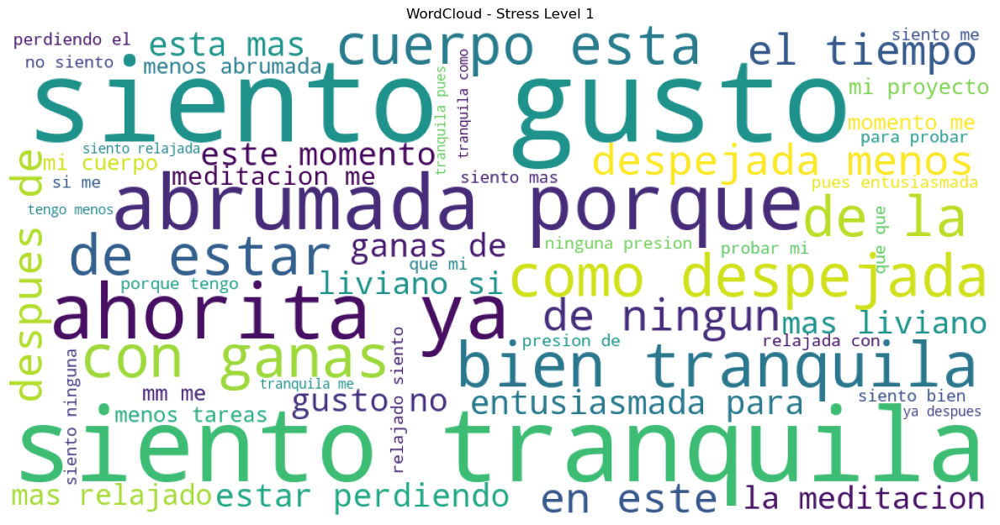

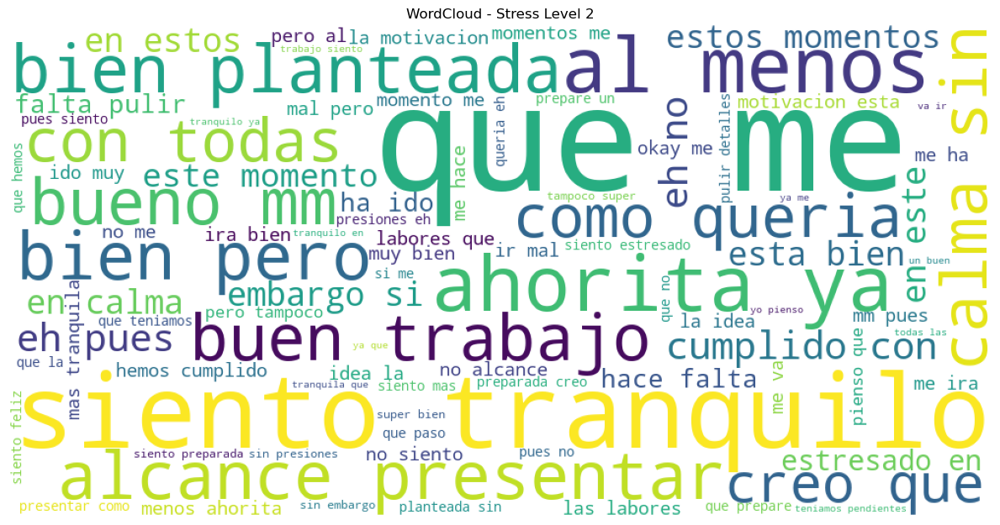

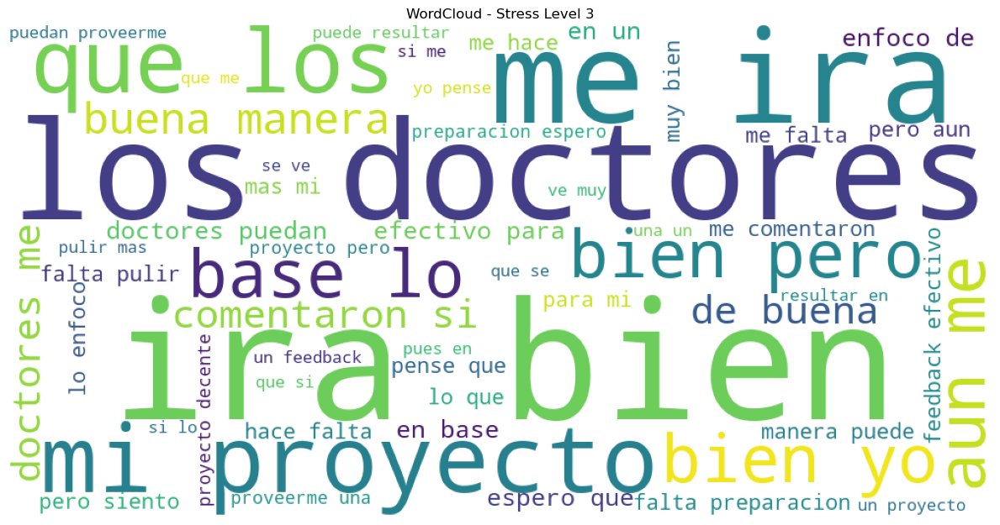

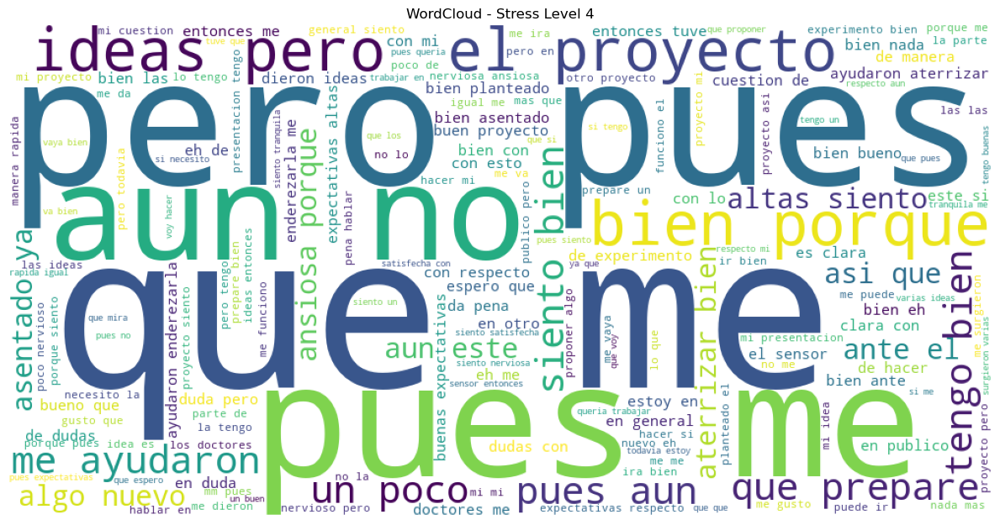

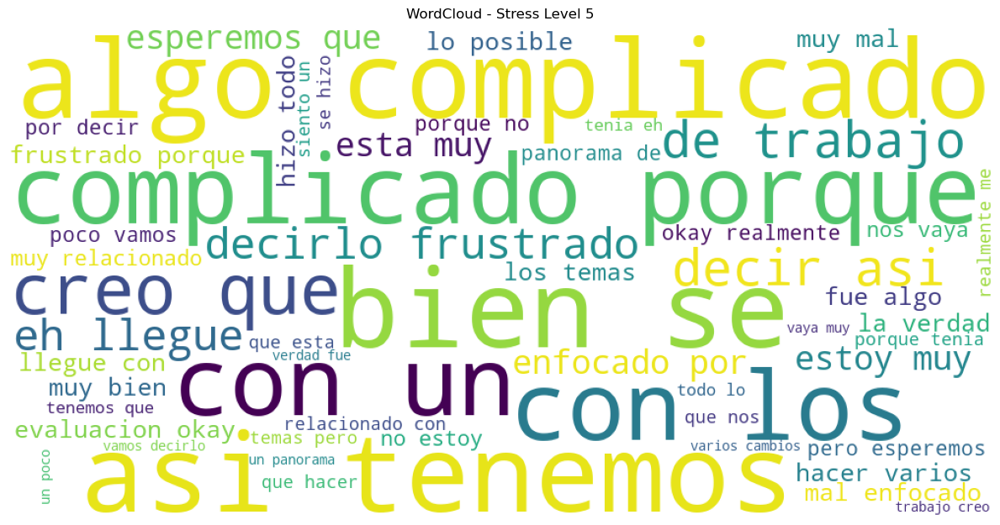

In [43]:
# Iterar sobre los 5 niveles de estrés
for stress_level in range(1, 6):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel igual a stress_level
    df_stress_level = df_bigrams[df_bigrams['StressLevel'] == stress_level]

    # Seleccionar los tokens
    tokens_cols = df_stress_level.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_stress_level[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Level {stress_level}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, f"wordcloud_bigrams_stress_level_{stress_level}.png")
    plt.savefig(ruta_figura)
    plt.show()

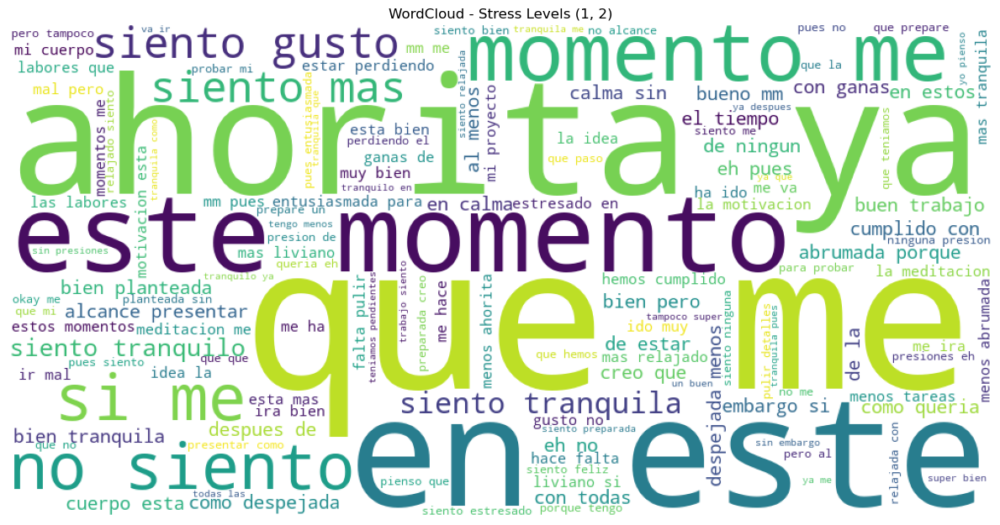

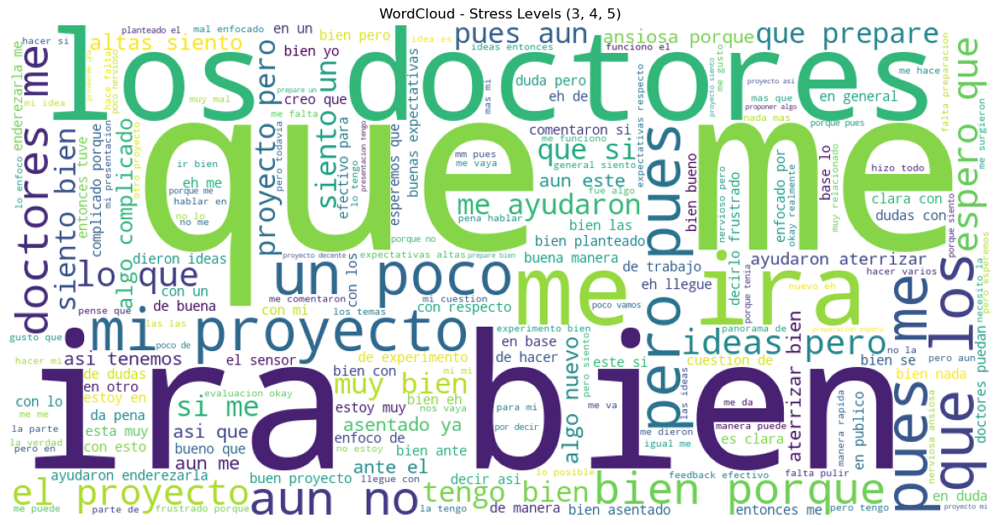

In [44]:
# Definir los grupos de niveles de estrés
grupos = [(1,2), (3, 4, 5)]
nombres_archivos = ['wordcloud_bigrams_StressLevel_1-2.png', 'wordcloud_bigrams_StressLevel_3-5.png']

# Iterar sobre los grupos de niveles de estrés
for idx, grupo in enumerate(grupos):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel en el grupo actual
    df_grupo = df_bigrams[df_bigrams['StressLevel'].isin(grupo)]

    # Seleccionar los tokens
    tokens_cols = df_grupo.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_grupo[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Levels {grupo}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, nombres_archivos[idx])
    plt.savefig(ruta_figura)
    plt.show()

#### <font color='purple'> **7.1.5 Obtención de bigramas sin stopwords** </font>

Se eliminan las palabras relacionadas con `siento`, ya que se repetían como respuesta a la pregunta `¿Cómo te sientes en este momento?`

In [45]:
df_bigrams_sw = procesar_texto_para_bigramas(df_transcripts)
df_bigrams_sw.drop(columns=['pues siento'], inplace=True)

In [46]:
display(df_bigrams_sw.head())

,abrumada menos,ahorita despues,ahorita siento,alcance presentar,altas siento,ansiosa da,asentado pues,asi espero,asi hacer,aterrizar bien,...,va bien,va ir,vamos decirlo,varias ideas,varios cambios,vaya bien,ve bien,verdad complicado,voy hacer,StressLevel
0,0,0,0,0,0,0,1,0,0,0,...,1,0,0,1,0,0,0,0,1,4
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,5


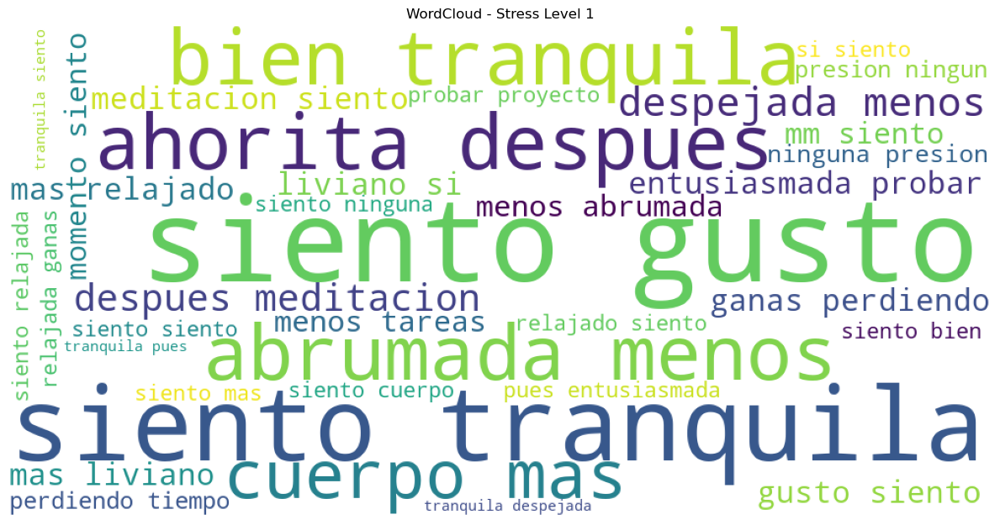

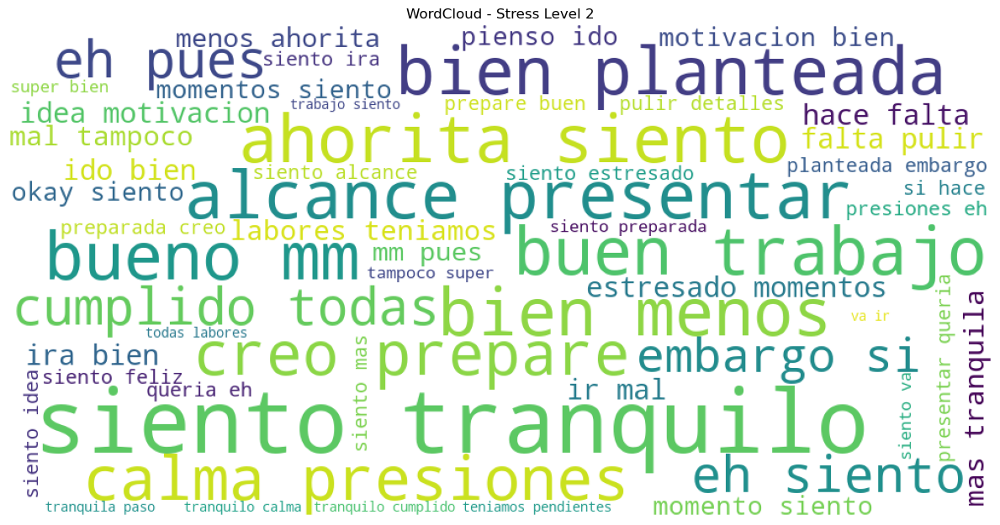

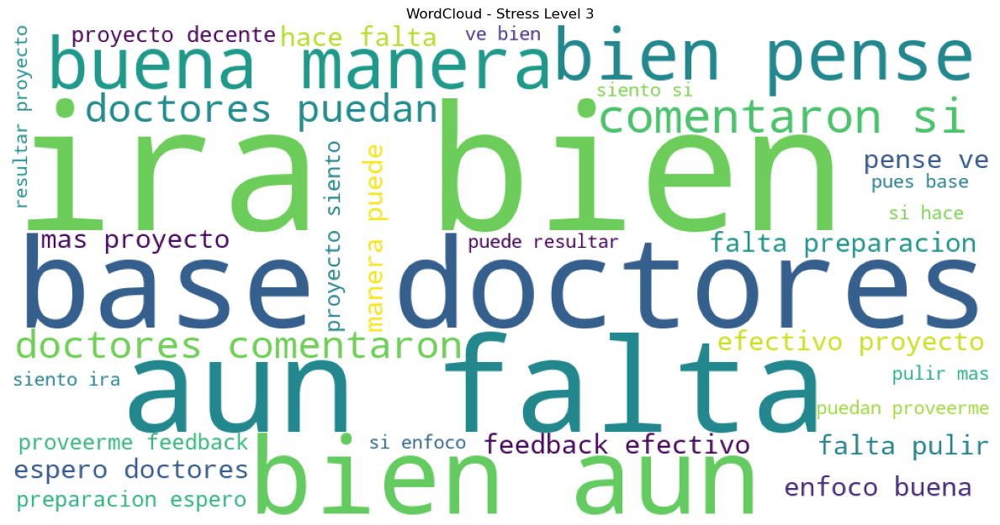

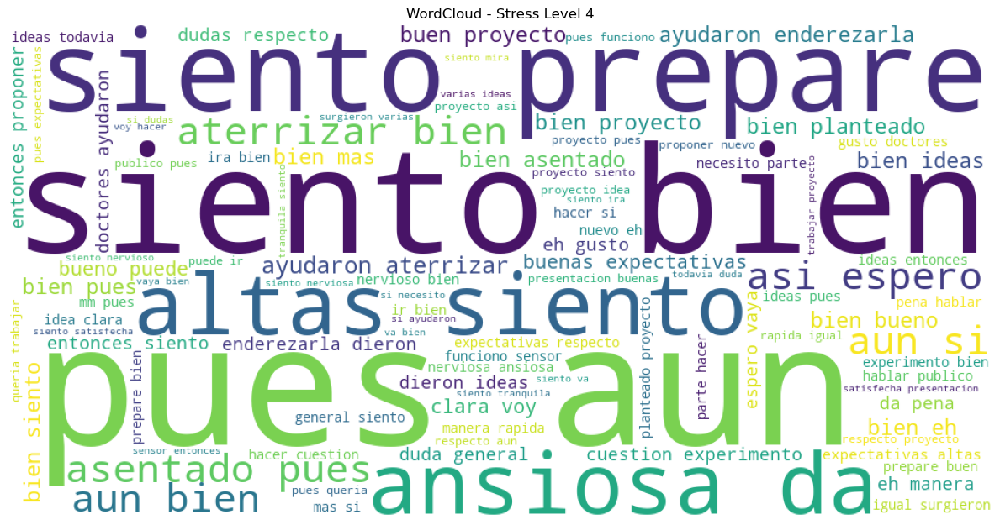

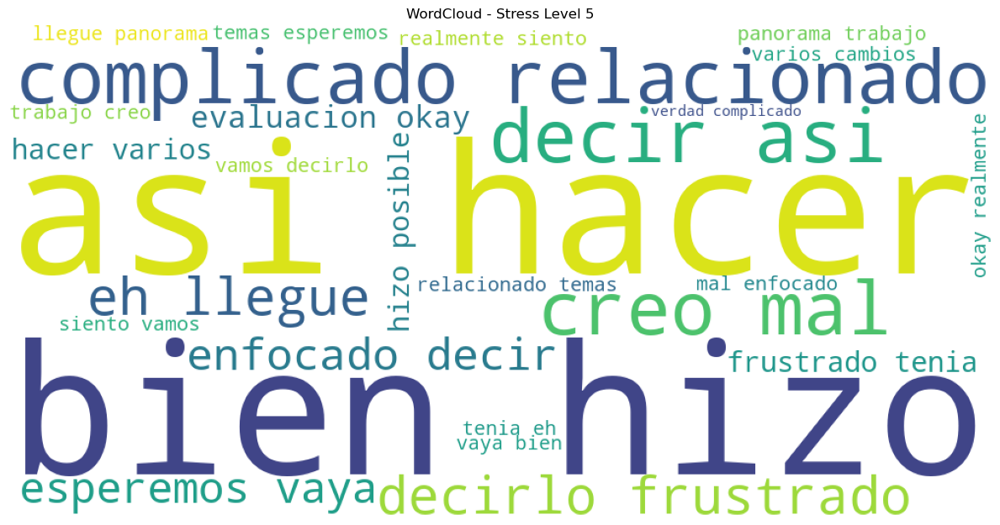

In [47]:
# Iterar sobre los 5 niveles de estrés
for stress_level in range(1, 6):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel igual a stress_level
    df_stress_level = df_bigrams_sw[df_bigrams_sw['StressLevel'] == stress_level]

    # Seleccionar los tokens
    tokens_cols = df_stress_level.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_stress_level[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Level {stress_level}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, f"wordcloud_bigrams_sw_stress_level_{stress_level}.png")
    plt.savefig(ruta_figura)
    plt.show()

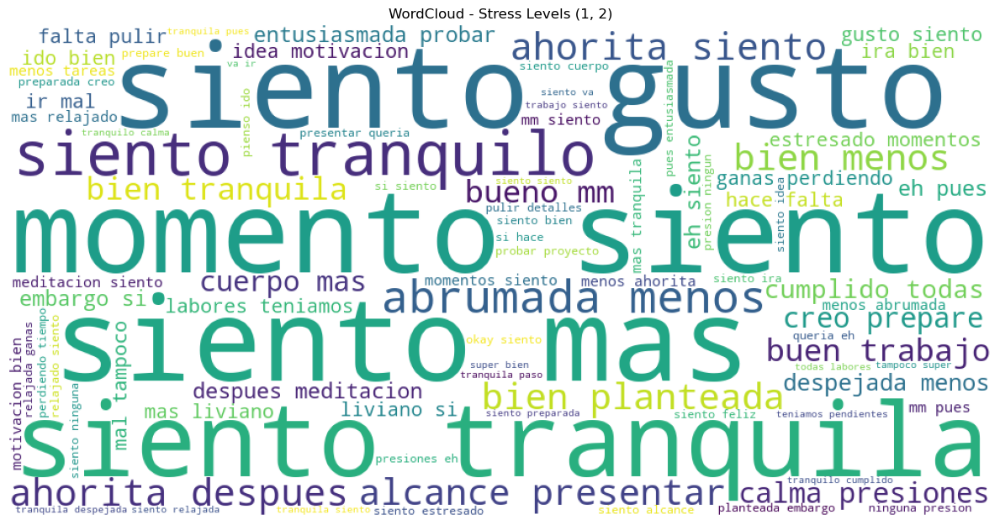

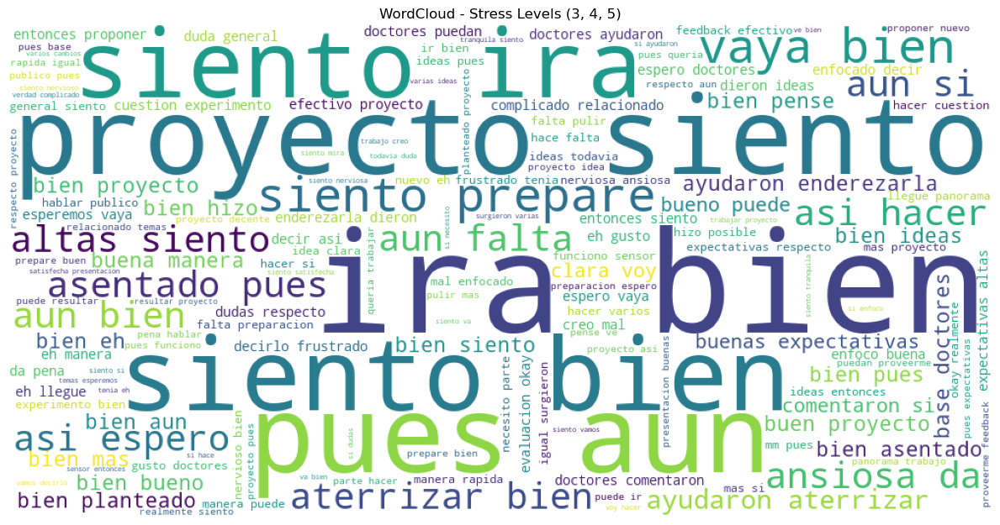

In [48]:
# Definir los grupos de niveles de estrés
grupos = [(1,2), (3, 4, 5)]
nombres_archivos = ['wordcloud_bigrams_sw_StressLevel_1-2.png', 'wordcloud_bigrams_sw_StressLevel_3-5.png']

# Iterar sobre los grupos de niveles de estrés
for idx, grupo in enumerate(grupos):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel en el grupo actual
    df_grupo = df_bigrams_sw[df_bigrams_sw['StressLevel'].isin(grupo)]

    # Seleccionar los tokens
    tokens_cols = df_grupo.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_grupo[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Levels {grupo}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, nombres_archivos[idx])
    plt.savefig(ruta_figura)
    plt.show()

#### <font color='purple'> **7.1.6 Obtención de trigramas puros** </font>

Se eliminan las palabras relacionadas con `siento`, ya que se repetían como respuesta a la pregunta `¿Cómo te sientes en este momento?`, y se elimina el trigrama `abrumada porque tengo`, ya que, al revisar las transcripciones, correspondía a la siguiente frase:

`mmm me siento tranquila como despejada menos abrumada porque tengo menos tareas y`

In [71]:
df_trigrams = procesar_texto_para_trigramas_puros(df_transcripts)
df_trigrams.drop(columns=['siento que me', 'pues me siento', 'este momento me', 'en este momento', 
                          'me siento un','me siento mas', 'momento me siento', 'siento un poco', 'abrumada porque tengo'], inplace=True)

In [72]:
display(df_trigrams.head()) 

,ahorita ya despues,ahorita ya me,al menos ahorita,alcance presentar como,algo complicado porque,algo nuevo eh,altas siento que,ansiosa porque me,ante el proyecto,asentado ya que,...,ve muy bien,verdad fue algo,voy hacer si,ya despues de,ya me siento,ya que hemos,ya que pues,yo pense que,yo pienso que,StressLevel
0,0,0,0,0,0,1,0,0,0,1,...,0,0,1,0,0,0,1,0,0,4
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
4,0,0,0,0,1,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,5


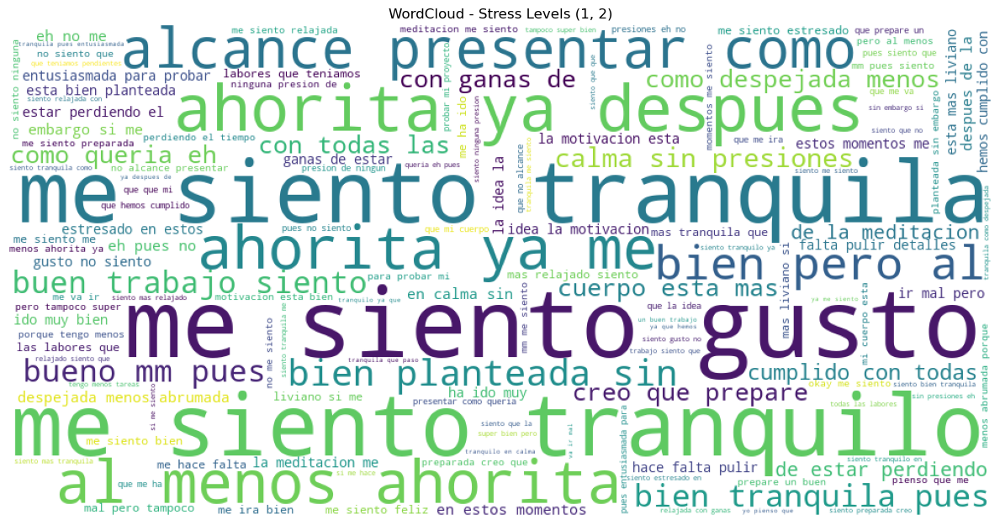

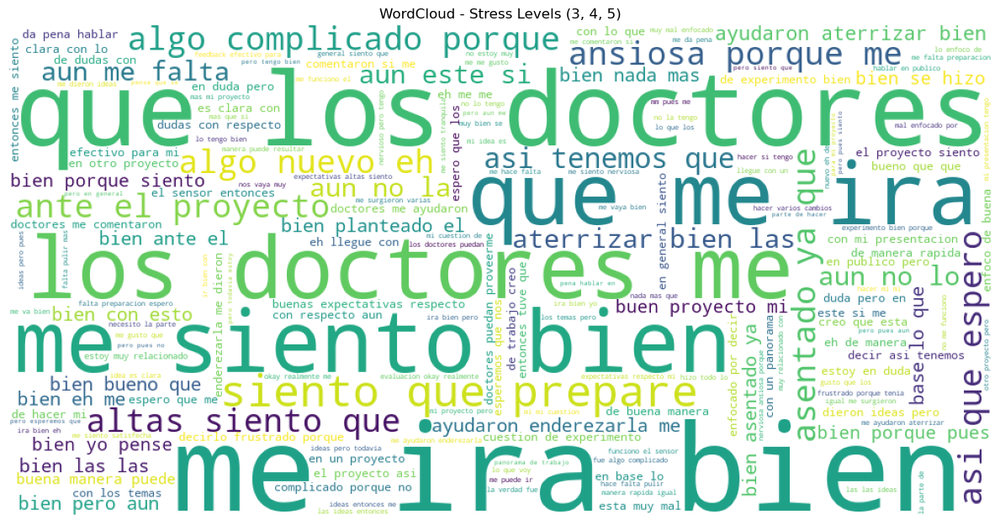

In [73]:
# Definir los grupos de niveles de estrés
grupos = [(1,2), (3,4, 5)]
nombres_archivos = ['wordcloud_trigrams_StressLevel_1-2.png', 'wordcloud_trigrams_StressLevel_3-5.png']

# Iterar sobre los grupos de niveles de estrés
for idx, grupo in enumerate(grupos):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel en el grupo actual
    df_grupo = df_trigrams[df_trigrams['StressLevel'].isin(grupo)]

    # Seleccionar los tokens
    tokens_cols = df_grupo.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_grupo[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Levels {grupo}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, nombres_archivos[idx])
    plt.savefig(ruta_figura)
    plt.show()

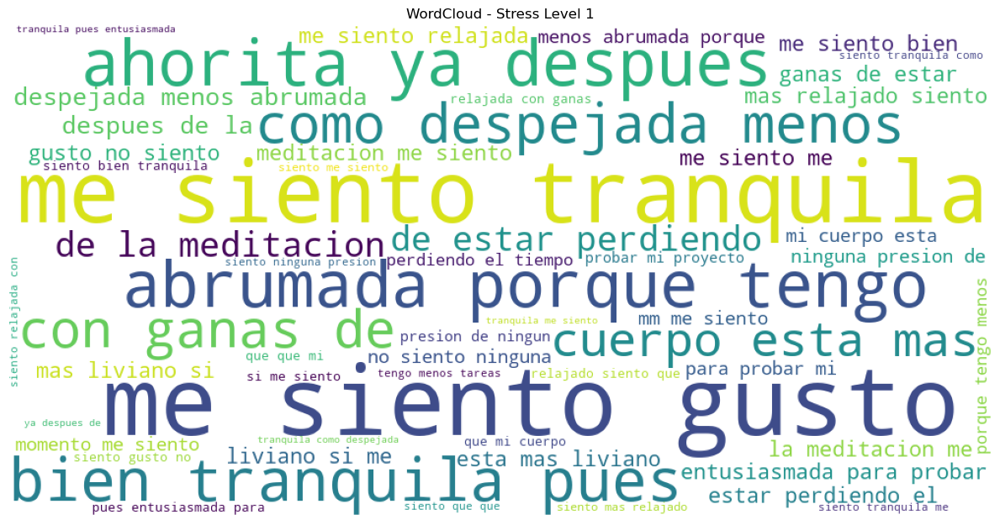

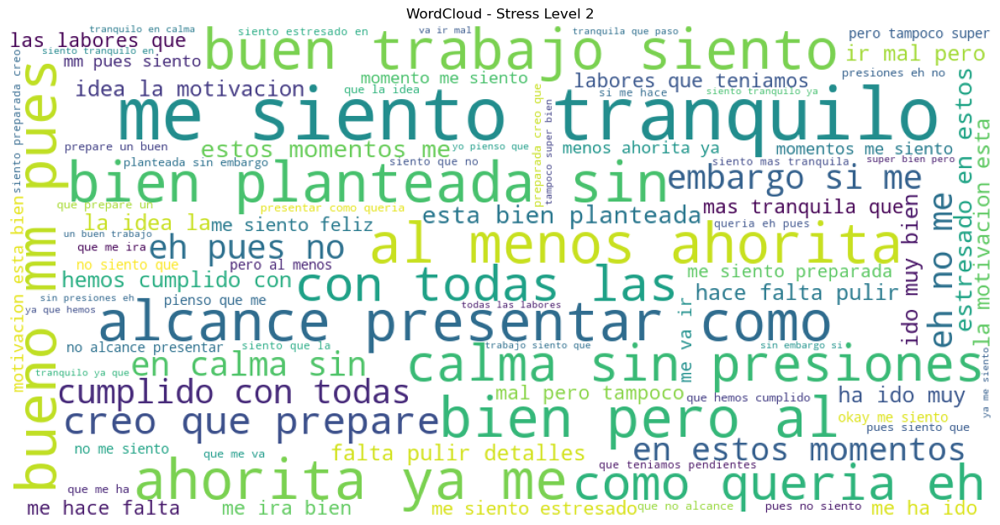

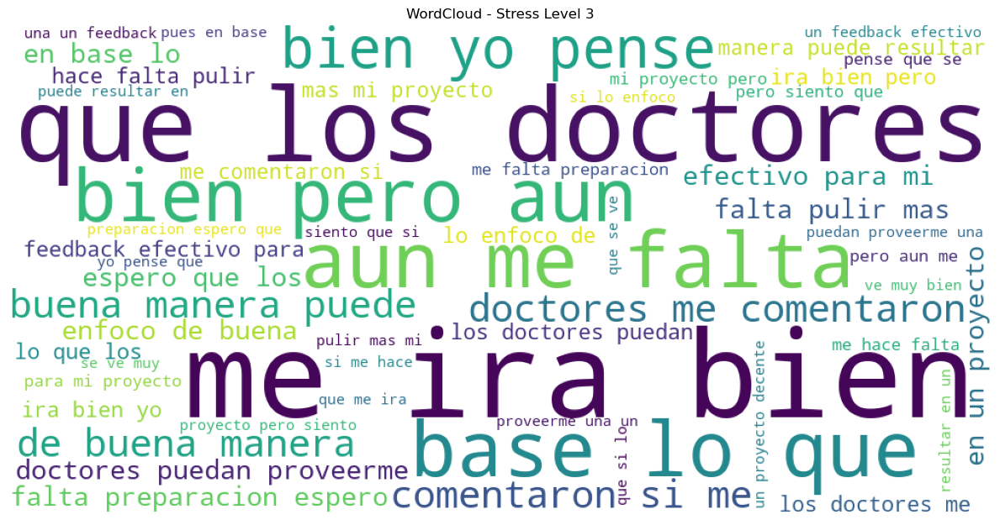

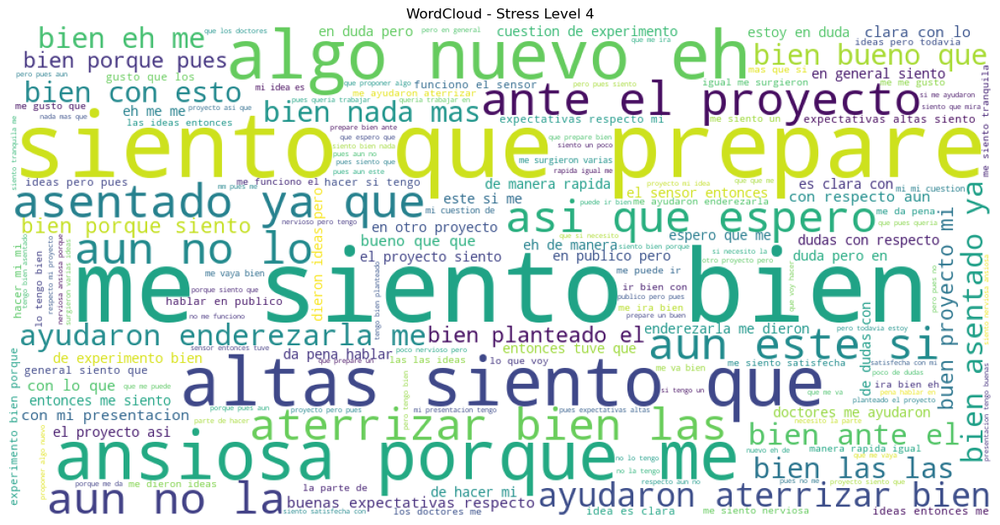

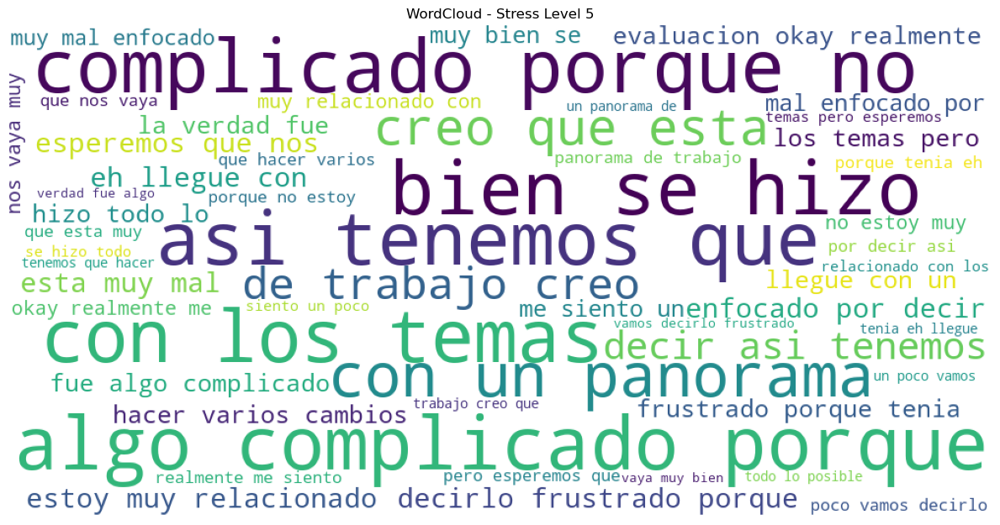

In [57]:
# Iterar sobre los 5 niveles de estrés
for stress_level in range(1, 6):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel igual a stress_level
    df_stress_level = df_trigrams[df_trigrams['StressLevel'] == stress_level]

    # Seleccionar los tokens
    tokens_cols = df_stress_level.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_stress_level[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Level {stress_level}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, f"wordcloud_trigrams_stress_level_{stress_level}.png")
    plt.savefig(ruta_figura)
    plt.show()

#### <font color='purple'> **7.1.7 Obtención de trigramas sin stopwords** </font>

In [191]:
df_trigrams_bw = procesar_texto_para_trigramas(df_transcripts)

In [192]:
display(df_trigrams_bw.head())

,abrumada menos tareas,ahorita despues meditacion,ahorita siento mas,alcance presentar queria,altas siento ira,ansiosa da pena,asentado pues queria,asi espero vaya,asi hacer varios,aterrizar bien ideas,...,tranquilo calma presiones,tranquilo cumplido todas,va bien bueno,va ir mal,vamos decirlo frustrado,varias ideas todavia,vaya bien hizo,verdad complicado relacionado,voy hacer si,StressLevel
0,0,0,0,0,0,0,1,0,0,0,...,0,0,1,0,0,1,0,0,1,4
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,1,0,5


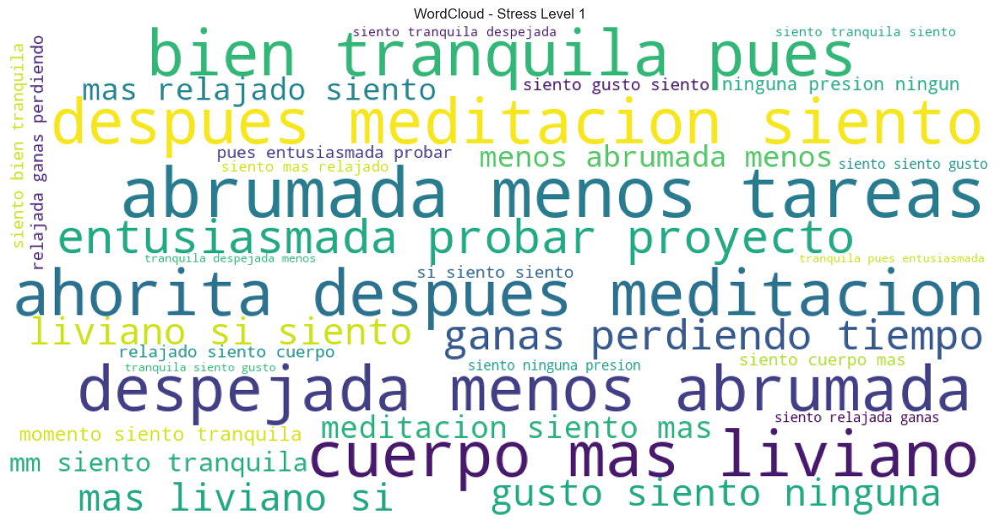

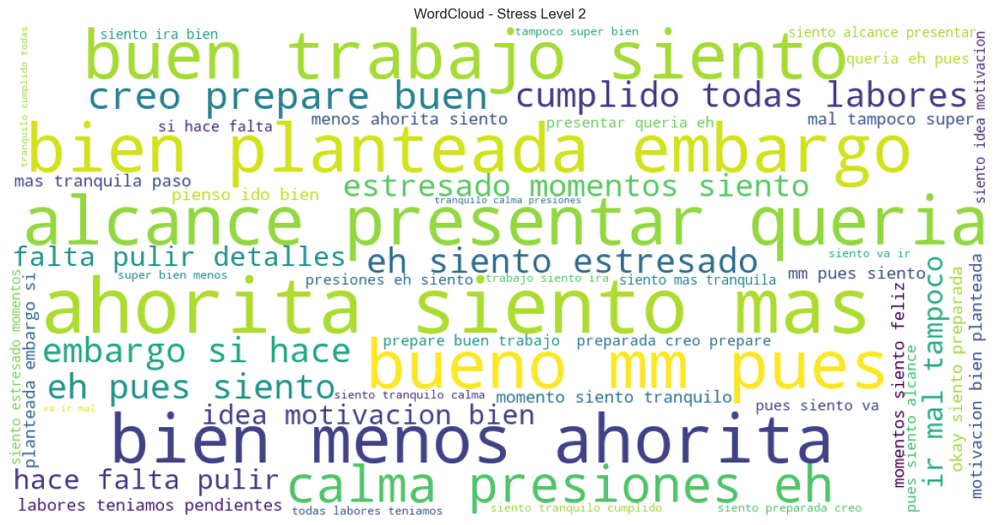

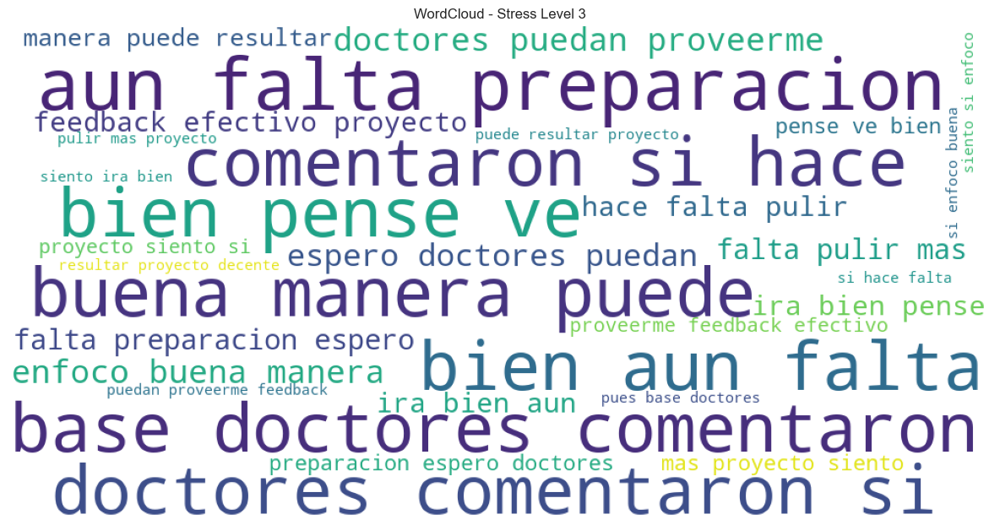

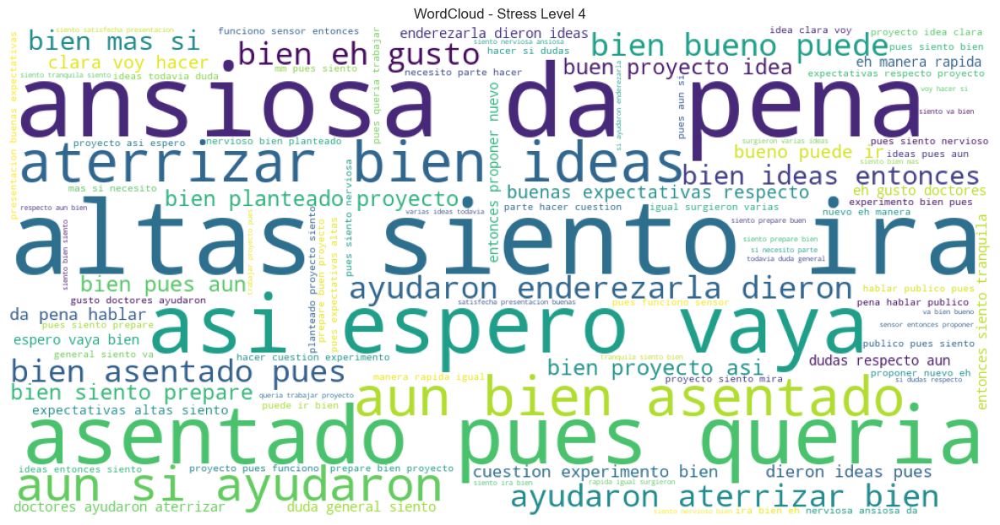

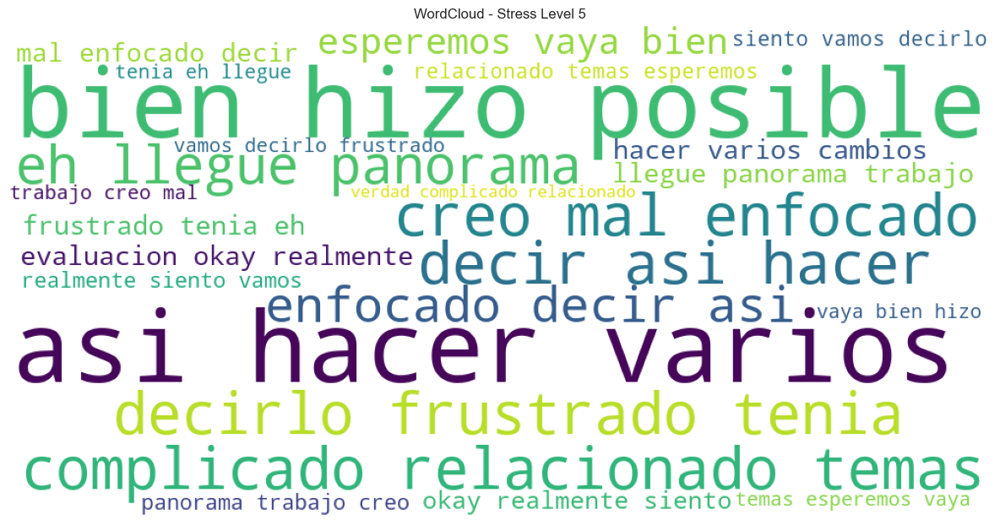

In [193]:
# Iterar sobre los 5 niveles de estrés
for stress_level in range(1, 6):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel igual a stress_level
    df_stress_level = df_trigrams_bw[df_trigrams_bw['StressLevel'] == stress_level]

    # Seleccionar los tokens
    tokens_cols = df_stress_level.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_stress_level[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Level {stress_level}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, f"wordcloud_trigrams_bw_stress_level_{stress_level}.png")
    plt.savefig(ruta_figura)
    plt.show()

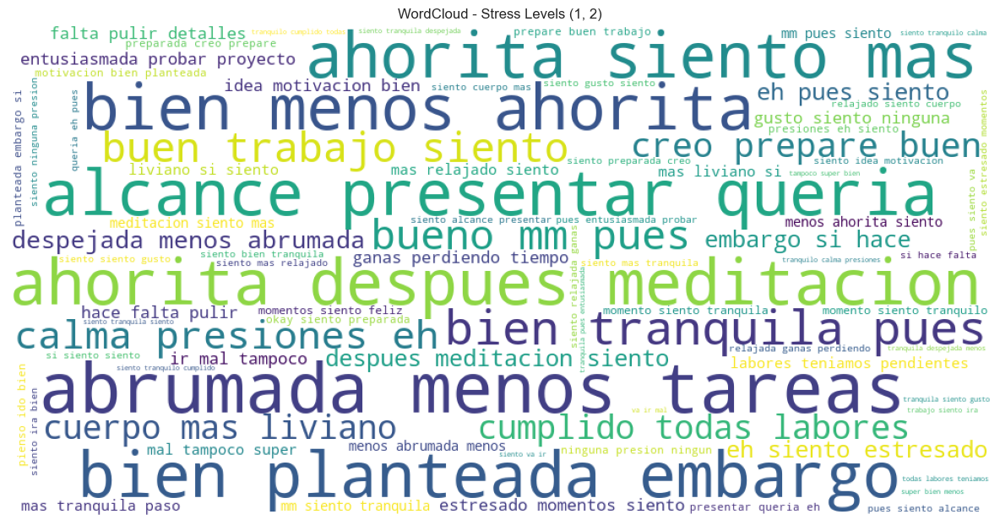

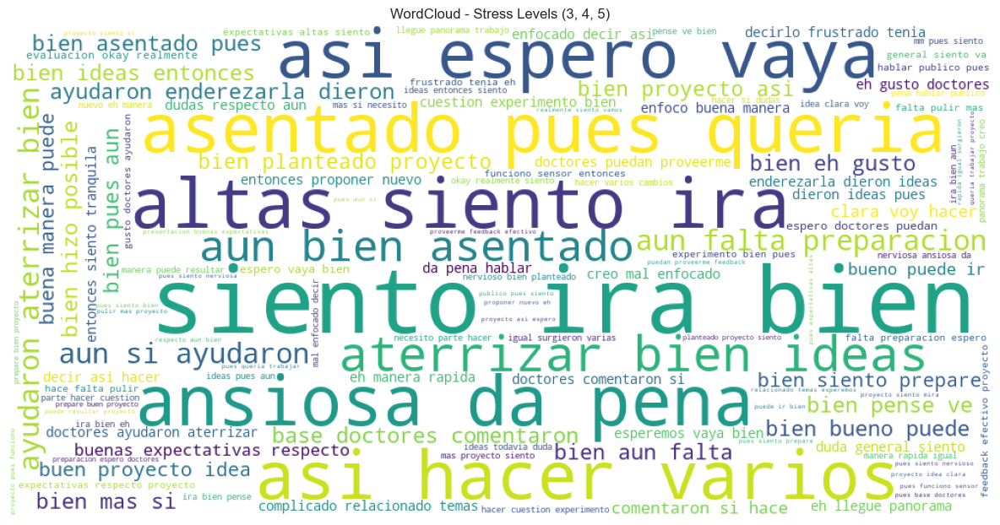

In [194]:
# Definir los grupos de niveles de estrés
grupos = [(1,2), (3, 4, 5)]
nombres_archivos = ['wordcloud_trigrams_bw_StressLevel_1-2.png', 'wordcloud_trigrams_bw_StressLevel_3-5.png']

# Iterar sobre los grupos de niveles de estrés
for idx, grupo in enumerate(grupos):
    # Filtrar el DataFrame para incluir solo las filas con StressLevel en el grupo actual
    df_grupo = df_trigrams_bw[df_trigrams_bw['StressLevel'].isin(grupo)]

    # Seleccionar los tokens
    tokens_cols = df_grupo.columns[:-1]  # Excluir la última columna 'StressLevel'

    # Crear un diccionario a partir de las columnas de unigramas
    word_cloud_data = dict(zip(tokens_cols, df_grupo[tokens_cols].sum()))

    # Crear el WordCloud a partir del diccionario
    wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

    # Mostrar el WordCloud de unigramas
    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'WordCloud - Stress Levels {grupo}')
    plt.tight_layout()
    # Guardar la figura en la carpeta
    ruta_figura = os.path.join(carpeta_figuras, nombres_archivos[idx])
    plt.savefig(ruta_figura)
    plt.show()

### <font color='purple'> **7.2 Obtención de Wordclouds Durante la exposición** </font>

Se analizan los stopwords para detectar la presencia de muletillas, lo cual puede ser un indicador de estrés o nerviosismo.

In [197]:
df_transcripciones_merged = pd.read_csv("df_transcripciones_merged.csv")

# Filtrar las instancias correspondientes a 'DURANTE' en la columna 'Tiempo'
df_transcripts_durante = df_transcripciones_merged[df_transcripciones_merged['Tiempo'] == 'DURANTE'].copy()

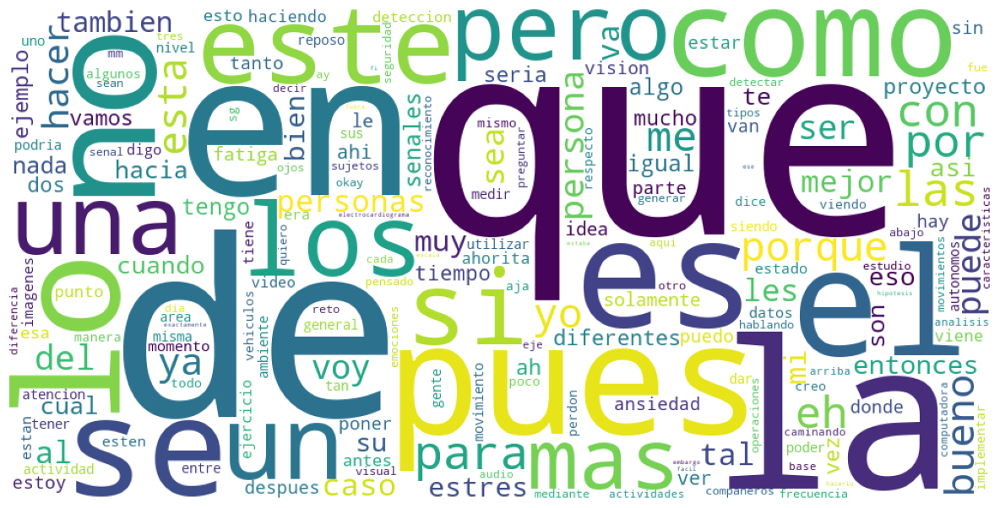

In [206]:
df_unigrams_durante = procesar_texto_para_unigramas_puros(df_transcripts_durante)

# Seleccionamos los tokens
tokens_cols = df_unigrams_durante.columns[:-1]  # Excluir la última columna 'StressLevel'

# Creamos un diccionario a partir de las columnas de unigramas
word_cloud_data = dict(zip(tokens_cols, df_unigrams_durante[tokens_cols].sum()))

# Creamos el WordCloud a partir del diccionario
wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

# Mostrar el WordCloud de unigramas
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud)
plt.axis('off')
# Guardar la figura en la carpeta
plt.tight_layout()
#ruta_figura = os.path.join(carpeta_figuras, "wordcloud_unigrams(all_levels).png")
#plt.savefig(ruta_figura)
plt.show()

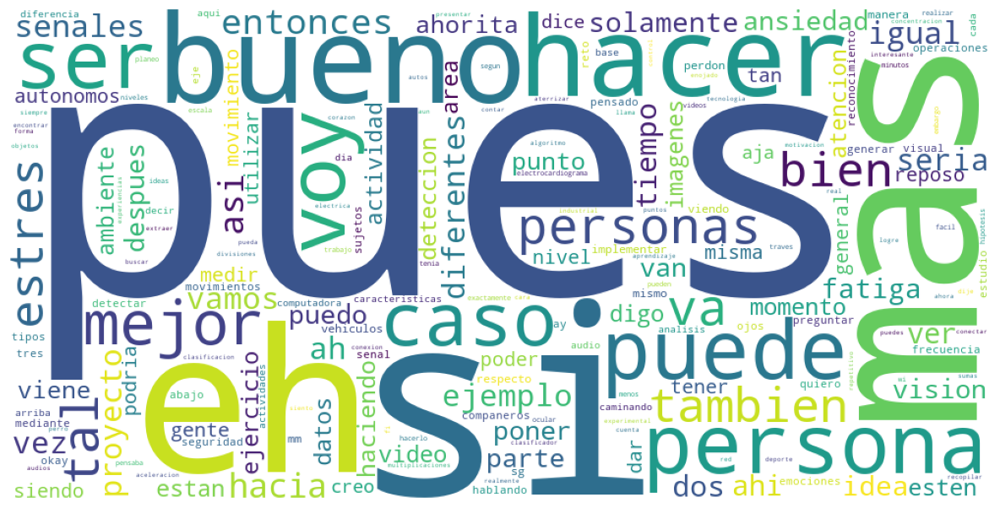

In [207]:
df_unigrams_durante_sw = procesar_texto_para_unigramas(df_transcripts_durante)

# Seleccionamos los tokens
tokens_cols = df_unigrams_durante_sw.columns[:-1]  # Excluir la última columna 'StressLevel'

# Creamos un diccionario a partir de las columnas de unigramas
word_cloud_data = dict(zip(tokens_cols, df_unigrams_durante_sw[tokens_cols].sum()))

# Creamos el WordCloud a partir del diccionario
wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

# Mostrar el WordCloud de unigramas
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud)
plt.axis('off')
# Guardar la figura en la carpeta
plt.tight_layout()
#ruta_figura = os.path.join(carpeta_figuras, "wordcloud_unigrams(all_levels).png")
#plt.savefig(ruta_figura)
plt.show()

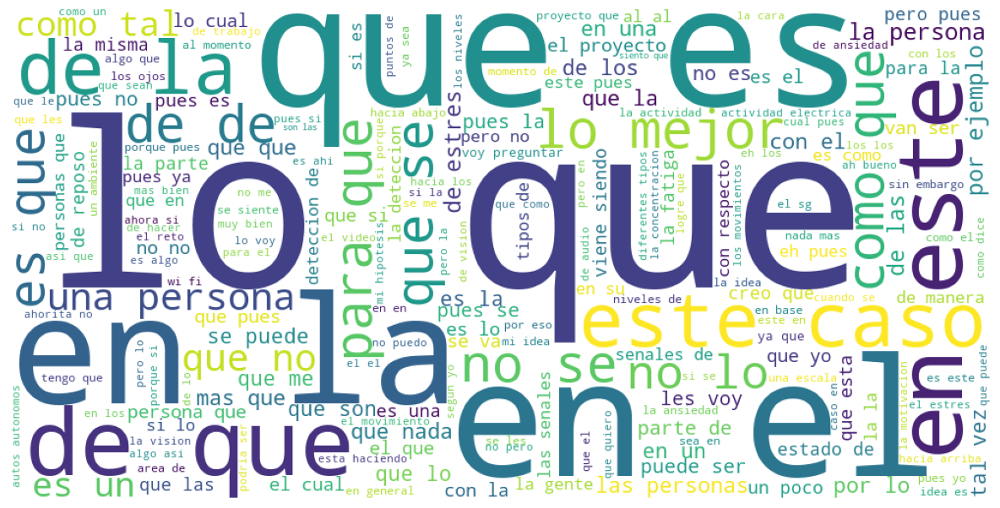

In [202]:
df_bigrams_durante = procesar_texto_para_bigramas_puros(df_transcripts_durante)

# Seleccionamos los tokens
tokens_cols = df_bigrams_durante.columns[:-1]  # Excluir la última columna 'StressLevel'

# Creamos un diccionario a partir de las columnas de unigramas
word_cloud_data = dict(zip(tokens_cols, df_bigrams_durante[tokens_cols].sum()))

# Creamos el WordCloud a partir del diccionario
wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

# Mostrar el WordCloud de unigramas
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud)
plt.axis('off')
# Guardar la figura en la carpeta
plt.tight_layout()
#ruta_figura = os.path.join(carpeta_figuras, "wordcloud_unigrams(all_levels).png")
#plt.savefig(ruta_figura)
plt.show()

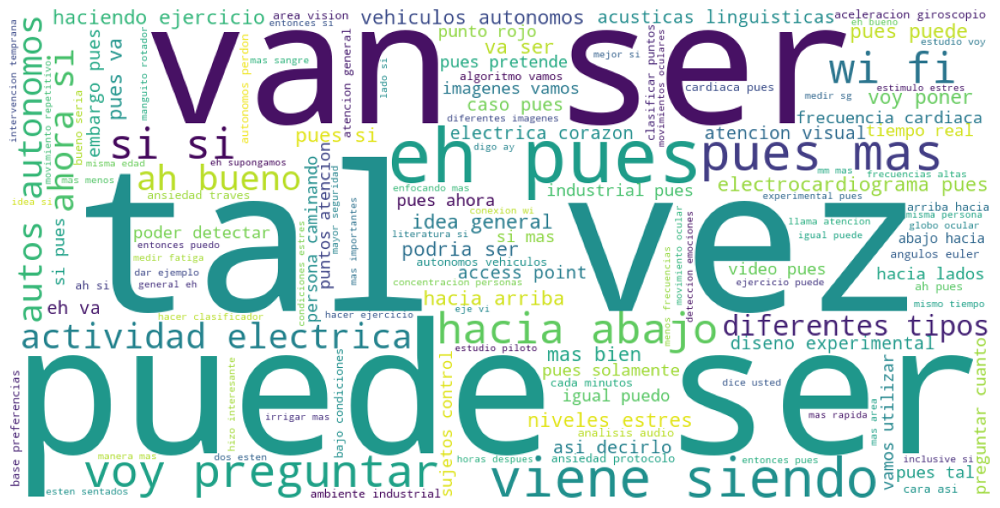

In [203]:
df_bigrams_durante_sw = procesar_texto_para_bigramas(df_transcripts_durante)

# Seleccionamos los tokens
tokens_cols = df_bigrams_durante_sw.columns[:-1]  # Excluir la última columna 'StressLevel'

# Creamos un diccionario a partir de las columnas de unigramas
word_cloud_data = dict(zip(tokens_cols, df_bigrams_durante_sw[tokens_cols].sum()))

# Creamos el WordCloud a partir del diccionario
wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

# Mostrar el WordCloud de unigramas
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud)
plt.axis('off')
# Guardar la figura en la carpeta
plt.tight_layout()
#ruta_figura = os.path.join(carpeta_figuras, "wordcloud_unigrams(all_levels).png")
#plt.savefig(ruta_figura)
plt.show()

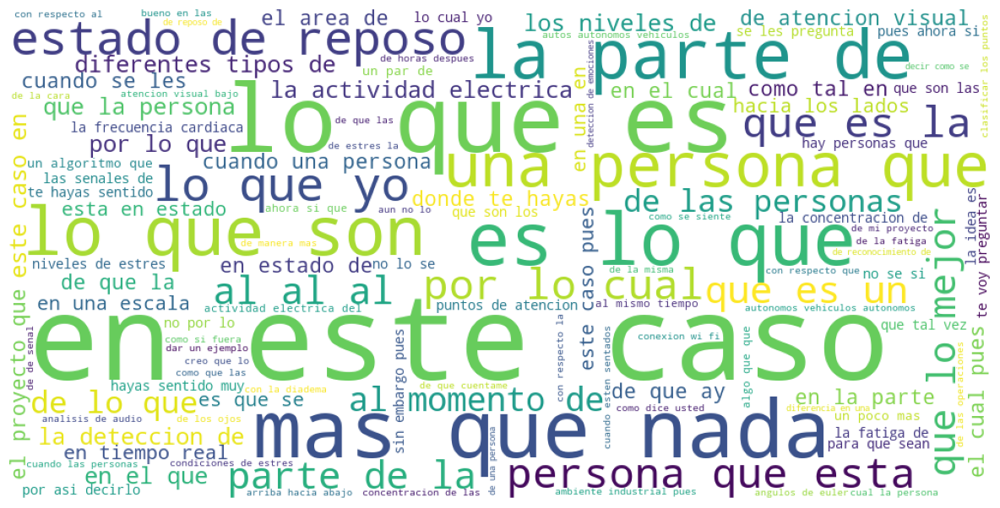

In [204]:
df_trigrams_durante = procesar_texto_para_trigramas_puros(df_transcripts_durante)

# Seleccionamos los tokens
tokens_cols = df_trigrams_durante.columns[:-1]  # Excluir la última columna 'StressLevel'

# Creamos un diccionario a partir de las columnas de unigramas
word_cloud_data = dict(zip(tokens_cols, df_trigrams_durante[tokens_cols].sum()))

# Creamos el WordCloud a partir del diccionario
wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

# Mostrar el WordCloud de unigramas
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud)
plt.axis('off')
# Guardar la figura en la carpeta
plt.tight_layout()
#ruta_figura = os.path.join(carpeta_figuras, "wordcloud_unigrams(all_levels).png")
#plt.savefig(ruta_figura)
plt.show()

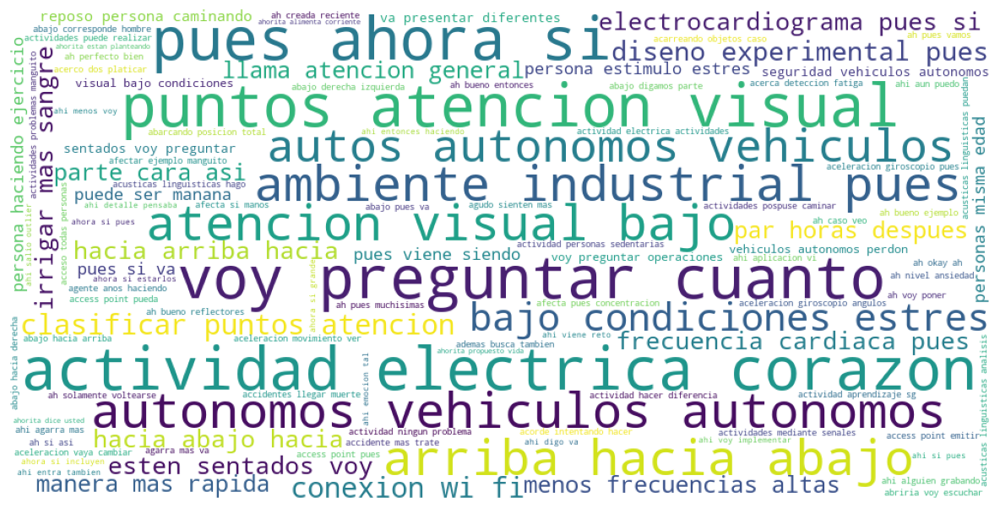

In [205]:
df_trigrams_durante_sw = procesar_texto_para_trigramas(df_transcripts_durante)

# Seleccionamos los tokens
tokens_cols = df_trigrams_durante_sw.columns[:-1]  # Excluir la última columna 'StressLevel'

# Creamos un diccionario a partir de las columnas de unigramas
word_cloud_data = dict(zip(tokens_cols, df_trigrams_durante_sw[tokens_cols].sum()))

# Creamos el WordCloud a partir del diccionario
wordcloud = WordCloud(width=1000, height=500, background_color='white', min_font_size=6).generate_from_frequencies(word_cloud_data)

# Mostrar el WordCloud de unigramas
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud)
plt.axis('off')
# Guardar la figura en la carpeta
plt.tight_layout()
#ruta_figura = os.path.join(carpeta_figuras, "wordcloud_unigrams(all_levels).png")
#plt.savefig(ruta_figura)
plt.show()

## <font color='purple'> **8.- Conclusiones** </font>

Este estudio tuvo como objetivo detectar el estrés a través de señales de audio y realizar un análisis del discurso. Se llevó a cabo una intervención para inducir esta reacción, respaldada por el Trier Social Stress Test, en la cual los participantes presentaron sus anteproyectos ante los dos docentes del curso. Se recolectaron muestras de audio, de las cuales se extrajeron características y se probaron cuatro diferentes algoritmos de inferencia para crear un clasificador de estrés.

Se encontró que la detección de estrés a través de señales de audio es factible, ya que fue posible crear clasificadores de estrés utilizando características de estas señales, obtieniendo un F1 score del 0.88 con el clasificador binario y balanceado. Se observó que la frecuencia dominante desempeña un papel importante en estos clasificadores y muestra similitudes con el autoreporte de niveles de estrés en la escala Likert utilizada por los participantes. Esto sugiere la posibilidad de explorar en futuras investigaciones si la frecuencia dominante podría ser una alternativa válida al autoreporte en la evaluación del estrés.

Por otro lado, se observó que la experimentación de estrés no afectó significativamente el desempeño de los participantes durante la exposición. Este hallazgo plantea la necesidad de investigaciones adicionales para comprender los mecanismos subyacentes que explican por qué el estrés no impacta el rendimiento en ciertos contextos, lo que podría conducir al desarrollo de técnicas efectivas para el manejo del estrés.

Aunque este estudio proporcionó hallazgos significativos en un entorno naturalista, es importante replicarlo con un mayor número de participantes para mejorar los análisis estadísticos y capturar más datos para los clasificadores. Además, sería beneficioso extender el análisis a otros grupos de edad, contextos y culturas, lo que permitiría una comprensión más completa y generalizable de la relación entre el estrés y las señales de audio.
